In [111]:
%pylab inline

Populating the interactive namespace from numpy and matplotlib
/Users/itotatsuhiko/.pyenv/versions/3.8.0/lib/python3.8/site-packages/IPython/core/magics/pylab.py:159: UserWarning: pylab import has clobbered these variables: ['title']
`%matplotlib` prevents importing * from pylab and numpy
  warn("pylab import has clobbered these variables: %s"  % clobbered +


In [112]:
import os
from os.path import join
import numpy as np
import pandas as pd
from matplotlib import gridspec

In [113]:
%run notebooktools.py

In [114]:
bpth = join(os.path.expanduser('~'),'Dropbox','Data')
qpath = join(os.path.expanduser('~'), 'Dropbox', 'Data', 'Qms')

In [115]:
lst = sorted([i for i in os.listdir(bpth) if '.csv' in i and '0124' in i])
lsq = [i for i in sorted(os.listdir(qpath)) if i.endswith('csv')]
lst, lsq

(['out_20200124_121749.csv',
  'out_20200124_121749_temp.csv',
  'out_20200124_121815.csv',
  'out_20200124_121815_temp.csv',
  'out_20200124_180121.csv',
  'out_20200124_180121_temp.csv'],
 ['S1_191227_2017242.csv',
  'S1_200110_212512_fix.csv',
  'S1_200124_175826_fix.csv'])

In [116]:
font_setup(size=15)

In [117]:
""" calculate time """
def calc_time(time: str):
    hour, minute, second = time.split(':')
    tmp = int(hour)*60*60 + int(minute)*60 + float(second)
    return tmp

In [118]:
data_t = pd.read_csv(join(bpth,lst[5]),)
data = pd.read_csv(join(bpth,lst[4]),)
data_q = pd.read_csv(join(qpath, lsq[2]), header=36, encoding='utf-8')

''' qms data format'''
data_q = data_q.rename(columns={'経過時間': 'time', 'ｱﾅﾛｸﾞ1': 'analog_1', '1': '2', '2': '3', '3': '4', '4': '14', '5': '15', '6': '16', '7': '17', '8': '18', '9': '19', '10': '20', '11': '28', '12': '32', '13': '40', '14': '44', '15': '-', '16': '--', '17': '---', '18': '----', '19': '.', '20': '..'})
data_q['time'] = [calc_time(i) for i in data_q['time']]


aa = data[(data['QMS_signal'] == 1) & (data['time'] > 1200)]['time'].iloc[0]
bb = data_q[data_q['analog_1'] != 1e-8]['time'].iloc[0]
d_time = aa-bb+6
print(d_time)

data_q['time'] = [i + d_time for i in data_q['time']]

data.columns

-170.6891499999997


Index(['time', 'P1', 'P2', 'Ip', 'IGmode', 'IGscale', 'QMS_signal'], dtype='object')

argon and D2 plasma
<ipython-input-361-b805f17c90d9>:134: UserWarning: AutoMinorLocator does not work with logarithmic scale
  fig.savefig(join('./data/figure/{}.pdf'.format(title)),dpi = 300,bbox_inches='tight')
<ipython-input-361-b805f17c90d9>:134: UserWarning: AutoMinorLocator does not work with logarithmic scale
  fig.savefig(join('./data/figure/{}.pdf'.format(title)),dpi = 300,bbox_inches='tight')


(4.17e-12, 1.06e-12)

/Users/itotatsuhiko/.pyenv/versions/3.8.0/lib/python3.8/site-packages/IPython/core/pylabtools.py:128: UserWarning: AutoMinorLocator does not work with logarithmic scale
  fig.canvas.print_figure(bytes_io, **kw)


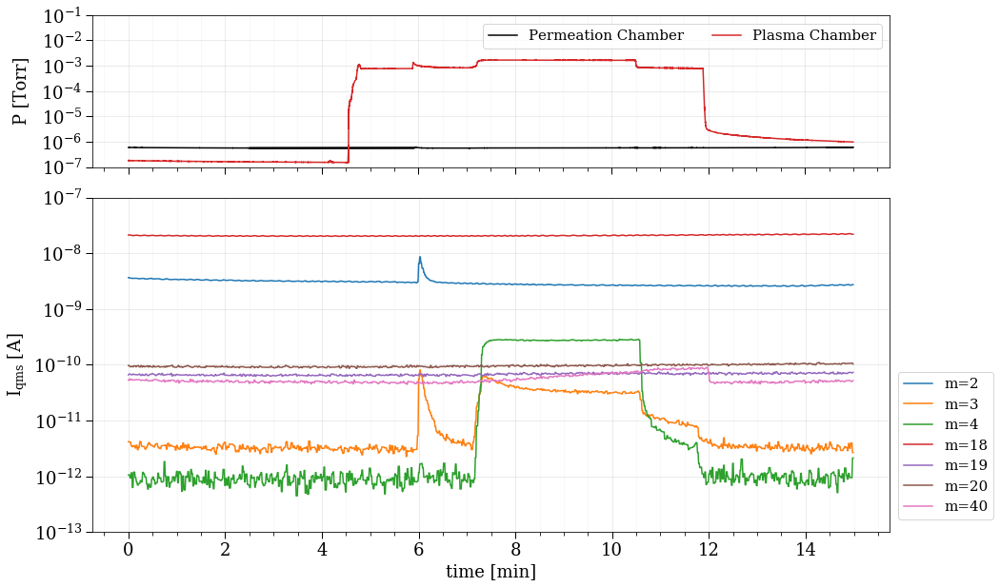

In [361]:
print('argon and D2 plasma')

# range
fr = 300
to = 1200
d_t = data_t[((data_t['time']>=fr) & (data_t['time']<=to))]
d = data[(data['time']>=fr) & (data['time']<=to)]
d_q = data_q[(data_q['time']>=fr) & (data_q['time']<=to)]

# convert
p2 = 10**(1.667*d['P2'] - 11.46) # 11.46 convert Pfeiffer signal to pressure
p1 = d['P1']*10**d['IGscale'] # convert linear IG signal to pressure

def iconv(v):
    return 5/1*(v-2.52)

ip = iconv(d['Ip'])

font_setup(size=18)

# plot
fig = gcf()
# G = gridspec.GridSpec(5,1)
# axs = [plt.subplot(G[0, 0]), plt.subplot(G[1, 0]), plt.subplot(G[2, 0]), plt.subplot(G[3:, 0])]

G = gridspec.GridSpec(3, 1)
axs = [plt.subplot(G[0, 0]), plt.subplot(G[1:, 0])]

# h = 10
# h = 20
# w = h*15/21
h = 10
w = 15
fig.set_size_inches(w,h)
dt = 60

""" plot pressure """
ax = axs[0]
ax.plot(d['time']/dt - d['time'].iloc[0]/dt, p1, c='k', label='Permeation Chamber')
ax.plot(d['time']/dt - d['time'].iloc[0]/dt, p2, c='C3', label='Plasma Chamber')
# ax.plot(d['time']/dt, d['QMS_signal'])
ticks_visual(ax)
ax.set_yscale('log')
ax.set_ylim(1e-7, 1e-1)
ax.set_yticks(np.logspace(-7, -1, 7), minor=False)
# ax.yaxis.set_major_locator(FixedLocator(np.logspace(-7, -1, 4)))
# ax.yaxis.set_minor_locator(FixedLocator([1e-7, 1e-5, 1e-3]))
ax.tick_params(labelbottom=False)
ax.legend(loc=1, ncol = 2, bbox_to_anchor=[1., 0.99], fontsize=15)

# """ plot plasma current """
# ax = axs[1]
# ax.plot(d['time']/dt - d['time'].iloc[0]/dt, ip,'k')
# ticks_visual(ax)
# ax.set_ylim(-0.5, 3.5)
# ax.set_yticks(np.linspace(-0.5, 3.5, 9), minor=False)
# ax.yaxis.set_major_locator(MultipleLocator(1))
# ax.yaxis.set_minor_locator(MultipleLocator(0.5))
# ax.tick_params(labelbottom=False)

# """ plot temperature """
# ax = axs[2]
# ax.plot(d_t['time']/dt - d_t['time'].iloc[0]/dt, d_t['T'],  c='k', label='T')
# ax.plot(d_t['time']/dt- d_t['time'].iloc[0]/dt, d_t['PresetT'],'C2--', label='preset T')
# ticks_visual(ax)
# ax.set_ylim(250,400)
# ax.tick_params(labelbottom=False)
# ax.legend(bbox_to_anchor=[1., 0.99], fontsize=13)

""" plot qms """
# ax = axs[3]
ax = axs[1]
ax.plot(d_q['time']/dt - d_q['time'].iloc[0]/dt, d_q['2'], label='m=2')
ax.plot(d_q['time']/dt - d_q['time'].iloc[0]/dt, d_q['3'], label='m=3')
ax.plot(d_q['time']/dt - d_q['time'].iloc[0]/dt, d_q['4'], label='m=4')
ax.plot(d_q['time']/dt - d_q['time'].iloc[0]/dt, d_q['18'], label='m=18')
ax.plot(d_q['time']/dt - d_q['time'].iloc[0]/dt, d_q['19'], label='m=19')
ax.plot(d_q['time']/dt - d_q['time'].iloc[0]/dt, d_q['20'], label='m=20')
ax.plot(d_q['time']/dt - d_q['time'].iloc[0]/dt, d_q['40'], label='m=40')
# ax.plot(d_q['time']/dt, d_q['analog_1'], c='C3', label='analog_1')
ax.set_yscale('log')
ax.set_ylim(1e-13, 1e-7)
ax.set_yticks(np.logspace(-13, -7, 7), minor=False)
ax.yaxis.set_major_locator(FixedLocator(np.logspace(-13, -7, 7)))
# ax.legend(loc=1, bbox_to_anchor=[1.125, 0.38], fontsize=15)
ax.legend(loc=1, bbox_to_anchor=[1.14, 0.5], fontsize=15)
ticks_visual(ax)

# # plasma on
# plasma_on = 10.87
# axs[0].axvline(plasma_on, c='y')
# axs[1].axvline(plasma_on, c='y')
# axs[2].axvline(plasma_on, c='y')
# axs[3].axvline(plasma_on, c='y')

# # d2 inflow
# d2_in = 12.15
# axs[0].axvline(d2_in, c='y')
# axs[1].axvline(d2_in, c='y')
# axs[2].axvline(d2_in, c='y')
# axs[3].axvline(d2_in, c='y')

# # d2 inflow
# d2_out = 15.5
# axs[0].axvline(d2_out, c='y')
# axs[1].axvline(d2_out, c='y')
# axs[2].axvline(d2_out, c='y')
# axs[3].axvline(d2_out, c='y')

# # poff
# poff = 16.69
# axs[0].axvline(poff, c='y')
# axs[1].axvline(poff, c='y')
# axs[2].axvline(poff, c='y')
# axs[3].axvline(poff, c='y')

[grid_visual(ax) for ax in axs]
fig.align_ylabels()

# axs[0].text(0.015, 0.9, '(a)', fontsize=14, transform=axs[0].transAxes)
# axs[1].text(0.015, 0.9, '(b)', fontsize=14, transform=axs[1].transAxes)
# axs[2].text(0.015, 0.9, '(c)', fontsize=14, transform=axs[2].transAxes)
# axs[3].text(0.015, 0.95, '(d)', fontsize=14, transform=axs[3].transAxes)

# lbls = ['P [Torr]','$I_p$ [A]','T [$^{\circ }$C]', '$I_{qms}$ [A]']
lbls = ['P [Torr]','$I_{qms}$ [A]']
[ax.set_ylabel(l) for l,ax in zip(lbls,axs)]
axs[-1].set_xlabel('time [min]')
#[ax.set_xlim(0,145) for ax in axs]

#fig.savefig(join(bpth,'figures','24Jan_exp.pdf'),dpi = 300,bbox_inches='tight')
# fig.savefig(join(bpth,'figures','24Jan_baking.pdf'),dpi = 300,bbox_inches='tight')
title = 'argon_D2_plasma_1_5A_slide'
fig.savefig(join('./data/figure/{}.pdf'.format(title)),dpi = 300,bbox_inches='tight')

s3 = d_q[d_q['time'] > 0*60+d['time'].iloc[0]]['3'].iloc[0]
s4 = d_q[d_q['time'] > 0*60+d['time'].iloc[0]]['4'].iloc[0]
s3, s4

argon and D2 plasma 1A
<ipython-input-362-0784a405d86e>:148: UserWarning: AutoMinorLocator does not work with logarithmic scale
  fig.savefig(join('./data/figure/{}.pdf'.format(title)),dpi = 300,bbox_inches='tight')
<ipython-input-362-0784a405d86e>:148: UserWarning: AutoMinorLocator does not work with logarithmic scale
  fig.savefig(join('./data/figure/{}.pdf'.format(title)),dpi = 300,bbox_inches='tight')
/Users/itotatsuhiko/.pyenv/versions/3.8.0/lib/python3.8/site-packages/IPython/core/pylabtools.py:128: UserWarning: AutoMinorLocator does not work with logarithmic scale
  fig.canvas.print_figure(bytes_io, **kw)


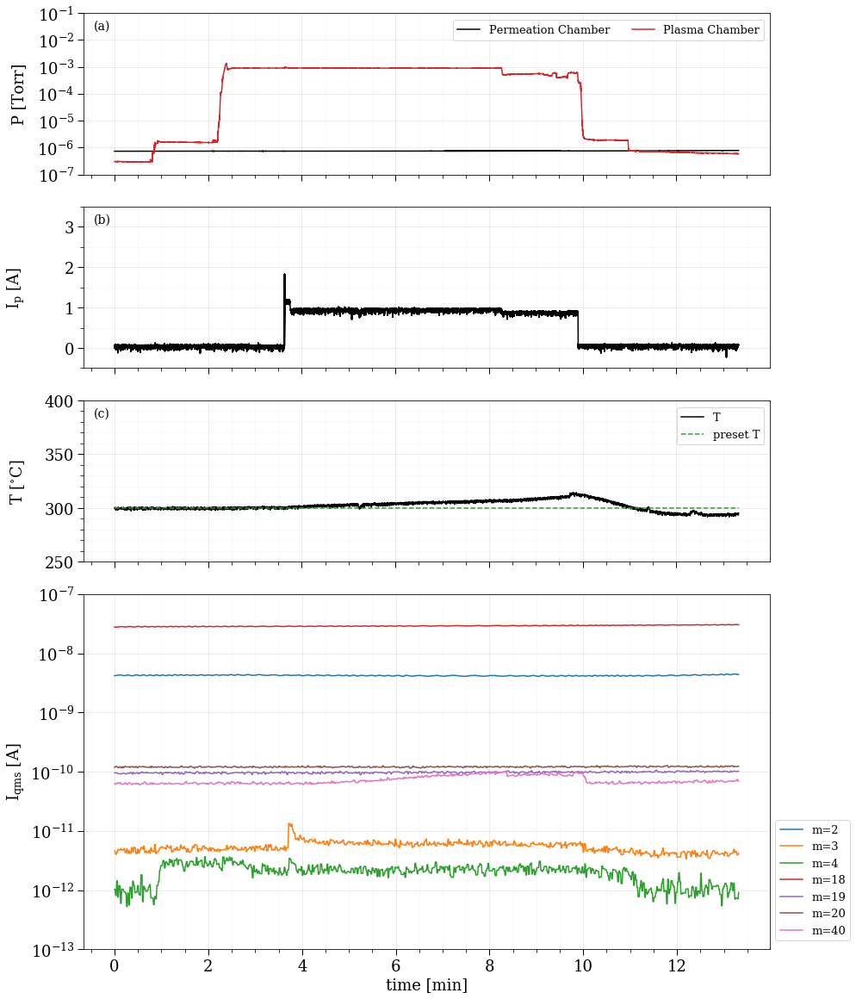

In [362]:
print('argon and D2 plasma 1A')

# range
fr = 3300
to = 4100
d_t = data_t[((data_t['time']>=fr) & (data_t['time']<=to))]
d = data[(data['time']>=fr) & (data['time']<=to)]
d_q = data_q[(data_q['time']>=fr) & (data_q['time']<=to)]

# convert
p2 = 10**(1.667*d['P2'] - 11.46) # 11.46 convert Pfeiffer signal to pressure
p1 = d['P1']*10**d['IGscale'] # convert linear IG signal to pressure

def iconv(v):
    return 5/1*(v-2.52)

ip = iconv(d['Ip'])-0.1

# plot
fig = gcf()
G = gridspec.GridSpec(5,1)
axs = [plt.subplot(G[0, 0]), plt.subplot(G[1, 0]), plt.subplot(G[2, 0]), plt.subplot(G[3:, 0])]

h = 20
w = h*15/21

fig.set_size_inches(w,h)
dt = 60

""" plot pressure """
ax = axs[0]
ax.plot(d['time']/dt - d['time'].iloc[0]/dt, p1, c='k', label='Permeation Chamber')
ax.plot(d['time']/dt - d['time'].iloc[0]/dt, p2, c='C3', label='Plasma Chamber')
# ax.plot(d['time']/dt, d['QMS_signal'])
ticks_visual(ax)
ax.set_yscale('log')
ax.set_ylim(1e-7, 1e-1)
ax.set_yticks(np.logspace(-7, -1, 7), minor=False)
# ax.yaxis.set_major_locator(FixedLocator(np.logspace(-7, -1, 4)))
# ax.yaxis.set_minor_locator(FixedLocator([1e-7, 1e-5, 1e-3]))
ax.tick_params(labelbottom=False)
ax.legend(loc=1, ncol = 2, bbox_to_anchor=[1., 0.99], fontsize=13)

""" plot plasma current """
ax = axs[1]
ax.plot(d['time']/dt - d['time'].iloc[0]/dt, ip,'k')
ticks_visual(ax)
ax.set_ylim(-0.5, 3.5)
ax.set_yticks(np.linspace(-0.5, 3.5, 9), minor=False)
ax.yaxis.set_major_locator(MultipleLocator(1))
ax.yaxis.set_minor_locator(MultipleLocator(0.5))
ax.tick_params(labelbottom=False)

""" plot temperature """
ax = axs[2]
ax.plot(d_t['time']/dt - d_t['time'].iloc[0]/dt, d_t['T'],  c='k', label='T')
ax.plot(d_t['time']/dt- d_t['time'].iloc[0]/dt, d_t['PresetT'],'C2--', label='preset T')
ticks_visual(ax)
ax.set_ylim(250,400)
ax.tick_params(labelbottom=False)
ax.legend(bbox_to_anchor=[1., 0.99], fontsize=13)

""" plot qms """
ax = axs[3]
ax.plot(d_q['time']/dt - d_q['time'].iloc[0]/dt, d_q['2'], label='m=2')
ax.plot(d_q['time']/dt - d_q['time'].iloc[0]/dt, d_q['3'], label='m=3')
ax.plot(d_q['time']/dt - d_q['time'].iloc[0]/dt, d_q['4'], label='m=4')
ax.plot(d_q['time']/dt - d_q['time'].iloc[0]/dt, d_q['18'], label='m=18')
ax.plot(d_q['time']/dt - d_q['time'].iloc[0]/dt, d_q['19'], label='m=19')
ax.plot(d_q['time']/dt - d_q['time'].iloc[0]/dt, d_q['20'], label='m=20')
ax.plot(d_q['time']/dt - d_q['time'].iloc[0]/dt, d_q['40'], label='m=40')
# ax.plot(d_q['time']/dt, d_q['analog_1'], c='C3', label='analog_1')
ax.set_yscale('log')
ax.set_ylim(1e-13, 1e-7)
ax.set_yticks(np.logspace(-13, -7, 7), minor=False)
ax.yaxis.set_major_locator(FixedLocator(np.logspace(-13, -7, 7)))
ax.legend(loc=1, bbox_to_anchor=[1.125, 0.38], fontsize=13)
ticks_visual(ax)

# # d2 inflow
# d2_in = 55.77
# axs[0].axvline(d2_in, c='y')
# axs[1].axvline(d2_in, c='y')
# axs[2].axvline(d2_in, c='y')
# axs[3].axvline(d2_in, c='y')

# # plasma on
# plasma_on = 58.62
# axs[0].axvline(plasma_on, c='y')
# axs[1].axvline(plasma_on, c='y')
# axs[2].axvline(plasma_on, c='y')
# axs[3].axvline(plasma_on, c='y')

# # ar inflow
# ar_in = 57.18
# axs[0].axvline(ar_in, c='y')
# axs[1].axvline(ar_in, c='y')
# axs[2].axvline(ar_in, c='y')
# axs[3].axvline(ar_in, c='y')

# # cathode on
# cathode_on = ar_in + 25/60
# axs[0].axvline(cathode_on, c='y')
# axs[1].axvline(cathode_on, c='y')
# axs[2].axvline(cathode_on, c='y')
# axs[3].axvline(cathode_on, c='y')

# # ar outflow
# # ar_out = 135.27
# ar_out = 64.9
# axs[0].axvline(ar_out, c='y')
# axs[1].axvline(ar_out, c='y')
# axs[2].axvline(ar_out, c='y')
# axs[3].axvline(ar_out, c='y')

# # poff
# poff = 64.9
# axs[0].axvline(poff, c='y')
# axs[1].axvline(poff, c='y')
# axs[2].axvline(poff, c='y')
# axs[3].axvline(poff, c='y')

# # d2 inflow
# d2_out = 65.99
# axs[0].axvline(d2_out, c='y')
# axs[1].axvline(d2_out, c='y')
# axs[2].axvline(d2_out, c='y')
# axs[3].axvline(d2_out, c='y')

[grid_visual(ax) for ax in axs]
fig.align_ylabels()


axs[0].text(0.015, 0.9, '(a)', fontsize=14, transform=axs[0].transAxes)
axs[1].text(0.015, 0.9, '(b)', fontsize=14, transform=axs[1].transAxes)
axs[2].text(0.015, 0.9, '(c)', fontsize=14, transform=axs[2].transAxes)
# axs[3].text(0.015, 0.95, '(d)', fontsize=14, transform=axs[3].transAxes)

lbls = ['P [Torr]','$I_p$ [A]','T [$^{\circ }$C]', '$I_{qms}$ [A]']
[ax.set_ylabel(l) for l,ax in zip(lbls,axs)]
axs[-1].set_xlabel('time [min]')
#[ax.set_xlim(0,145) for ax in axs]

#fig.savefig(join(bpth,'figures','24Jan_exp.pdf'),dpi = 300,bbox_inches='tight')
# fig.savefig(join(bpth,'figures','24Jan_baking.pdf'),dpi = 300,bbox_inches='tight')
# fig.savefig(join('./ar_d2_plasma_1.5A.pdf'),dpi = 300,bbox_inches='tight')
title = 'argon_D2_plasma_1A'
fig.savefig(join('./data/figure/{}.pdf'.format(title)),dpi = 300,bbox_inches='tight')

argon and H2 plasma
<ipython-input-130-b0b9a4fb7916>:180: UserWarning: AutoMinorLocator does not work with logarithmic scale
  fig.savefig(join('./data/figure/{}.pdf'.format(title)),dpi = 300,bbox_inches='tight')
<ipython-input-130-b0b9a4fb7916>:180: UserWarning: AutoMinorLocator does not work with logarithmic scale
  fig.savefig(join('./data/figure/{}.pdf'.format(title)),dpi = 300,bbox_inches='tight')


(5.2900000000000006e-09, 4.25e-12)

/Users/itotatsuhiko/.pyenv/versions/3.8.0/lib/python3.8/site-packages/IPython/core/pylabtools.py:128: UserWarning: AutoMinorLocator does not work with logarithmic scale
  fig.canvas.print_figure(bytes_io, **kw)


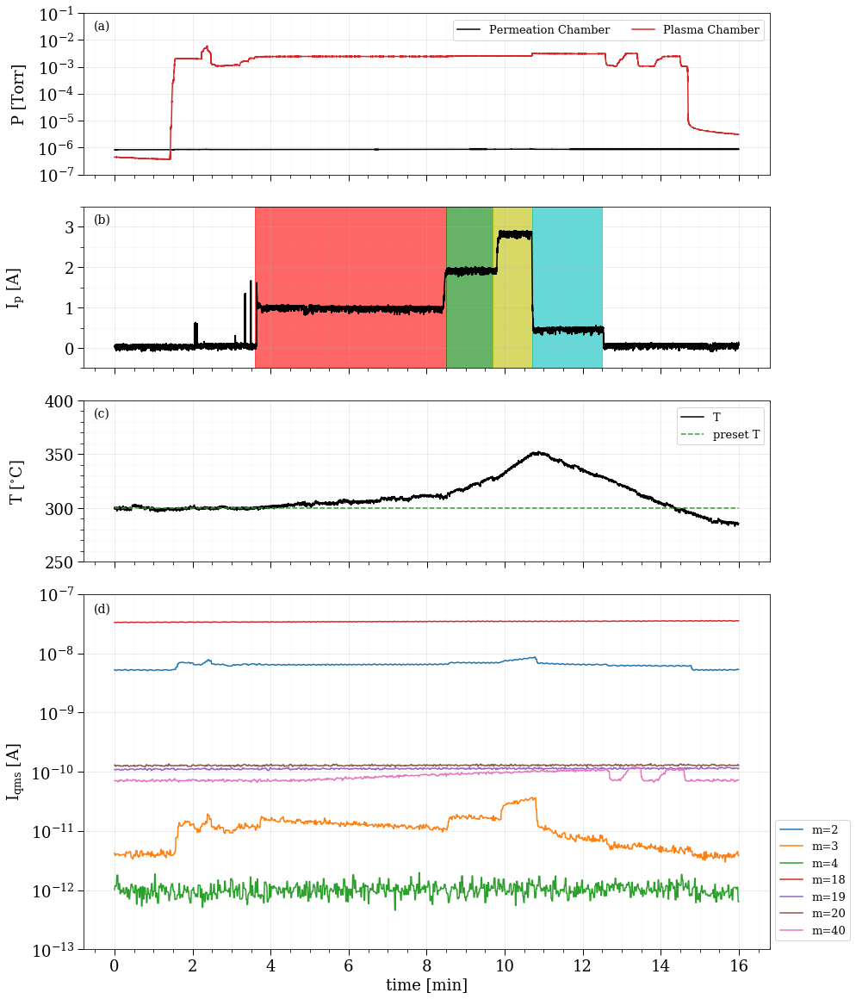

In [130]:
print('argon and H2 plasma')

# range
fr = 5090
to = 6050
d_t = data_t[((data_t['time']>=fr) & (data_t['time']<=to))]
d = data[(data['time']>=fr) & (data['time']<=to)]
d_q = data_q[(data_q['time']>=fr) & (data_q['time']<=to)]

# convert
p2 = 10**(1.667*d['P2'] - 11.46) # 11.46 convert Pfeiffer signal to pressure
p1 = d['P1']*10**d['IGscale'] # convert linear IG signal to pressure

def iconv(v):
    return 5/1*(v-2.52)

ip = iconv(d['Ip'])-0.1

# plot
fig = gcf()
G = gridspec.GridSpec(5,1)
axs = [plt.subplot(G[0, 0]), plt.subplot(G[1, 0]), plt.subplot(G[2, 0]), plt.subplot(G[3:, 0])]

h = 20
w = h*15/21

fig.set_size_inches(w,h)
dt = 60

""" plot pressure """
ax = axs[0]
ax.plot(d['time']/dt - d['time'].iloc[0]/dt, p1, c='k', label='Permeation Chamber')
ax.plot(d['time']/dt - d['time'].iloc[0]/dt, p2, c='C3', label='Plasma Chamber')
# ax.plot(d['time']/dt, d['QMS_signal'])
ticks_visual(ax)
ax.set_yscale('log')
ax.set_ylim(1e-7, 1e-1)
ax.set_yticks(np.logspace(-7, -1, 7), minor=False)
# ax.yaxis.set_major_locator(FixedLocator(np.logspace(-7, -1, 4)))
# ax.yaxis.set_minor_locator(FixedLocator([1e-7, 1e-5, 1e-3]))
ax.tick_params(labelbottom=False)
ax.legend(loc=1, ncol = 2, bbox_to_anchor=[1., 0.99], fontsize=13)

""" plot plasma current """
ax = axs[1]
ax.plot(d['time']/dt - d['time'].iloc[0]/dt, ip,'k')
ticks_visual(ax)
ax.set_ylim(-0.5, 3.5)
ax.set_yticks(np.linspace(-0.5, 3.5, 9), minor=False)
ax.yaxis.set_major_locator(MultipleLocator(1))
ax.yaxis.set_minor_locator(MultipleLocator(0.5))
ax.tick_params(labelbottom=False)

""" plot temperature """
ax = axs[2]
ax.plot(d_t['time']/dt - d_t['time'].iloc[0]/dt, d_t['T'],  c='k', label='T')
ax.plot(d_t['time']/dt- d_t['time'].iloc[0]/dt, d_t['PresetT'],'C2--', label='preset T')
ticks_visual(ax)
ax.set_ylim(250,400)
ax.tick_params(labelbottom=False)
ax.legend(bbox_to_anchor=[1., 0.99], fontsize=13)

""" plot qms """
ax = axs[3]
ax.plot(d_q['time']/dt - d_q['time'].iloc[0]/dt, d_q['2'], label='m=2')
ax.plot(d_q['time']/dt - d_q['time'].iloc[0]/dt, d_q['3'], label='m=3')
ax.plot(d_q['time']/dt - d_q['time'].iloc[0]/dt, d_q['4'], label='m=4')
ax.plot(d_q['time']/dt - d_q['time'].iloc[0]/dt, d_q['18'], label='m=18')
ax.plot(d_q['time']/dt - d_q['time'].iloc[0]/dt, d_q['19'], label='m=19')
ax.plot(d_q['time']/dt - d_q['time'].iloc[0]/dt, d_q['20'], label='m=20')
ax.plot(d_q['time']/dt - d_q['time'].iloc[0]/dt, d_q['40'], label='m=40')
# ax.plot(d_q['time']/dt, d_q['analog_1'], c='C3', label='analog_1')
ax.set_yscale('log')
ax.set_ylim(1e-13, 1e-7)
ax.set_yticks(np.logspace(-13, -7, 7), minor=False)
ax.yaxis.set_major_locator(FixedLocator(np.logspace(-13, -7, 7)))
ax.legend(loc=1, bbox_to_anchor=[1.125, 0.38], fontsize=13)
ticks_visual(ax)


# # h2 inflow
# h2_in = 86.26
# axs[0].axvline(h2_in, c='y')
# axs[1].axvline(h2_in, c='y')
# axs[2].axvline(h2_in, c='y')
# axs[3].axvline(h2_in, c='y')

# # cathode on
# cathode_on = h2_in + 35/60
# axs[0].axvline(cathode_on, c='y')
# axs[1].axvline(cathode_on, c='y')
# axs[2].axvline(cathode_on, c='y')
# axs[3].axvline(cathode_on, c='y')

# # ar inflow
# ar_in = 88
# axs[0].axvline(ar_in, c='y')
# axs[1].axvline(ar_in, c='y')
# axs[2].axvline(ar_in, c='y')
# axs[3].axvline(ar_in, c='y')

# # plasma on
# plasma_on = 88.48 - d['time'].iloc[0]/dt
# axs[0].axvline(plasma_on, c='y')
# axs[1].axvline(plasma_on, c='y')
# axs[2].axvline(plasma_on, c='y')
# axs[3].axvline(plasma_on, c='y')

# # 2A
# A2 = 93.33 - d['time'].iloc[0]/dt
# axs[0].axvline(A2, c='y')
# axs[1].axvline(A2, c='y')
# axs[2].axvline(A2, c='y')
# axs[3].axvline(A2, c='y')

# # 3A
# A3 = 94.7 - d['time'].iloc[0]/dt
# axs[0].axvline(A3, c='y')
# axs[1].axvline(A3, c='y')
# axs[2].axvline(A3, c='y')
# axs[3].axvline(A3, c='y')

# # 0.5A
# A5 = 95.6 - d['time'].iloc[0]/dt
# axs[0].axvline(A5, c='y')
# axs[1].axvline(A5, c='y')
# axs[2].axvline(A5, c='y')
# axs[3].axvline(A5, c='y')

# # poff
# poff = 97.42 - d['time'].iloc[0]/dt
# axs[0].axvline(poff, c='y')
# axs[1].axvline(poff, c='y')
# axs[2].axvline(poff, c='y')
# axs[3].axvline(poff, c='y')

# print(plasma_on)
# print(A2)
# print(A3)
# print(A5)
# print(poff)

# # ar outflow
# ar_out = poff
# axs[0].axvline(ar_out, c='y')
# axs[1].axvline(ar_out, c='y')
# axs[2].axvline(ar_out, c='y')
# axs[3].axvline(ar_out, c='y')

# # h2 inflow
# h2_out = 99.5
# axs[0].axvline(h2_out, c='y')
# axs[1].axvline(h2_out, c='y')
# axs[2].axvline(h2_out, c='y')
# axs[3].axvline(h2_out, c='y')


[grid_visual(ax) for ax in axs]
fig.align_ylabels()

axs[1].axvspan(3.6, 8.5, color="r", alpha=0.6)
axs[1].axvspan(8.5, 9.7, color="g", alpha=0.6)
axs[1].axvspan(9.7, 10.7, color="y", alpha=0.6)
axs[1].axvspan(10.7, 12.5, color="c", alpha=0.6)

axs[0].text(0.015, 0.9, '(a)', fontsize=14, transform=axs[0].transAxes)
axs[1].text(0.015, 0.9, '(b)', fontsize=14, transform=axs[1].transAxes)
axs[2].text(0.015, 0.9, '(c)', fontsize=14, transform=axs[2].transAxes)
axs[3].text(0.015, 0.95, '(d)', fontsize=14, transform=axs[3].transAxes)

lbls = ['P [Torr]','$I_p$ [A]','T [$^{\circ }$C]', '$I_{qms}$ [A]']
[ax.set_ylabel(l) for l,ax in zip(lbls,axs)]
axs[-1].set_xlabel('time [min]')
#[ax.set_xlim(0,145) for ax in axs]

#fig.savefig(join(bpth,'figures','24Jan_exp.pdf'),dpi = 300,bbox_inches='tight')
# fig.savefig(join(bpth,'figures','24Jan_baking.pdf'),dpi = 300,bbox_inches='tight')
# fig.savefig(join('./ar_d2_plasma_1.5A.pdf'),dpi = 300,bbox_inches='tight')
title = 'argon_H2_plasma_1_2_3_05A'
fig.savefig(join('./data/figure/{}.pdf'.format(title)),dpi = 300,bbox_inches='tight')

# ss = d[d['time'] > 0*60+d['time'].iloc[0]]['P2'].iloc[0]
# 10**(1.667*ss - 11.46)

s2 = d_q[d_q['time'] > 0*60+d['time'].iloc[0]]['2'].iloc[0]
s3 = d_q[d_q['time'] > 0*60+d['time'].iloc[0]]['3'].iloc[0]
s2, s3

argon plasma
<ipython-input-289-b339405002bf>:137: UserWarning: AutoMinorLocator does not work with logarithmic scale
  fig.savefig(join('./data/figure/{}.pdf'.format(title)),dpi = 300,bbox_inches='tight')
<ipython-input-289-b339405002bf>:137: UserWarning: AutoMinorLocator does not work with logarithmic scale
  fig.savefig(join('./data/figure/{}.pdf'.format(title)),dpi = 300,bbox_inches='tight')


0.0012847191544900197

/Users/itotatsuhiko/.pyenv/versions/3.8.0/lib/python3.8/site-packages/IPython/core/pylabtools.py:128: UserWarning: AutoMinorLocator does not work with logarithmic scale
  fig.canvas.print_figure(bytes_io, **kw)


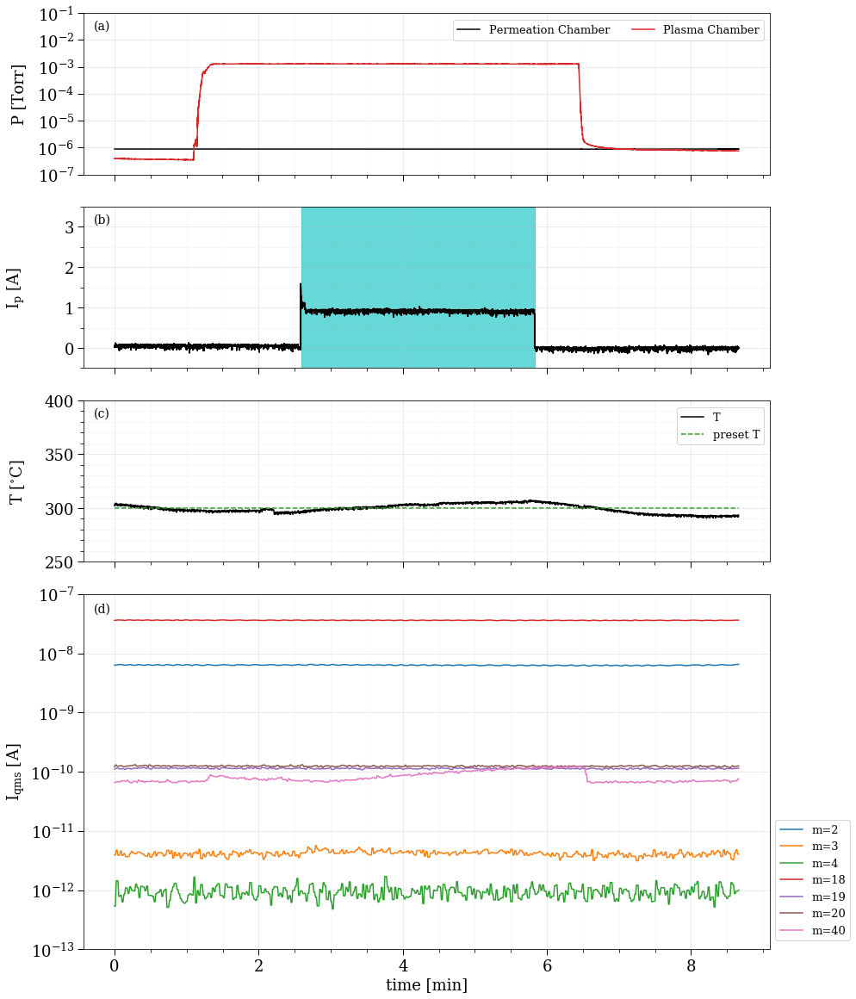

In [289]:
print('argon plasma')

# range
fr = 7730
to = 8250
d_t = data_t[((data_t['time']>=fr) & (data_t['time']<=to))]
d = data[(data['time']>=fr) & (data['time']<=to)]
d_q = data_q[(data_q['time']>=fr) & (data_q['time']<=to)]

# convert
p2 = 10**(1.667*d['P2'] - 11.46) # 11.46 convert Pfeiffer signal to pressure
p1 = d['P1']*10**d['IGscale'] # convert linear IG signal to pressure

def iconv(v):
    return 5/1*(v-2.52)

ip = iconv(d['Ip']) - 0.3
# plot
fig = gcf()
G = gridspec.GridSpec(5,1)
axs = [plt.subplot(G[0, 0]), plt.subplot(G[1, 0]), plt.subplot(G[2, 0]), plt.subplot(G[3:, 0])]

h = 20
w = h*15/21

fig.set_size_inches(w,h)
dt = 60

""" plot pressure """
ax = axs[0]
ax.plot(d['time']/dt - d['time'].iloc[0]/dt, p1, c='k', label='Permeation Chamber')
ax.plot(d['time']/dt - d['time'].iloc[0]/dt, p2, c='C3', label='Plasma Chamber')
# ax.plot(d['time']/dt, d['QMS_signal'])
ticks_visual(ax)
ax.set_yscale('log')
ax.set_ylim(1e-7, 1e-1)
ax.set_yticks(np.logspace(-7, -1, 7), minor=False)
# ax.yaxis.set_major_locator(FixedLocator(np.logspace(-7, -1, 4)))
# ax.yaxis.set_minor_locator(FixedLocator([1e-7, 1e-5, 1e-3]))
ax.tick_params(labelbottom=False)
ax.legend(loc=1, ncol = 2, bbox_to_anchor=[1., 0.99], fontsize=13)

""" plot plasma current """
ax = axs[1]
ax.plot(d['time']/dt - d['time'].iloc[0]/dt, ip,'k')
ticks_visual(ax)
ax.set_ylim(-0.5, 3.5)
ax.set_yticks(np.linspace(-0.5, 3.5, 9), minor=False)
ax.yaxis.set_major_locator(MultipleLocator(1))
ax.yaxis.set_minor_locator(MultipleLocator(0.5))
ax.tick_params(labelbottom=False)

""" plot temperature """
ax = axs[2]
ax.plot(d_t['time']/dt - d_t['time'].iloc[0]/dt, d_t['T'],  c='k', label='T')
ax.plot(d_t['time']/dt- d_t['time'].iloc[0]/dt, d_t['PresetT'],'C2--', label='preset T')
ticks_visual(ax)
ax.set_ylim(250,400)
ax.tick_params(labelbottom=False)
ax.legend(bbox_to_anchor=[1., 0.99], fontsize=13)

""" plot qms """
ax = axs[3]
ax.plot(d_q['time']/dt - d_q['time'].iloc[0]/dt, d_q['2'], label='m=2')
ax.plot(d_q['time']/dt - d_q['time'].iloc[0]/dt, d_q['3'], label='m=3')
ax.plot(d_q['time']/dt - d_q['time'].iloc[0]/dt, d_q['4'], label='m=4')
ax.plot(d_q['time']/dt - d_q['time'].iloc[0]/dt, d_q['18'], label='m=18')
ax.plot(d_q['time']/dt - d_q['time'].iloc[0]/dt, d_q['19'], label='m=19')
ax.plot(d_q['time']/dt - d_q['time'].iloc[0]/dt, d_q['20'], label='m=20')
ax.plot(d_q['time']/dt - d_q['time'].iloc[0]/dt, d_q['40'], label='m=40')
# ax.plot(d_q['time']/dt, d_q['analog_1'], c='C3', label='analog_1')
ax.set_yscale('log')
ax.set_ylim(1e-13, 1e-7)
ax.set_yticks(np.logspace(-13, -7, 7), minor=False)
ax.yaxis.set_major_locator(FixedLocator(np.logspace(-13, -7, 7)))
ax.legend(loc=1, bbox_to_anchor=[1.125, 0.38], fontsize=13)
ticks_visual(ax)


# # ar inflow
# ar_in = 129.93
# axs[0].axvline(ar_in, c='y')
# axs[1].axvline(ar_in, c='y')
# axs[2].axvline(ar_in, c='y')
# axs[3].axvline(ar_in, c='y')

# # cathode on
# cathode_on = ar_in + 15/60
# axs[0].axvline(cathode_on, c='y')
# axs[1].axvline(cathode_on, c='y')
# axs[2].axvline(cathode_on, c='y')
# axs[3].axvline(cathode_on, c='y')

# # plasma on
# plasma_on = 131.42
# axs[0].axvline(plasma_on, c='y')
# axs[1].axvline(plasma_on, c='y')
# axs[2].axvline(plasma_on, c='y')
# axs[3].axvline(plasma_on, c='y')

# # plasma off
# plasma_off = 134.67
# axs[0].axvline(plasma_off, c='y')
# axs[1].axvline(plasma_off, c='y')
# axs[2].axvline(plasma_off, c='y')
# axs[3].axvline(plasma_off, c='y')

# # ar outflow
# ar_out = 135.3
# axs[0].axvline(ar_out, c='y')
# axs[1].axvline(ar_out, c='y')
# axs[2].axvline(ar_out, c='y')
# axs[3].axvline(ar_out, c='y')

# # cathode off
# cathode_off = ar_out + 10/60
# axs[0].axvline(cathode_off, c='y')
# axs[1].axvline(cathode_off, c='y')
# axs[2].axvline(cathode_off, c='y')
# axs[3].axvline(cathode_off, c='y')

[grid_visual(ax) for ax in axs]
fig.align_ylabels()

axs[0].text(0.015, 0.9, '(a)', fontsize=14, transform=axs[0].transAxes)
axs[1].text(0.015, 0.9, '(b)', fontsize=14, transform=axs[1].transAxes)
axs[2].text(0.015, 0.9, '(c)', fontsize=14, transform=axs[2].transAxes)
axs[3].text(0.015, 0.95, '(d)', fontsize=14, transform=axs[3].transAxes)

axs[1].axvspan(2.6, 5.84, color="c", alpha=0.6)

lbls = ['P [Torr]','$I_p$ [A]','T [$^{\circ }$C]', '$I_{qms}$ [A]']
[ax.set_ylabel(l) for l,ax in zip(lbls,axs)]
axs[-1].set_xlabel('time [min]')

title = 'argon_plasma_1A'
fig.savefig(join('./data/figure/{}.pdf'.format(title)),dpi = 300,bbox_inches='tight')
ss = d[d['time'] > 2*60+d['time'].iloc[0]]['P2'].iloc[0]
10**(1.667*ss - 11.46)


# no plasma

d2 no plasma
<ipython-input-75-145ec0d69254>:140: UserWarning: AutoMinorLocator does not work with logarithmic scale
  fig.savefig(join('./data/figure/{}.pdf'.format(title)),dpi = 300,bbox_inches='tight')
<ipython-input-75-145ec0d69254>:140: UserWarning: AutoMinorLocator does not work with logarithmic scale
  fig.savefig(join('./data/figure/{}.pdf'.format(title)),dpi = 300,bbox_inches='tight')


(5.05e-11, 1.21e-09)

/Users/itotatsuhiko/.pyenv/versions/3.8.0/lib/python3.8/site-packages/IPython/core/pylabtools.py:128: UserWarning: AutoMinorLocator does not work with logarithmic scale
  fig.canvas.print_figure(bytes_io, **kw)


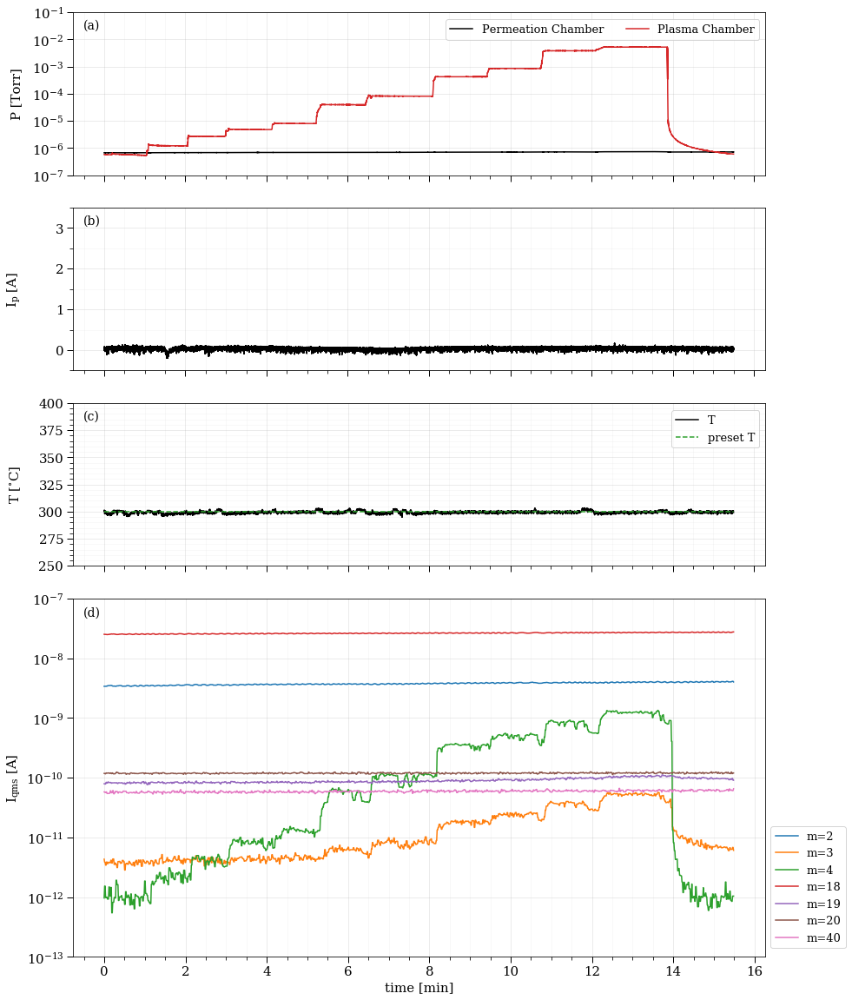

In [75]:
print('d2 no plasma')

# range
fr = 2070
to = 3000
d_t = data_t[((data_t['time']>=fr) & (data_t['time']<=to))]
d = data[(data['time']>=fr) & (data['time']<=to)]
d_q = data_q[(data_q['time']>=fr) & (data_q['time']<=to)]

# convert
p2 = 10**(1.667*d['P2'] - 11.46) # 11.46 convert Pfeiffer signal to pressure
p1 = d['P1']*10**d['IGscale'] # convert linear IG signal to pressure

def iconv(v):
    return 5/1*(v-2.52)

ip = iconv(d['Ip'])-0.1

# plot
fig = gcf()
G = gridspec.GridSpec(5,1)
axs = [plt.subplot(G[0, 0]), plt.subplot(G[1, 0]), plt.subplot(G[2, 0]), plt.subplot(G[3:, 0])]

h = 20
w = h*15/21

fig.set_size_inches(w,h)
dt = 60

""" plot pressure """
ax = axs[0]
ax.plot(d['time']/dt - d['time'].iloc[0]/dt, p1, c='k', label='Permeation Chamber')
ax.plot(d['time']/dt - d['time'].iloc[0]/dt, p2, c='C3', label='Plasma Chamber')
# ax.plot(d['time']/dt, d['QMS_signal'])
ticks_visual(ax)
ax.set_yscale('log')
ax.set_ylim(1e-7, 1e-1)
ax.set_yticks(np.logspace(-7, -1, 7), minor=False)
# ax.yaxis.set_major_locator(FixedLocator(np.logspace(-7, -1, 4)))
# ax.yaxis.set_minor_locator(FixedLocator([1e-7, 1e-5, 1e-3]))
ax.tick_params(labelbottom=False)
ax.legend(loc=1, ncol = 2, bbox_to_anchor=[1., 0.99], fontsize=13)

""" plot plasma current """
ax = axs[1]
ax.plot(d['time']/dt - d['time'].iloc[0]/dt, ip,'k')
ticks_visual(ax)
ax.set_ylim(-0.5, 3.5)
ax.set_yticks(np.linspace(-0.5, 3.5, 9), minor=False)
ax.yaxis.set_major_locator(MultipleLocator(1))
ax.yaxis.set_minor_locator(MultipleLocator(0.5))
ax.tick_params(labelbottom=False)

""" plot temperature """
ax = axs[2]
ax.plot(d_t['time']/dt - d_t['time'].iloc[0]/dt, d_t['T'],  c='k', label='T')
ax.plot(d_t['time']/dt- d_t['time'].iloc[0]/dt, d_t['PresetT'],'C2--', label='preset T')
ticks_visual(ax)
ax.set_ylim(250,400)
ax.tick_params(labelbottom=False)
ax.legend(bbox_to_anchor=[1., 0.99], fontsize=13)

""" plot qms """
ax = axs[3]
ax.plot(d_q['time']/dt - d_q['time'].iloc[0]/dt, d_q['2'], label='m=2')
ax.plot(d_q['time']/dt - d_q['time'].iloc[0]/dt, d_q['3'], label='m=3')
ax.plot(d_q['time']/dt - d_q['time'].iloc[0]/dt, d_q['4'], label='m=4')
ax.plot(d_q['time']/dt - d_q['time'].iloc[0]/dt, d_q['18'], label='m=18')
ax.plot(d_q['time']/dt - d_q['time'].iloc[0]/dt, d_q['19'], label='m=19')
ax.plot(d_q['time']/dt - d_q['time'].iloc[0]/dt, d_q['20'], label='m=20')
ax.plot(d_q['time']/dt - d_q['time'].iloc[0]/dt, d_q['40'], label='m=40')
# ax.plot(d_q['time']/dt, d_q['analog_1'], c='C3', label='analog_1')
ax.set_yscale('log')
ax.set_ylim(1e-13, 1e-7)
ax.set_yticks(np.logspace(-13, -7, 7), minor=False)
ax.yaxis.set_major_locator(FixedLocator(np.logspace(-13, -7, 7)))
ax.legend(loc=1, bbox_to_anchor=[1.125, 0.38], fontsize=13)
ticks_visual(ax)


# # ar inflow
# ar_in = 129.93
# axs[0].axvline(ar_in, c='y')
# axs[1].axvline(ar_in, c='y')
# axs[2].axvline(ar_in, c='y')
# axs[3].axvline(ar_in, c='y')

# # cathode on
# cathode_on = ar_in + 15/60
# axs[0].axvline(cathode_on, c='y')
# axs[1].axvline(cathode_on, c='y')
# axs[2].axvline(cathode_on, c='y')
# axs[3].axvline(cathode_on, c='y')

# # plasma on
# plasma_on = 131.42
# axs[0].axvline(plasma_on, c='y')
# axs[1].axvline(plasma_on, c='y')
# axs[2].axvline(plasma_on, c='y')
# axs[3].axvline(plasma_on, c='y')

# # plasma off
# plasma_off = 134.67
# axs[0].axvline(plasma_off, c='y')
# axs[1].axvline(plasma_off, c='y')
# axs[2].axvline(plasma_off, c='y')
# axs[3].axvline(plasma_off, c='y')

# # ar outflow
# ar_out = 135.3
# axs[0].axvline(ar_out, c='y')
# axs[1].axvline(ar_out, c='y')
# axs[2].axvline(ar_out, c='y')
# axs[3].axvline(ar_out, c='y')

# # cathode off
# cathode_off = ar_out + 10/60
# axs[0].axvline(cathode_off, c='y')
# axs[1].axvline(cathode_off, c='y')
# axs[2].axvline(cathode_off, c='y')
# axs[3].axvline(cathode_off, c='y')

[grid_visual(ax) for ax in axs]
fig.align_ylabels()

axs[0].text(0.015, 0.9, '(a)', fontsize=14, transform=axs[0].transAxes)
axs[1].text(0.015, 0.9, '(b)', fontsize=14, transform=axs[1].transAxes)
axs[2].text(0.015, 0.9, '(c)', fontsize=14, transform=axs[2].transAxes)
axs[3].text(0.015, 0.95, '(d)', fontsize=14, transform=axs[3].transAxes)

lbls = ['P [Torr]','$I_p$ [A]','T [$^{\circ }$C]', '$I_{qms}$ [A]']
[ax.set_ylabel(l) for l,ax in zip(lbls,axs)]
axs[-1].set_xlabel('time [min]')
#[ax.set_xlim(0,145) for ax in axs]

#fig.savefig(join(bpth,'figures','24Jan_exp.pdf'),dpi = 300,bbox_inches='tight')
# fig.savefig(join(bpth,'figures','24Jan_baking.pdf'),dpi = 300,bbox_inches='tight')
# fig.savefig(join('./ar_d2_plasma_1.5A.pdf'),dpi = 300,bbox_inches='tight')
title = 'D2_no_plasma'
fig.savefig(join('./data/figure/{}.pdf'.format(title)),dpi = 300,bbox_inches='tight')
ss = d[d['time'] > 13*60+d['time'].iloc[0]]['P2'].iloc[0]

s3 = d_q[d_q['time'] > 13*60+d['time'].iloc[0]]['3'].iloc[0]
s4 = d_q[d_q['time'] > 13*60+d['time'].iloc[0]]['4'].iloc[0]
s3, s4

h2 no plasma
<ipython-input-76-e1e1ee90b6b0>:139: UserWarning: AutoMinorLocator does not work with logarithmic scale
  fig.savefig(join('./data/figure/{}.pdf'.format(title)),dpi = 300,bbox_inches='tight')
<ipython-input-76-e1e1ee90b6b0>:139: UserWarning: AutoMinorLocator does not work with logarithmic scale
  fig.savefig(join('./data/figure/{}.pdf'.format(title)),dpi = 300,bbox_inches='tight')


(7.120000000000001e-09, 1.34e-11)

/Users/itotatsuhiko/.pyenv/versions/3.8.0/lib/python3.8/site-packages/IPython/core/pylabtools.py:128: UserWarning: AutoMinorLocator does not work with logarithmic scale
  fig.canvas.print_figure(bytes_io, **kw)


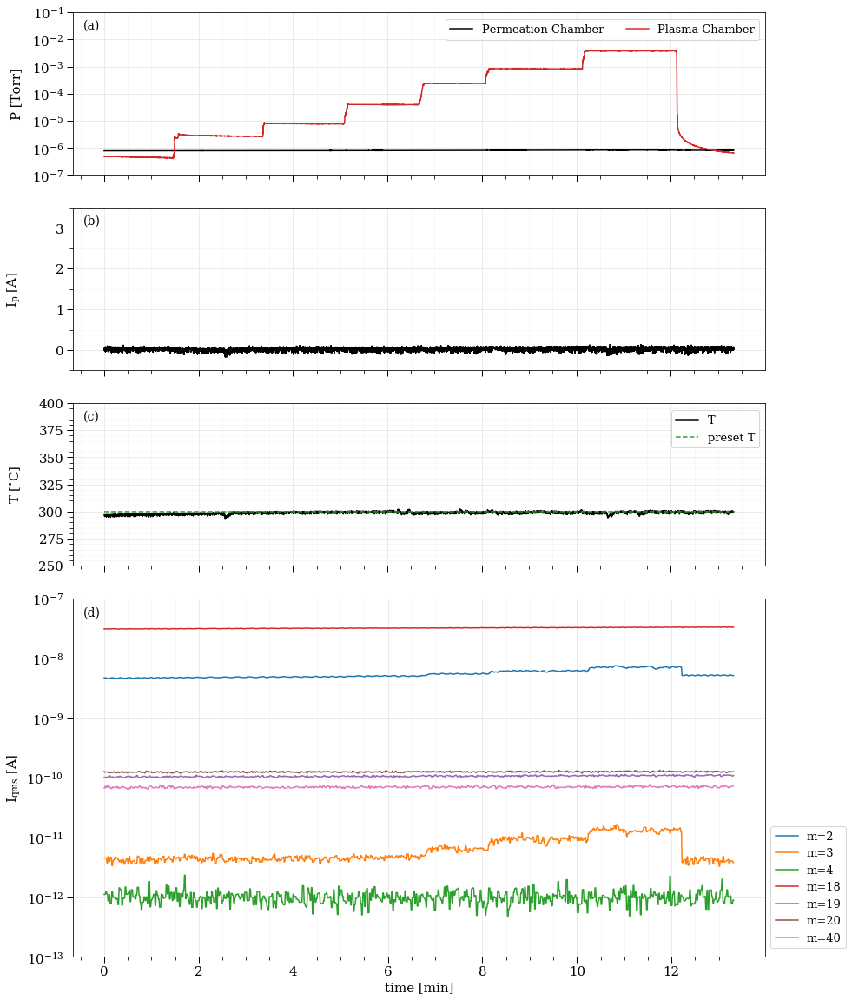

In [76]:
print('h2 no plasma')

# range
fr = 4200
to = 5000
d_t = data_t[((data_t['time']>=fr) & (data_t['time']<=to))]
d = data[(data['time']>=fr) & (data['time']<=to)]
d_q = data_q[(data_q['time']>=fr) & (data_q['time']<=to)]

# convert
p2 = 10**(1.667*d['P2'] - 11.46) # 11.46 convert Pfeiffer signal to pressure
p1 = d['P1']*10**d['IGscale'] # convert linear IG signal to pressure

def iconv(v):
    return 5/1*(v-2.52)

ip = iconv(d['Ip'])-0.1
# plot
fig = gcf()
G = gridspec.GridSpec(5,1)
axs = [plt.subplot(G[0, 0]), plt.subplot(G[1, 0]), plt.subplot(G[2, 0]), plt.subplot(G[3:, 0])]

h = 20
w = h*15/21

fig.set_size_inches(w,h)
dt = 60

""" plot pressure """
ax = axs[0]
ax.plot(d['time']/dt - d['time'].iloc[0]/dt, p1, c='k', label='Permeation Chamber')
ax.plot(d['time']/dt - d['time'].iloc[0]/dt, p2, c='C3', label='Plasma Chamber')
# ax.plot(d['time']/dt, d['QMS_signal'])
ticks_visual(ax)
ax.set_yscale('log')
ax.set_ylim(1e-7, 1e-1)
ax.set_yticks(np.logspace(-7, -1, 7), minor=False)
# ax.yaxis.set_major_locator(FixedLocator(np.logspace(-7, -1, 4)))
# ax.yaxis.set_minor_locator(FixedLocator([1e-7, 1e-5, 1e-3]))
ax.tick_params(labelbottom=False)
ax.legend(loc=1, ncol = 2, bbox_to_anchor=[1., 0.99], fontsize=13)

""" plot plasma current """
ax = axs[1]
ax.plot(d['time']/dt - d['time'].iloc[0]/dt, ip,'k')
ticks_visual(ax)
ax.set_ylim(-0.5, 3.5)
ax.set_yticks(np.linspace(-0.5, 3.5, 9), minor=False)
ax.yaxis.set_major_locator(MultipleLocator(1))
ax.yaxis.set_minor_locator(MultipleLocator(0.5))
ax.tick_params(labelbottom=False)

""" plot temperature """
ax = axs[2]
ax.plot(d_t['time']/dt - d_t['time'].iloc[0]/dt, d_t['T'],  c='k', label='T')
ax.plot(d_t['time']/dt- d_t['time'].iloc[0]/dt, d_t['PresetT'],'C2--', label='preset T')
ticks_visual(ax)
ax.set_ylim(250,400)
ax.tick_params(labelbottom=False)
ax.legend(bbox_to_anchor=[1., 0.99], fontsize=13)

""" plot qms """
ax = axs[3]
ax.plot(d_q['time']/dt - d_q['time'].iloc[0]/dt, d_q['2'], label='m=2')
ax.plot(d_q['time']/dt - d_q['time'].iloc[0]/dt, d_q['3'], label='m=3')
ax.plot(d_q['time']/dt - d_q['time'].iloc[0]/dt, d_q['4'], label='m=4')
ax.plot(d_q['time']/dt - d_q['time'].iloc[0]/dt, d_q['18'], label='m=18')
ax.plot(d_q['time']/dt - d_q['time'].iloc[0]/dt, d_q['19'], label='m=19')
ax.plot(d_q['time']/dt - d_q['time'].iloc[0]/dt, d_q['20'], label='m=20')
ax.plot(d_q['time']/dt - d_q['time'].iloc[0]/dt, d_q['40'], label='m=40')
# ax.plot(d_q['time']/dt, d_q['analog_1'], c='C3', label='analog_1')
ax.set_yscale('log')
ax.set_ylim(1e-13, 1e-7)
ax.set_yticks(np.logspace(-13, -7, 7), minor=False)
ax.yaxis.set_major_locator(FixedLocator(np.logspace(-13, -7, 7)))
ax.legend(loc=1, bbox_to_anchor=[1.125, 0.38], fontsize=13)
ticks_visual(ax)


# # ar inflow
# ar_in = 129.93
# axs[0].axvline(ar_in, c='y')
# axs[1].axvline(ar_in, c='y')
# axs[2].axvline(ar_in, c='y')
# axs[3].axvline(ar_in, c='y')

# # cathode on
# cathode_on = ar_in + 15/60
# axs[0].axvline(cathode_on, c='y')
# axs[1].axvline(cathode_on, c='y')
# axs[2].axvline(cathode_on, c='y')
# axs[3].axvline(cathode_on, c='y')

# # plasma on
# plasma_on = 131.42
# axs[0].axvline(plasma_on, c='y')
# axs[1].axvline(plasma_on, c='y')
# axs[2].axvline(plasma_on, c='y')
# axs[3].axvline(plasma_on, c='y')

# # plasma off
# plasma_off = 134.67
# axs[0].axvline(plasma_off, c='y')
# axs[1].axvline(plasma_off, c='y')
# axs[2].axvline(plasma_off, c='y')
# axs[3].axvline(plasma_off, c='y')

# # ar outflow
# ar_out = 135.3
# axs[0].axvline(ar_out, c='y')
# axs[1].axvline(ar_out, c='y')
# axs[2].axvline(ar_out, c='y')
# axs[3].axvline(ar_out, c='y')

# # cathode off
# cathode_off = ar_out + 10/60
# axs[0].axvline(cathode_off, c='y')
# axs[1].axvline(cathode_off, c='y')
# axs[2].axvline(cathode_off, c='y')
# axs[3].axvline(cathode_off, c='y')

[grid_visual(ax) for ax in axs]
fig.align_ylabels()

axs[0].text(0.015, 0.9, '(a)', fontsize=14, transform=axs[0].transAxes)
axs[1].text(0.015, 0.9, '(b)', fontsize=14, transform=axs[1].transAxes)
axs[2].text(0.015, 0.9, '(c)', fontsize=14, transform=axs[2].transAxes)
axs[3].text(0.015, 0.95, '(d)', fontsize=14, transform=axs[3].transAxes)

lbls = ['P [Torr]','$I_p$ [A]','T [$^{\circ }$C]', '$I_{qms}$ [A]']
[ax.set_ylabel(l) for l,ax in zip(lbls,axs)]
axs[-1].set_xlabel('time [min]')
#[ax.set_xlim(0,145) for ax in axs]

#fig.savefig(join(bpth,'figures','24Jan_exp.pdf'),dpi = 300,bbox_inches='tight')
# fig.savefig(join(bpth,'figures','24Jan_baking.pdf'),dpi = 300,bbox_inches='tight')
# fig.savefig(join('./ar_d2_plasma_1.5A.pdf'),dpi = 300,bbox_inches='tight')
title = 'H2_no_plasma'
fig.savefig(join('./data/figure/{}.pdf'.format(title)),dpi = 300,bbox_inches='tight')

# ss = d[d['time'] > 0*60+d['time'].iloc[0]]['P2'].iloc[0]
# 10**(1.667*ss - 11.46)
s2 = d_q[d_q['time'] > 12*60+d['time'].iloc[0]]['2'].iloc[0]
s3 = d_q[d_q['time'] > 12*60+d['time'].iloc[0]]['3'].iloc[0]
s2, s3

argon no plasma

        普通に, フィラメント, 330℃, h２
    
<ipython-input-346-83336006c928>:147: UserWarning: AutoMinorLocator does not work with logarithmic scale
  fig.savefig(join('./data/figure/{}.pdf'.format(title)),dpi = 300,bbox_inches='tight')
<ipython-input-346-83336006c928>:147: UserWarning: AutoMinorLocator does not work with logarithmic scale
  fig.savefig(join('./data/figure/{}.pdf'.format(title)),dpi = 300,bbox_inches='tight')


0.0018758592692707267

/Users/itotatsuhiko/.pyenv/versions/3.8.0/lib/python3.8/site-packages/IPython/core/pylabtools.py:128: UserWarning: AutoMinorLocator does not work with logarithmic scale
  fig.canvas.print_figure(bytes_io, **kw)


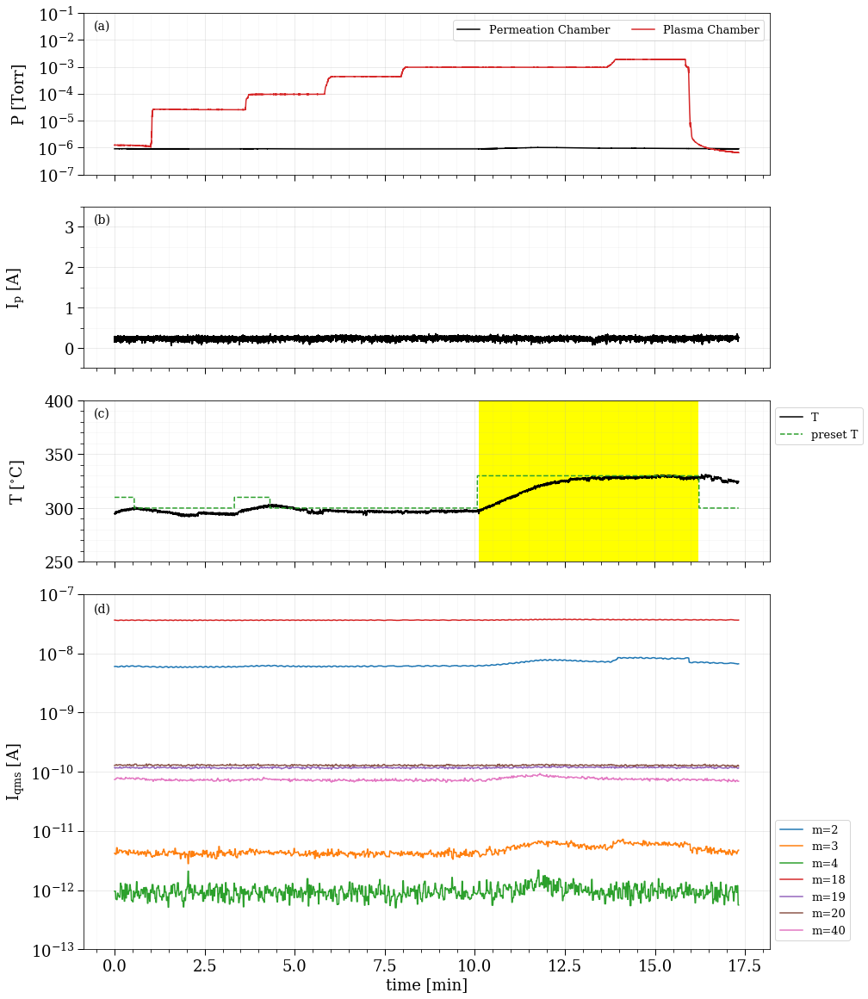

In [346]:
print('argon no plasma')
print(
    """
        普通に, フィラメント, 330℃, h２
    """
)
# import matplotlib.gridspec as gridspec

# range
fr = 6510
to = 7550
d_t = data_t[((data_t['time']>=fr) & (data_t['time']<=to))]
d = data[(data['time']>=fr) & (data['time']<=to)]
d_q = data_q[(data_q['time']>=fr) & (data_q['time']<=to)]

# convert
p2 = 10**(1.667*d['P2'] - 11.46) # 11.46 convert Pfeiffer signal to pressure
p1 = d['P1']*10**d['IGscale'] # convert linear IG signal to pressure

def iconv(v):
    return 5/1*(v-2.52)

ip = iconv(d['Ip'])-0.1

# plot
fig = gcf()
G = gridspec.GridSpec(5,1)
axs = [plt.subplot(G[0, 0]), plt.subplot(G[1, 0]), plt.subplot(G[2, 0]), plt.subplot(G[3:, 0])]

h = 20
w = h*15/21

fig.set_size_inches(w,h)
dt = 60

""" plot pressure """
ax = axs[0]
ax.plot(d['time']/dt - d['time'].iloc[0]/dt, p1, c='k', label='Permeation Chamber')
ax.plot(d['time']/dt - d['time'].iloc[0]/dt, p2, c='C3', label='Plasma Chamber')
# ax.plot(d['time']/dt, d['QMS_signal'])
ticks_visual(ax)
ax.set_yscale('log')
ax.set_ylim(1e-7, 1e-1)
ax.set_yticks(np.logspace(-7, -1, 7), minor=False)
# ax.yaxis.set_major_locator(FixedLocator(np.logspace(-7, -1, 4)))
# ax.yaxis.set_minor_locator(FixedLocator([1e-7, 1e-5, 1e-3]))
ax.tick_params(labelbottom=False)
ax.legend(loc=1, ncol = 2, bbox_to_anchor=[1., 0.99], fontsize=13)

""" plot plasma current """
ax = axs[1]
ax.plot(d['time']/dt - d['time'].iloc[0]/dt, ip,'k')
ticks_visual(ax)
ax.set_ylim(-0.5, 3.5)
ax.set_yticks(np.linspace(-0.5, 3.5, 9), minor=False)
ax.yaxis.set_major_locator(MultipleLocator(1))
ax.yaxis.set_minor_locator(MultipleLocator(0.5))
ax.tick_params(labelbottom=False)

""" plot temperature """
ax = axs[2]
ax.plot(d_t['time']/dt - d_t['time'].iloc[0]/dt, d_t['T'],  c='k', label='T')
ax.plot(d_t['time']/dt- d_t['time'].iloc[0]/dt, d_t['PresetT'],'C2--', label='preset T')
ticks_visual(ax)
ax.set_ylim(250,400)
ax.tick_params(labelbottom=False)
ax.legend(bbox_to_anchor=[1., 0.99], fontsize=13)

""" plot qms """
ax = axs[3]
ax.plot(d_q['time']/dt - d_q['time'].iloc[0]/dt, d_q['2'], label='m=2')
ax.plot(d_q['time']/dt - d_q['time'].iloc[0]/dt, d_q['3'], label='m=3')
ax.plot(d_q['time']/dt - d_q['time'].iloc[0]/dt, d_q['4'], label='m=4')
ax.plot(d_q['time']/dt - d_q['time'].iloc[0]/dt, d_q['18'], label='m=18')
ax.plot(d_q['time']/dt - d_q['time'].iloc[0]/dt, d_q['19'], label='m=19')
ax.plot(d_q['time']/dt - d_q['time'].iloc[0]/dt, d_q['20'], label='m=20')
ax.plot(d_q['time']/dt - d_q['time'].iloc[0]/dt, d_q['40'], label='m=40')
# ax.plot(d_q['time']/dt, d_q['analog_1'], c='C3', label='analog_1')
ax.set_yscale('log')
ax.set_ylim(1e-13, 1e-7)
ax.set_yticks(np.logspace(-13, -7, 7), minor=False)
ax.yaxis.set_major_locator(FixedLocator(np.logspace(-13, -7, 7)))
ax.legend(loc=1, bbox_to_anchor=[1.125, 0.38], fontsize=13)
ticks_visual(ax)

# # ar inflow
# ar_in = 1
# axs[0].axvline(ar_in, c='y')
# axs[1].axvline(ar_in, c='y')
# axs[2].axvline(ar_in, c='y')
# axs[3].axvline(ar_in, c='y')

# # cathode on
# cathode_on = ar_in + 15/60
# axs[0].axvline(cathode_on, c='y')
# axs[1].axvline(cathode_on, c='y')
# axs[2].axvline(cathode_on, c='y')
# axs[3].axvline(cathode_on, c='y')

# # plasma on
# plasma_on = 131.42
# axs[0].axvline(plasma_on, c='y')
# axs[1].axvline(plasma_on, c='y')
# axs[2].axvline(plasma_on, c='y')
# axs[3].axvline(plasma_on, c='y')

# # plasma off
# plasma_off = 134.67
# axs[0].axvline(plasma_off, c='y')
# axs[1].axvline(plasma_off, c='y')
# axs[2].axvline(plasma_off, c='y')
# axs[3].axvline(plasma_off, c='y')

# # ar outflow
# ar_out = 135.3
# axs[0].axvline(ar_out, c='y')
# axs[1].axvline(ar_out, c='y')
# axs[2].axvline(ar_out, c='y')
# axs[3].axvline(ar_out, c='y')

# # cathode off
# cathode_off = ar_out + 10/60
# axs[0].axvline(cathode_off, c='y')
# axs[1].axvline(cathode_off, c='y')
# axs[2].axvline(cathode_off, c='y')
# axs[3].axvline(cathode_off, c='y')

[grid_visual(ax) for ax in axs]
fig.align_ylabels()

axs[0].text(0.015, 0.9, '(a)', fontsize=14, transform=axs[0].transAxes)
axs[1].text(0.015, 0.9, '(b)', fontsize=14, transform=axs[1].transAxes)
axs[2].text(0.015, 0.9, '(c)', fontsize=14, transform=axs[2].transAxes)
axs[3].text(0.015, 0.95, '(d)', fontsize=14, transform=axs[3].transAxes)

lbls = ['P [Torr]','$I_p$ [A]','T [$^{\circ }$C]', '$I_{qms}$ [A]']
[ax.set_ylabel(l) for l,ax in zip(lbls,axs)]
axs[-1].set_xlabel('time [min]')
axs[2].axvspan(10.11, 16.2, color="yellow")
#[ax.set_xlim(0,145) for ax in axs]


#fig.savefig(join(bpth,'figures','24Jan_exp.pdf'),dpi = 300,bbox_inches='tight')
# fig.savefig(join(bpth,'figures','24Jan_baking.pdf'),dpi = 300,bbox_inches='tight')
# fig.savefig(join('./ar_d2_plasma_1.5A.pdf'),dpi = 300,bbox_inches='tight')
title = 'argon_no_plasma'
fig.savefig(join('./data/figure/{}.pdf'.format(title)),dpi = 300,bbox_inches='tight')
ss = d[d['time'] > 15*60+d['time'].iloc[0]]['P2'].iloc[0]
10**(1.667*ss - 11.46)

argon no plasma


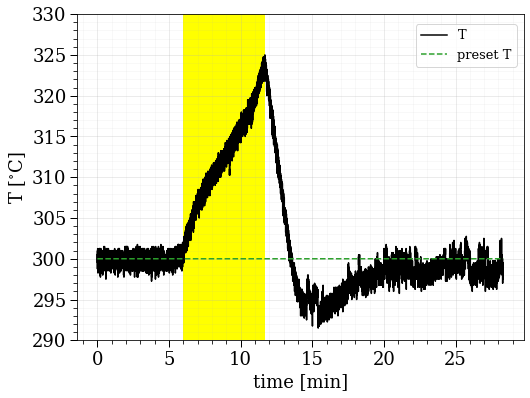

In [365]:
print('argon no plasma')
# import matplotlib.gridspec as gridspec

# range
fr = 300
to = 2000
d_t = data_t[((data_t['time']>=fr) & (data_t['time']<=to))]
d = data[(data['time']>=fr) & (data['time']<=to)]
d_q = data_q[(data_q['time']>=fr) & (data_q['time']<=to)]

# convert
p2 = 10**(1.667*d['P2'] - 11.46) # 11.46 convert Pfeiffer signal to pressure
p1 = d['P1']*10**d['IGscale'] # convert linear IG signal to pressure

def iconv(v):
    return 5/1*(v-2.52)

ip = iconv(d['Ip'])-0.1

# plot
fig = gcf()
G = gridspec.GridSpec(1,1)
axs = [plt.subplot(G[0, 0])]

h = 10
w = h*29.7/21

fig.set_size_inches(8,6)
dt = 60

# """ plot pressure """
# ax = axs[0]
# ax.plot(d['time']/dt - d['time'].iloc[0]/dt, p1, c='k', label='Permeation Chamber')
# ax.plot(d['time']/dt - d['time'].iloc[0]/dt, p2, c='C3', label='Plasma Chamber')
# # ax.plot(d['time']/dt, d['QMS_signal'])
# ticks_visual(ax)
# ax.set_yscale('log')
# ax.set_ylim(1e-8, 1e-2)
# ax.set_yticks(np.logspace(-8, -2, 7), minor=False)
# ax.yaxis.set_major_locator(FixedLocator(np.logspace(-8, -2, 4)))
# ax.yaxis.set_minor_locator(FixedLocator([1e-7, 1e-5, 1e-3]))
# ax.tick_params(labelbottom=False)
# ax.legend(loc=1, ncol = 2, bbox_to_anchor=[1., 1.4])

# """ plot plasma current """
# ax = axs[1]
# ax.plot(d['time']/dt - d['time'].iloc[0]/dt, ip,'k')
# ticks_visual(ax)
# ax.set_ylim(-0.5, 3.5)
# ax.set_yticks(np.linspace(-0.5, 3.5, 9), minor=False)
# ax.yaxis.set_major_locator(MultipleLocator(1))
# ax.yaxis.set_minor_locator(MultipleLocator(0.5))
# ax.tick_params(labelbottom=False)

""" plot temperature """
ax = axs[0]
ax.plot(d_t['time']/dt - d_t['time'].iloc[0]/dt, d_t['T'],  c='k', label='T')
ax.plot(d_t['time']/dt- d_t['time'].iloc[0]/dt, d_t['PresetT'],'C2--', label='preset T')
ticks_visual(ax)
ax.set_ylim(290, 330)
ax.legend(bbox_to_anchor=[1., 0.99], fontsize=13)

# """ plot qms """
# ax = axs[3]
# ax.plot(d_q['time']/dt - d_q['time'].iloc[0]/dt, d_q['2'], label='m=2')
# ax.plot(d_q['time']/dt - d_q['time'].iloc[0]/dt, d_q['3'], label='m=3')
# ax.plot(d_q['time']/dt - d_q['time'].iloc[0]/dt, d_q['4'], label='m=4')
# ax.plot(d_q['time']/dt - d_q['time'].iloc[0]/dt, d_q['18'], label='m=18')
# ax.plot(d_q['time']/dt - d_q['time'].iloc[0]/dt, d_q['19'], label='m=19')
# ax.plot(d_q['time']/dt - d_q['time'].iloc[0]/dt, d_q['20'], label='m=20')
# ax.plot(d_q['time']/dt - d_q['time'].iloc[0]/dt, d_q['40'], label='m=40')
# # ax.plot(d_q['time']/dt, d_q['analog_1'], c='C3', label='analog_1')
# ax.set_yscale('log')
# ax.set_ylim(1e-13, 1e-7)
# ax.set_yticks(np.logspace(-13, -7, 7), minor=False)
# ax.yaxis.set_major_locator(FixedLocator(np.logspace(-13, -7, 7)))
# ax.legend(loc=1, bbox_to_anchor=[1.13, 0.73], fontsize=13)
# ticks_visual(ax)

# # ar inflow
# ar_in = 1
# axs[0].axvline(ar_in, c='y')
# axs[1].axvline(ar_in, c='y')
# axs[2].axvline(ar_in, c='y')
# axs[3].axvline(ar_in, c='y')

# # cathode on
# cathode_on = ar_in + 15/60
# axs[0].axvline(cathode_on, c='y')
# axs[1].axvline(cathode_on, c='y')
# axs[2].axvline(cathode_on, c='y')
# axs[3].axvline(cathode_on, c='y')

# # plasma on
# plasma_on = 131.42
# axs[0].axvline(plasma_on, c='y')
# axs[1].axvline(plasma_on, c='y')
# axs[2].axvline(plasma_on, c='y')
# axs[3].axvline(plasma_on, c='y')

# # plasma off
# plasma_off = 134.67
# axs[0].axvline(plasma_off, c='y')
# axs[1].axvline(plasma_off, c='y')
# axs[2].axvline(plasma_off, c='y')
# axs[3].axvline(plasma_off, c='y')

# # ar outflow
# ar_out = 135.3
# axs[0].axvline(ar_out, c='y')
# axs[1].axvline(ar_out, c='y')
# axs[2].axvline(ar_out, c='y')
# axs[3].axvline(ar_out, c='y')

# # cathode off
# cathode_off = ar_out + 10/60
# axs[0].axvline(cathode_off, c='y')
# axs[1].axvline(cathode_off, c='y')
# axs[2].axvline(cathode_off, c='y')
# axs[3].axvline(cathode_off, c='y')

ax.axvspan(6, 11.6, color="yellow")

[grid_visual(ax) for ax in axs]
fig.align_ylabels()

# axs[0].text(0.1, 0.94, '(a)', fontsize=14, transform=axs[0].transAxes)
# axs[0].text(0.31, 0.94, '(b)', fontsize=14, transform=axs[0].transAxes)
# axs[1].text(0.015, 0.8, '(b)', fontsize=14, transform=axs[1].transAxes)
# axs[2].text(0.015, 0.8, '(c)', fontsize=14, transform=axs[2].transAxes)
# axs[3].text(0.015, 0.9, '(d)', fontsize=14, transform=axs[3].transAxes)

lbls = ['T [$^{\circ }$C]', '$I_{qms}$ [A]']
[ax.set_ylabel(l) for l,ax in zip(lbls,axs)]
axs[-1].set_xlabel('time [min]')
#[ax.set_xlim(0,145) for ax in axs]

#fig.savefig(join(bpth,'figures','24Jan_exp.pdf'),dpi = 300,bbox_inches='tight')
# fig.savefig(join(bpth,'figures','24Jan_baking.pdf'),dpi = 300,bbox_inches='tight')
# fig.savefig(join('./ar_d2_plasma_1.5A.pdf'),dpi = 300,bbox_inches='tight')
title = 'plasma_no_plasma_temperature1A'
fig.savefig(join('./data/figure/{}.png'.format(title)),dpi = 300,bbox_inches='tight')
# ss = d[d['time'] > 15*60+d['time'].iloc[0]]['P2'].iloc[0]
# 10**(1.667*ss - 11.46)

argon no plasma


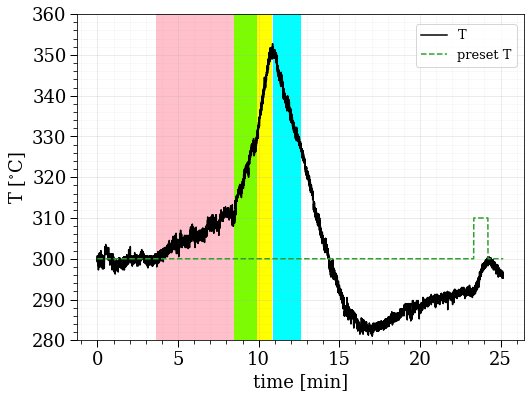

In [366]:
print('argon no plasma')
# import matplotlib.gridspec as gridspec

# range
fr = 5090
to = 6600
d_t = data_t[((data_t['time']>=fr) & (data_t['time']<=to))]
d = data[(data['time']>=fr) & (data['time']<=to)]
d_q = data_q[(data_q['time']>=fr) & (data_q['time']<=to)]

# convert
p2 = 10**(1.667*d['P2'] - 11.46) # 11.46 convert Pfeiffer signal to pressure
p1 = d['P1']*10**d['IGscale'] # convert linear IG signal to pressure

def iconv(v):
    return 5/1*(v-2.52)

ip = iconv(d['Ip'])-0.1

# plot
fig = gcf()
G = gridspec.GridSpec(1,1)
axs = [plt.subplot(G[0, 0])]

h = 10
w = h*29.7/21

fig.set_size_inches(8,6)
dt = 60

# """ plot pressure """
# ax = axs[0]
# ax.plot(d['time']/dt - d['time'].iloc[0]/dt, p1, c='k', label='Permeation Chamber')
# ax.plot(d['time']/dt - d['time'].iloc[0]/dt, p2, c='C3', label='Plasma Chamber')
# # ax.plot(d['time']/dt, d['QMS_signal'])
# ticks_visual(ax)
# ax.set_yscale('log')
# ax.set_ylim(1e-8, 1e-2)
# ax.set_yticks(np.logspace(-8, -2, 7), minor=False)
# ax.yaxis.set_major_locator(FixedLocator(np.logspace(-8, -2, 4)))
# ax.yaxis.set_minor_locator(FixedLocator([1e-7, 1e-5, 1e-3]))
# ax.tick_params(labelbottom=False)
# ax.legend(loc=1, ncol = 2, bbox_to_anchor=[1., 1.4])

# """ plot plasma current """
# ax = axs[1]
# ax.plot(d['time']/dt - d['time'].iloc[0]/dt, ip,'k')
# ticks_visual(ax)
# ax.set_ylim(-0.5, 3.5)
# ax.set_yticks(np.linspace(-0.5, 3.5, 9), minor=False)
# ax.yaxis.set_major_locator(MultipleLocator(1))
# ax.yaxis.set_minor_locator(MultipleLocator(0.5))
# ax.tick_params(labelbottom=False)

""" plot temperature """
ax = axs[0]
ax.plot(d_t['time']/dt - d_t['time'].iloc[0]/dt, d_t['T'],  c='k', label='T')
ax.plot(d_t['time']/dt- d_t['time'].iloc[0]/dt, d_t['PresetT'],'C2--', label='preset T')
ticks_visual(ax)
ax.set_ylim(280, 360)
ax.legend(bbox_to_anchor=[1., 0.99], fontsize=13)


# """ plot qms """
# ax = axs[3]
# ax.plot(d_q['time']/dt - d_q['time'].iloc[0]/dt, d_q['2'], label='m=2')
# ax.plot(d_q['time']/dt - d_q['time'].iloc[0]/dt, d_q['3'], label='m=3')
# ax.plot(d_q['time']/dt - d_q['time'].iloc[0]/dt, d_q['4'], label='m=4')
# ax.plot(d_q['time']/dt - d_q['time'].iloc[0]/dt, d_q['18'], label='m=18')
# ax.plot(d_q['time']/dt - d_q['time'].iloc[0]/dt, d_q['19'], label='m=19')
# ax.plot(d_q['time']/dt - d_q['time'].iloc[0]/dt, d_q['20'], label='m=20')
# ax.plot(d_q['time']/dt - d_q['time'].iloc[0]/dt, d_q['40'], label='m=40')
# # ax.plot(d_q['time']/dt, d_q['analog_1'], c='C3', label='analog_1')
# ax.set_yscale('log')
# ax.set_ylim(1e-13, 1e-7)
# ax.set_yticks(np.logspace(-13, -7, 7), minor=False)
# ax.yaxis.set_major_locator(FixedLocator(np.logspace(-13, -7, 7)))
# ax.legend(loc=1, bbox_to_anchor=[1.13, 0.73], fontsize=13)
# ticks_visual(ax)

# # ar inflow
# ar_in = 1
# axs[0].axvline(ar_in, c='y')
# axs[1].axvline(ar_in, c='y')
# axs[2].axvline(ar_in, c='y')
# axs[3].axvline(ar_in, c='y')

# # cathode on
# cathode_on = ar_in + 15/60
# axs[0].axvline(cathode_on, c='y')
# axs[1].axvline(cathode_on, c='y')
# axs[2].axvline(cathode_on, c='y')
# axs[3].axvline(cathode_on, c='y')

# # plasma on
# plasma_on = 131.42
# axs[0].axvline(plasma_on, c='y')
# axs[1].axvline(plasma_on, c='y')
# axs[2].axvline(plasma_on, c='y')
# axs[3].axvline(plasma_on, c='y')

# # plasma off
# plasma_off = 134.67
# axs[0].axvline(plasma_off, c='y')
# axs[1].axvline(plasma_off, c='y')
# axs[2].axvline(plasma_off, c='y')
# axs[3].axvline(plasma_off, c='y')

# # ar outflow
# ar_out = 135.3
# axs[0].axvline(ar_out, c='y')
# axs[1].axvline(ar_out, c='y')
# axs[2].axvline(ar_out, c='y')
# axs[3].axvline(ar_out, c='y')

# # cathode off
# cathode_off = ar_out + 10/60
# axs[0].axvline(cathode_off, c='y')
# axs[1].axvline(cathode_off, c='y')
# axs[2].axvline(cathode_off, c='y')
# axs[3].axvline(cathode_off, c='y')

ax.axvspan(3.646, 8.4965, color="pink")
ax.axvspan(8.4965, 9.866, color="lawngreen")
ax.axvspan(9.866, 10.766, color="yellow")
ax.axvspan(10.866, 12.58, color="cyan")

[grid_visual(ax) for ax in axs]
fig.align_ylabels()

# axs[0].text(0.243, 0.95, '(a)', fontsize=14, transform=axs[0].transAxes)
# axs[0].text(0.353, 0.95, '(b)', fontsize=14, transform=axs[0].transAxes)
# axs[0].text(0.399, 0.95, '(c)', fontsize=14, transform=axs[0].transAxes)
# axs[0].text(0.446, 0.95, '(d)', fontsize=14, transform=axs[0].transAxes)
# axs[1].text(0.015, 0.8, '(b)', fontsize=14, transform=axs[1].transAxes)
# axs[2].text(0.015, 0.8, '(c)', fontsize=14, transform=axs[2].transAxes)
# axs[3].text(0.015, 0.9, '(d)', fontsize=14, transform=axs[3].transAxes)

lbls = ['T [$^{\circ }$C]', '$I_{qms}$ [A]']
[ax.set_ylabel(l) for l,ax in zip(lbls,axs)]
axs[-1].set_xlabel('time [min]')
#[ax.set_xlim(0,145) for ax in axs]
'''
3.6465530666666695
8.496553066666664
9.866553066666668
10.76655306666666
12.586553066666667
'''
#fig.savefig(join(bpth,'figures','24Jan_exp.pdf'),dpi = 300,bbox_inches='tight')
# fig.savefig(join(bpth,'figures','24Jan_baking.pdf'),dpi = 300,bbox_inches='tight')
# fig.savefig(join('./ar_d2_plasma_1.5A.pdf'),dpi = 300,bbox_inches='tight')
title = 'plasma_no_plasma_temperature3A'
fig.savefig(join('./data/figure/{}.png'.format(title)),dpi = 300,bbox_inches='tight')
# ss = d[d['time'] > 15*60+d['time'].iloc[0]]['P2'].iloc[0]
# 10**(1.667*ss - 11.46)

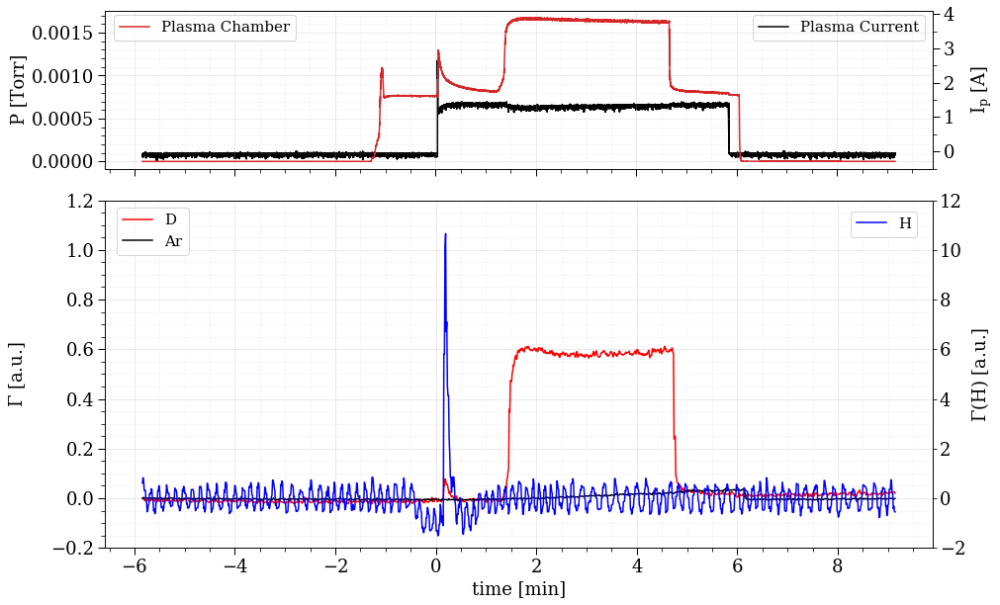

In [463]:
# range
fr = 300
to = 1200
d_t = data_t[((data_t['time']>=fr) & (data_t['time']<=to))]
d = data[(data['time']>=fr) & (data['time']<=to)]
d_q = data_q[(data_q['time']>=fr) & (data_q['time']<=to)]

# convert
p2 = 10**(1.667*d['P2'] - 11.46) # 11.46 convert Pfeiffer signal to pressure
p1 = d['P1']*10**d['IGscale'] # convert linear IG signal to pressure

def iconv(v):
    return 5/1*(v-2.52)

ip = iconv(d['Ip'])-0.1

# plot
fig = gcf()
G = gridspec.GridSpec(3,1)
axs = [plt.subplot(G[0, 0]), plt.subplot(G[1:, 0])]

h = 10
w = 15
fig.set_size_inches(w,h)
dt = 60

""" plot pressure """
ax = axs[0]
# ax.plot(d['time']/dt - d['time'].iloc[0]/dt, p1, c='k', label='Permeation Chamber')
ax.plot(d['time']/dt - d['time'].iloc[0]/dt-5.84, p2, c='C3', label='Plasma Chamber')
# ax.plot(d['time']/dt, d['QMS_signal'])
ticks_visual(ax)
# ax.set_yscale('log')
# ax.set_ylim(1e-5, 0.0025)
# ax.set_yticks(np.logspace(-7, -1, 7), minor=False)
# ax.yaxis.set_major_locator(FixedLocator(np.logspace(-7, -1, 4)))
# ax.yaxis.set_minor_locator(FixedLocator([1e-7, 1e-5, 1e-3]))
ax.tick_params(labelbottom=False)
ax.legend(loc=1, bbox_to_anchor=[0.24, 1.02], fontsize=15)

""" plot plasma current """
ax2 = ax.twinx()
ax2.plot(d['time']/dt - d['time'].iloc[0]/dt - 5.84, ip,'k', label=r'Plasma Current')
ticks_visual(ax2)
ax2.set_ylim(-0.1, 4.1)
ax2.set_yticks(np.linspace(-0.5, 3.5, 9), minor=False)
ax2.yaxis.set_major_locator(MultipleLocator(1))
ax2.yaxis.set_minor_locator(MultipleLocator(0.5))
ax2.tick_params(labelbottom=False)

ax2.set_ylabel('$I_{p}$ [A]')
ax2.legend(loc=1, bbox_to_anchor=[1., 1.02], fontsize=15)

ax.set_zorder(2)
ax2.set_zorder(1)
ax.patch.set_alpha(0)

""" plot qms """
ax = axs[1]
ax2 = ax.twinx()
h2 = 2*(d_q['2']-d_q['2'].iloc[0]) + d_q['3']-d_q['3'].iloc[0] + 2*(d_q['18']-d_q['18'].iloc[0]) + d_q['19']-d_q['19'].iloc[0]
d2 = d_q['3']-d_q['3'].iloc[0] + 2*(d_q['4']-d_q['4'].iloc[0]) + d_q['19']-d_q['19'].iloc[0] + 2*(d_q['20']-d_q['20'].iloc[0])
ar = d_q['40']-d_q['40'].iloc[0]
h2_base = savitzky_golay(h2, 100, 1)
h2 -= h2_base

h2/=1e-9
d2/=1e-9
ar/=1e-9

ax2.plot(d_q['time']/dt - d_q['time'].iloc[0]/dt-5.84, h2, label=r"H", c='b', alpha=1)
ax.plot(d_q['time']/dt - d_q['time'].iloc[0]/dt-5.84, d2, label=r"D", c='r', alpha=1)
ax.plot(d_q['time']/dt - d_q['time'].iloc[0]/dt-5.84, ar, label=r"Ar", c='k', alpha=1)
# ax.plot(d_q['time']/dt, d_q['analog_1'], c='C3', label='analog_1')
# ax.set_yscale('log')
ax.set_ylim(-0.2, 1.2)
ax2.set_ylim(-2, 12)
# ax.set_yticks(np.logspace(-13, -7, 7), minor=False)
# ax.yaxis.set_major_locator(FixedLocator(np.logspace(-13, -7, 7)))
ax.legend(loc=1, bbox_to_anchor=[0.11, 1], fontsize=15)
ax2.legend(loc=1, bbox_to_anchor=[0.99, 0.99], fontsize=15)
ticks_visual(ax)

[grid_visual(ax) for ax in axs]
fig.align_ylabels()

lbls = ['P [Torr]','$\Gamma$ [a.u.]']
[ax.set_ylabel(l) for l,ax in zip(lbls,axs)]
axs[-1].set_xlabel('time [min]')
#[ax.set_xlim(0,145) for ax in axs]
ax2.set_ylabel('$\Gamma(H)$ [a.u.]')

[ax.set_rasterized(True) for ax in axs]

title = 'argond2_plasma_slide'
# fig.savefig(join('./data/figure/{}.pdf'.format(title)),dpi = 300,bbox_inches='tight')
fig.savefig(join('./data/figure/{}.png'.format(title)),dpi = 300,bbox_inches='tight')

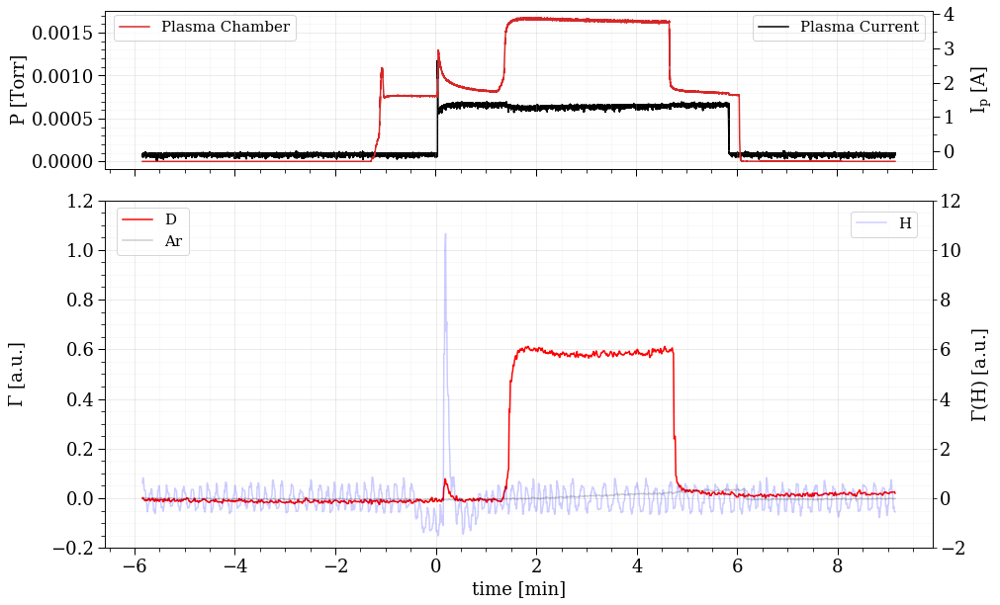

In [464]:
# range
fr = 300
to = 1200
d_t = data_t[((data_t['time']>=fr) & (data_t['time']<=to))]
d = data[(data['time']>=fr) & (data['time']<=to)]
d_q = data_q[(data_q['time']>=fr) & (data_q['time']<=to)]

# convert
p2 = 10**(1.667*d['P2'] - 11.46) # 11.46 convert Pfeiffer signal to pressure
p1 = d['P1']*10**d['IGscale'] # convert linear IG signal to pressure

def iconv(v):
    return 5/1*(v-2.52)

ip = iconv(d['Ip'])-0.1

# plot
fig = gcf()
G = gridspec.GridSpec(3,1)
axs = [plt.subplot(G[0, 0]), plt.subplot(G[1:, 0])]

h = 10
w = 15
fig.set_size_inches(w,h)
dt = 60

""" plot pressure """
ax = axs[0]
# ax.plot(d['time']/dt - d['time'].iloc[0]/dt, p1, c='k', label='Permeation Chamber')
ax.plot(d['time']/dt - d['time'].iloc[0]/dt-5.84, p2, c='C3', label='Plasma Chamber')
# ax.plot(d['time']/dt, d['QMS_signal'])
ticks_visual(ax)
# ax.set_yscale('log')
# ax.set_ylim(1e-5, 0.0025)
# ax.set_yticks(np.logspace(-7, -1, 7), minor=False)
# ax.yaxis.set_major_locator(FixedLocator(np.logspace(-7, -1, 4)))
# ax.yaxis.set_minor_locator(FixedLocator([1e-7, 1e-5, 1e-3]))
ax.tick_params(labelbottom=False)
ax.legend(loc=1, bbox_to_anchor=[0.24, 1.02], fontsize=15)

""" plot plasma current """
ax2 = ax.twinx()
ax2.plot(d['time']/dt - d['time'].iloc[0]/dt - 5.84, ip,'k', label=r'Plasma Current')
ticks_visual(ax2)
ax2.set_ylim(-0.1, 4.1)
ax2.set_yticks(np.linspace(-0.5, 3.5, 9), minor=False)
ax2.yaxis.set_major_locator(MultipleLocator(1))
ax2.yaxis.set_minor_locator(MultipleLocator(0.5))
ax2.tick_params(labelbottom=False)

ax2.set_ylabel('$I_{p}$ [A]')
ax2.legend(loc=1, bbox_to_anchor=[1., 1.02], fontsize=15)

ax.set_zorder(2)
ax2.set_zorder(1)
ax.patch.set_alpha(0)

""" plot qms """
ax = axs[1]
ax2 = ax.twinx()
h2 = 2*(d_q['2']-d_q['2'].iloc[0]) + d_q['3']-d_q['3'].iloc[0] + 2*(d_q['18']-d_q['18'].iloc[0]) + d_q['19']-d_q['19'].iloc[0]
d2 = d_q['3']-d_q['3'].iloc[0] + 2*(d_q['4']-d_q['4'].iloc[0]) + d_q['19']-d_q['19'].iloc[0] + 2*(d_q['20']-d_q['20'].iloc[0])
ar = d_q['40']-d_q['40'].iloc[0]
h2_base = savitzky_golay(h2, 100, 1)
h2 -= h2_base

h2/=1e-9
d2/=1e-9
ar/=1e-9

ax2.plot(d_q['time']/dt - d_q['time'].iloc[0]/dt-5.84, h2, label=r"H", c='b', alpha=0.2)
ax.plot(d_q['time']/dt - d_q['time'].iloc[0]/dt-5.84, d2, label=r"D", c='r', alpha=1)
ax.plot(d_q['time']/dt - d_q['time'].iloc[0]/dt-5.84, ar, label=r"Ar", c='k', alpha=0.2)
# ax.plot(d_q['time']/dt, d_q['analog_1'], c='C3', label='analog_1')
# ax.set_yscale('log')
ax.set_ylim(-0.2, 1.2)
ax2.set_ylim(-2, 12)
# ax.set_yticks(np.logspace(-13, -7, 7), minor=False)
# ax.yaxis.set_major_locator(FixedLocator(np.logspace(-13, -7, 7)))
ax.legend(loc=1, bbox_to_anchor=[0.11, 1], fontsize=15)
ax2.legend(loc=1, bbox_to_anchor=[0.99, 0.99], fontsize=15)
ticks_visual(ax)

[grid_visual(ax) for ax in axs]
fig.align_ylabels()

lbls = ['P [Torr]','$\Gamma$ [a.u.]']
[ax.set_ylabel(l) for l,ax in zip(lbls,axs)]
axs[-1].set_xlabel('time [min]')
#[ax.set_xlim(0,145) for ax in axs]
ax2.set_ylabel('$\Gamma(H)$ [a.u.]')

[ax.set_rasterized(True) for ax in axs]

# ax.axvspan(0, 11.7-5.84, color="yellow", alpha=0.6)
#fig.savefig(join(bpth,'figures','24Jan_exp.pdf'),dpi = 300,bbox_inches='tight')
# fig.savefig(join(bpth,'figures','24Jan_baking.pdf'),dpi = 300,bbox_inches='tight')
# fig.savefig(join('./ar_d2_plasma_1.5A.pdf'),dpi = 300,bbox_inches='tight')
title = 'argond2_plasma_slide2'
# fig.savefig(join('./data/figure/{}.pdf'.format(title)),dpi = 300,bbox_inches='tight')
fig.savefig(join('./data/figure/{}.png'.format(title)),dpi = 300,bbox_inches='tight')

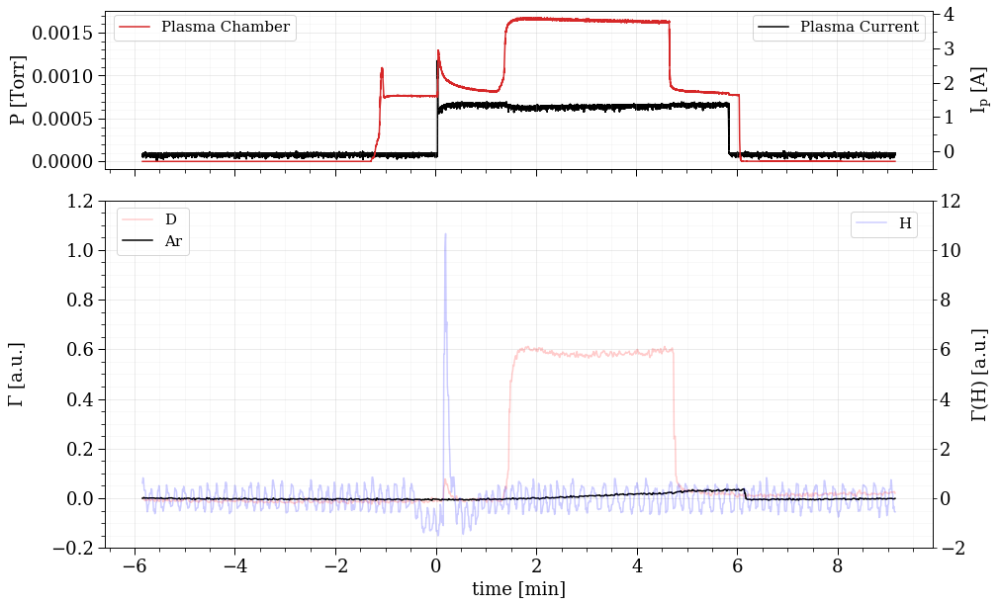

In [465]:
# range
fr = 300
to = 1200
d_t = data_t[((data_t['time']>=fr) & (data_t['time']<=to))]
d = data[(data['time']>=fr) & (data['time']<=to)]
d_q = data_q[(data_q['time']>=fr) & (data_q['time']<=to)]

# convert
p2 = 10**(1.667*d['P2'] - 11.46) # 11.46 convert Pfeiffer signal to pressure
p1 = d['P1']*10**d['IGscale'] # convert linear IG signal to pressure

def iconv(v):
    return 5/1*(v-2.52)

ip = iconv(d['Ip'])-0.1

# plot
fig = gcf()
G = gridspec.GridSpec(3,1)
axs = [plt.subplot(G[0, 0]), plt.subplot(G[1:, 0])]

h = 10
w = 15
fig.set_size_inches(w,h)
dt = 60

""" plot pressure """
ax = axs[0]
# ax.plot(d['time']/dt - d['time'].iloc[0]/dt, p1, c='k', label='Permeation Chamber')
ax.plot(d['time']/dt - d['time'].iloc[0]/dt-5.84, p2, c='C3', label='Plasma Chamber')
# ax.plot(d['time']/dt, d['QMS_signal'])
ticks_visual(ax)
# ax.set_yscale('log')
# ax.set_ylim(1e-5, 0.0025)
# ax.set_yticks(np.logspace(-7, -1, 7), minor=False)
# ax.yaxis.set_major_locator(FixedLocator(np.logspace(-7, -1, 4)))
# ax.yaxis.set_minor_locator(FixedLocator([1e-7, 1e-5, 1e-3]))
ax.tick_params(labelbottom=False)
ax.legend(loc=1, bbox_to_anchor=[0.24, 1.02], fontsize=15)

""" plot plasma current """
ax2 = ax.twinx()
ax2.plot(d['time']/dt - d['time'].iloc[0]/dt - 5.84, ip,'k', label=r'Plasma Current')
ticks_visual(ax2)
ax2.set_ylim(-0.1, 4.1)
ax2.set_yticks(np.linspace(-0.5, 3.5, 9), minor=False)
ax2.yaxis.set_major_locator(MultipleLocator(1))
ax2.yaxis.set_minor_locator(MultipleLocator(0.5))
ax2.tick_params(labelbottom=False)

ax2.set_ylabel('$I_{p}$ [A]')
ax2.legend(loc=1, bbox_to_anchor=[1.0, 1.02], fontsize=15)

ax.set_zorder(2)
ax2.set_zorder(1)
ax.patch.set_alpha(0)

""" plot qms """
ax = axs[1]
ax2 = ax.twinx()
h2 = 2*(d_q['2']-d_q['2'].iloc[0]) + d_q['3']-d_q['3'].iloc[0] + 2*(d_q['18']-d_q['18'].iloc[0]) + d_q['19']-d_q['19'].iloc[0]
d2 = d_q['3']-d_q['3'].iloc[0] + 2*(d_q['4']-d_q['4'].iloc[0]) + d_q['19']-d_q['19'].iloc[0] + 2*(d_q['20']-d_q['20'].iloc[0])
ar = d_q['40']-d_q['40'].iloc[0]
h2_base = savitzky_golay(h2, 100, 1)
h2 -= h2_base

h2/=1e-9
d2/=1e-9
ar/=1e-9

ax2.plot(d_q['time']/dt - d_q['time'].iloc[0]/dt-5.84, h2, label=r"H", c='b', alpha=0.2)
ax.plot(d_q['time']/dt - d_q['time'].iloc[0]/dt-5.84, d2, label=r"D", c='r', alpha=0.2)
ax.plot(d_q['time']/dt - d_q['time'].iloc[0]/dt-5.84, ar, label=r"Ar", c='k', alpha=1)
# ax.plot(d_q['time']/dt, d_q['analog_1'], c='C3', label='analog_1')
# ax.set_yscale('log')
ax.set_ylim(-0.2, 1.2)
ax2.set_ylim(-2, 12)
# ax.set_yticks(np.logspace(-13, -7, 7), minor=False)
# ax.yaxis.set_major_locator(FixedLocator(np.logspace(-13, -7, 7)))
ax.legend(loc=1, bbox_to_anchor=[0.11, 1], fontsize=15)
ax2.legend(loc=1, bbox_to_anchor=[0.99, 0.99], fontsize=15)
ticks_visual(ax)

[grid_visual(ax) for ax in axs]
fig.align_ylabels()

lbls = ['P [Torr]','$\Gamma$ [a.u.]']
[ax.set_ylabel(l) for l,ax in zip(lbls,axs)]
axs[-1].set_xlabel('time [min]')
#[ax.set_xlim(0,145) for ax in axs]
ax2.set_ylabel('$\Gamma(H)$ [a.u.]')

[ax.set_rasterized(True) for ax in axs]

# ax.axvspan(0, 11.7-5.84, color="yellow", alpha=0.6)
#fig.savefig(join(bpth,'figures','24Jan_exp.pdf'),dpi = 300,bbox_inches='tight')
# fig.savefig(join(bpth,'figures','24Jan_baking.pdf'),dpi = 300,bbox_inches='tight')
# fig.savefig(join('./ar_d2_plasma_1.5A.pdf'),dpi = 300,bbox_inches='tight')
title = 'argond2_plasma_slide3'
# fig.savefig(join('./data/figure/{}.pdf'.format(title)),dpi = 300,bbox_inches='tight')
fig.savefig(join('./data/figure/{}.png'.format(title)),dpi = 300,bbox_inches='tight')

d2 no plasma


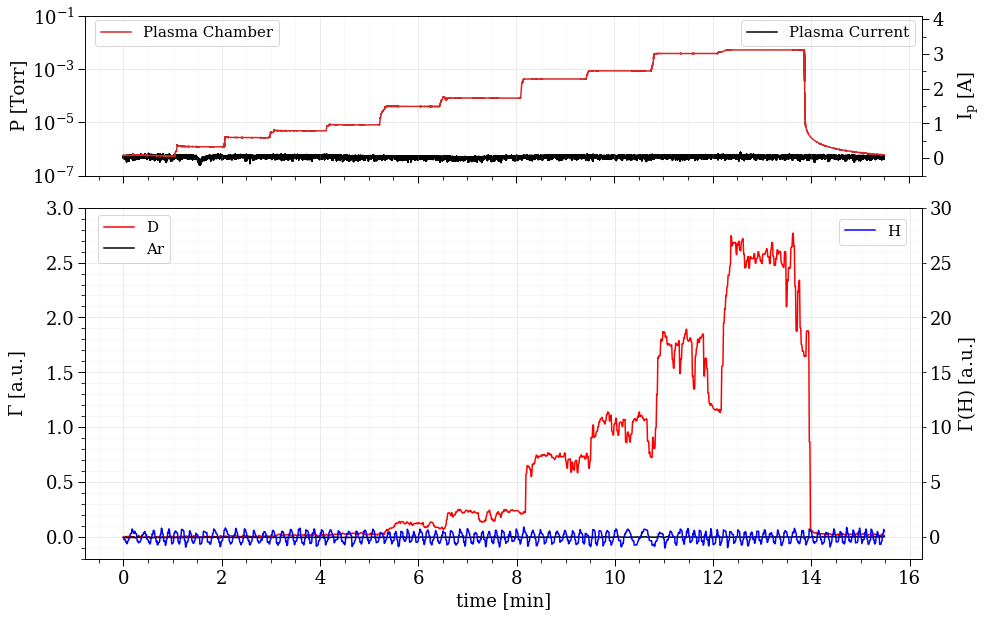

In [466]:
print('d2 no plasma')

# range
fr = 2070
to = 3000
d_t = data_t[((data_t['time']>=fr) & (data_t['time']<=to))]
d = data[(data['time']>=fr) & (data['time']<=to)]
d_q = data_q[(data_q['time']>=fr) & (data_q['time']<=to)]

# convert
p2 = 10**(1.667*d['P2'] - 11.46) # 11.46 convert Pfeiffer signal to pressure
p1 = d['P1']*10**d['IGscale'] # convert linear IG signal to pressure

def iconv(v):
    return 5/1*(v-2.52)

ip = iconv(d['Ip'])-0.1

# plot
fig = gcf()
G = gridspec.GridSpec(3,1)
axs = [plt.subplot(G[0, 0]), plt.subplot(G[1:, 0])]

h = 10
w = 15
fig.set_size_inches(w,h)
dt = 60

""" plot pressure """
ax = axs[0]
# ax.plot(d['time']/dt - d['time'].iloc[0]/dt, p1, c='k', label='Permeation Chamber')
ax.plot(d['time']/dt - d['time'].iloc[0]/dt, p2, c='C3', label='Plasma Chamber')
# ax.plot(d['time']/dt, d['QMS_signal'])
ticks_visual(ax)
ax.set_yscale('log')
ax.set_ylim(1e-7, 1e-1)
ax.set_yticks(np.logspace(-7, -1, 7), minor=False)
ax.yaxis.set_major_locator(FixedLocator(np.logspace(-7, -1, 4)))
# ax.yaxis.set_minor_locator(FixedLocator([1e-7, 1e-5, 1e-3]))
ax.tick_params(labelbottom=False)
ax.legend(loc=1, bbox_to_anchor=[0.24, 1.02], fontsize=15)


""" plot plasma current """
ax2 = ax.twinx()
ax2.plot(d['time']/dt - d['time'].iloc[0]/dt, ip,'k', label=r'Plasma Current')
ticks_visual(ax2)
ax2.set_ylim(-0.1, 4.1)
ax2.set_yticks(np.linspace(-0.5, 3.5, 9), minor=False)
ax2.yaxis.set_major_locator(MultipleLocator(1))
ax2.yaxis.set_minor_locator(MultipleLocator(0.5))
ax2.tick_params(labelbottom=False)

ax2.set_ylabel('$I_{p}$ [A]')
ax2.legend(loc=1, bbox_to_anchor=[1.0, 1.02], fontsize=15)

ax.set_zorder(2)
ax2.set_zorder(1)
ax.patch.set_alpha(0)

""" plot qms """
ax = axs[1]
ax2 = ax.twinx()
h2 = 2*(d_q['2']-d_q['2'].iloc[0]) + d_q['3']-d_q['3'].iloc[0] + 2*(d_q['18']-d_q['18'].iloc[0]) + d_q['19']-d_q['19'].iloc[0]
d2 = d_q['3']-d_q['3'].iloc[0] + 2*(d_q['4']-d_q['4'].iloc[0]) + d_q['19']-d_q['19'].iloc[0] + 2*(d_q['20']-d_q['20'].iloc[0])
ar = d_q['40']-d_q['40'].iloc[0]
h2_base = savitzky_golay(h2, 100, 1)
h2 -= h2_base

h2/=1e-9
d2/=1e-9
ar/=1e-9

ax2.plot(d_q['time']/dt - d_q['time'].iloc[0]/dt, h2, label=r"H", c='b', alpha=1)
ax.plot(d_q['time']/dt - d_q['time'].iloc[0]/dt, d2, label=r"D", c='r', alpha=1)
ax.plot(d_q['time']/dt - d_q['time'].iloc[0]/dt, ar, label=r"Ar", c='k', alpha=1)
# ax.plot(d_q['time']/dt, d_q['analog_1'], c='C3', label='analog_1')
# ax.set_yscale('log')
ax.set_ylim(-0.2, 3)
ax2.set_ylim(-2, 30)
# ax.set_yticks(np.logspace(-13, -7, 7), minor=False)
# ax.yaxis.set_major_locator(FixedLocator(np.logspace(-13, -7, 7)))
ax.legend(loc=1, bbox_to_anchor=[0.11, 1], fontsize=15)
ax2.legend(loc=1, bbox_to_anchor=[0.99, 0.99], fontsize=15)
ticks_visual(ax)

[grid_visual(ax) for ax in axs]
fig.align_ylabels()

lbls = ['P [Torr]','$\Gamma$ [a.u.]']
[ax.set_ylabel(l) for l,ax in zip(lbls,axs)]
axs[-1].set_xlabel('time [min]')
#[ax.set_xlim(0,145) for ax in axs]
ax2.set_ylabel('$\Gamma(H)$ [a.u.]')
[ax.set_rasterized(True) for ax in axs]
#fig.savefig(join(bpth,'figures','24Jan_exp.pdf'),dpi = 300,bbox_inches='tight')
# fig.savefig(join(bpth,'figures','24Jan_baking.pdf'),dpi = 300,bbox_inches='tight')
# fig.savefig(join('./ar_d2_plasma_1.5A.pdf'),dpi = 300,bbox_inches='tight')
title = 'D2_no_plasma_slide'
# fig.savefig(join('./data/figure/{}.pdf'.format(title)),dpi = 300,bbox_inches='tight')
fig.savefig(join('./data/figure/{}.png'.format(title)),dpi = 300,bbox_inches='tight')

d2 no plasma


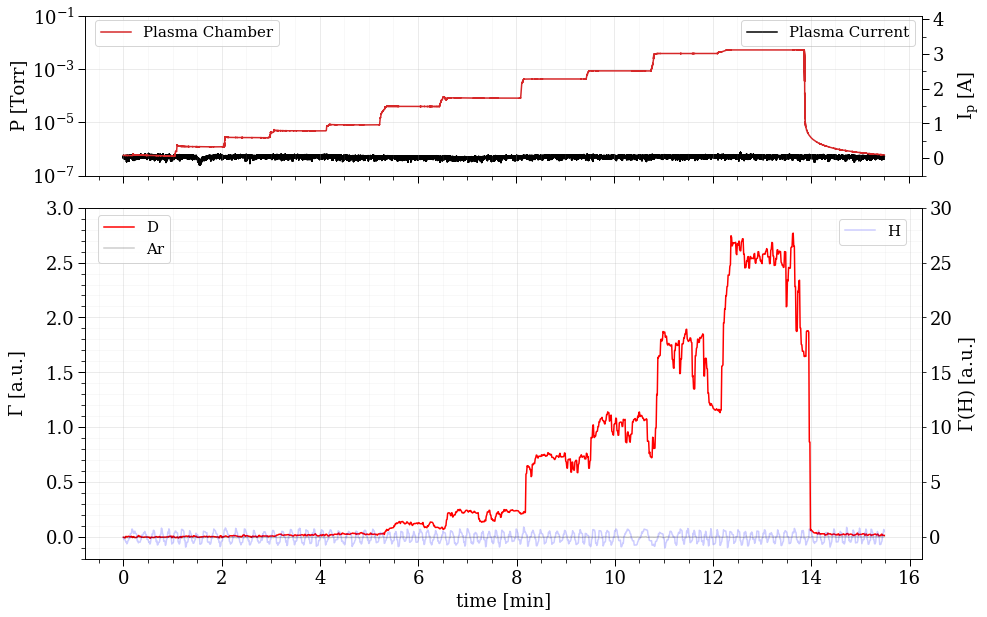

In [467]:
print('d2 no plasma')

# range
fr = 2070
to = 3000
d_t = data_t[((data_t['time']>=fr) & (data_t['time']<=to))]
d = data[(data['time']>=fr) & (data['time']<=to)]
d_q = data_q[(data_q['time']>=fr) & (data_q['time']<=to)]

# convert
p2 = 10**(1.667*d['P2'] - 11.46) # 11.46 convert Pfeiffer signal to pressure
p1 = d['P1']*10**d['IGscale'] # convert linear IG signal to pressure

def iconv(v):
    return 5/1*(v-2.52)

ip = iconv(d['Ip'])-0.1

# plot
fig = gcf()
G = gridspec.GridSpec(3,1)
axs = [plt.subplot(G[0, 0]), plt.subplot(G[1:, 0])]

h = 10
w = 15
fig.set_size_inches(w,h)
dt = 60

""" plot pressure """
ax = axs[0]
# ax.plot(d['time']/dt - d['time'].iloc[0]/dt, p1, c='k', label='Permeation Chamber')
ax.plot(d['time']/dt - d['time'].iloc[0]/dt, p2, c='C3', label='Plasma Chamber')
# ax.plot(d['time']/dt, d['QMS_signal'])
ticks_visual(ax)
ax.set_yscale('log')
ax.set_ylim(1e-7, 1e-1)
ax.set_yticks(np.logspace(-7, -1, 7), minor=False)
ax.yaxis.set_major_locator(FixedLocator(np.logspace(-7, -1, 4)))
# ax.yaxis.set_minor_locator(FixedLocator([1e-7, 1e-5, 1e-3]))
ax.tick_params(labelbottom=False)
ax.legend(loc=1, bbox_to_anchor=[0.24, 1.02], fontsize=15)


""" plot plasma current """
ax2 = ax.twinx()
ax2.plot(d['time']/dt - d['time'].iloc[0]/dt, ip,'k', label=r'Plasma Current')
ticks_visual(ax2)
ax2.set_ylim(-0.1, 4.1)
ax2.set_yticks(np.linspace(-0.5, 3.5, 9), minor=False)
ax2.yaxis.set_major_locator(MultipleLocator(1))
ax2.yaxis.set_minor_locator(MultipleLocator(0.5))
ax2.tick_params(labelbottom=False)

ax2.set_ylabel('$I_{p}$ [A]')
ax2.legend(loc=1, bbox_to_anchor=[1., 1.02], fontsize=15)

ax.set_zorder(2)
ax2.set_zorder(1)
ax.patch.set_alpha(0)

""" plot qms """
ax = axs[1]
ax2 = ax.twinx()
h2 = 2*(d_q['2']-d_q['2'].iloc[0]) + d_q['3']-d_q['3'].iloc[0] + 2*(d_q['18']-d_q['18'].iloc[0]) + d_q['19']-d_q['19'].iloc[0]
d2 = d_q['3']-d_q['3'].iloc[0] + 2*(d_q['4']-d_q['4'].iloc[0]) + d_q['19']-d_q['19'].iloc[0] + 2*(d_q['20']-d_q['20'].iloc[0])
ar = d_q['40']-d_q['40'].iloc[0]
h2_base = savitzky_golay(h2, 100, 1)
h2 -= h2_base

h2/=1e-9
d2/=1e-9
ar/=1e-9

ax2.plot(d_q['time']/dt - d_q['time'].iloc[0]/dt, h2, label=r"H", c='b', alpha=0.2)
ax.plot(d_q['time']/dt - d_q['time'].iloc[0]/dt, d2, label=r"D", c='r', alpha=1)
ax.plot(d_q['time']/dt - d_q['time'].iloc[0]/dt, ar, label=r"Ar", c='k', alpha=0.2)
# ax.plot(d_q['time']/dt, d_q['analog_1'], c='C3', label='analog_1')
# ax.set_yscale('log')
ax.set_ylim(-0.2, 3)
ax2.set_ylim(-2, 30)
# ax.set_yticks(np.logspace(-13, -7, 7), minor=False)
# ax.yaxis.set_major_locator(FixedLocator(np.logspace(-13, -7, 7)))
ax.legend(loc=1, bbox_to_anchor=[0.11, 1], fontsize=15)
ax2.legend(loc=1, bbox_to_anchor=[0.99, 0.99], fontsize=15)
ticks_visual(ax)

[grid_visual(ax) for ax in axs]
fig.align_ylabels()

lbls = ['P [Torr]','$\Gamma$ [a.u.]']
[ax.set_ylabel(l) for l,ax in zip(lbls,axs)]
axs[-1].set_xlabel('time [min]')
#[ax.set_xlim(0,145) for ax in axs]
ax2.set_ylabel('$\Gamma(H)$ [a.u.]')
[ax.set_rasterized(True) for ax in axs]
#fig.savefig(join(bpth,'figures','24Jan_exp.pdf'),dpi = 300,bbox_inches='tight')
# fig.savefig(join(bpth,'figures','24Jan_baking.pdf'),dpi = 300,bbox_inches='tight')
# fig.savefig(join('./ar_d2_plasma_1.5A.pdf'),dpi = 300,bbox_inches='tight')
title = 'D2_no_plasma_slide2'
# fig.savefig(join('./data/figure/{}.pdf'.format(title)),dpi = 300,bbox_inches='tight')
fig.savefig(join('./data/figure/{}.png'.format(title)),dpi = 300,bbox_inches='tight')

d2 no plasma


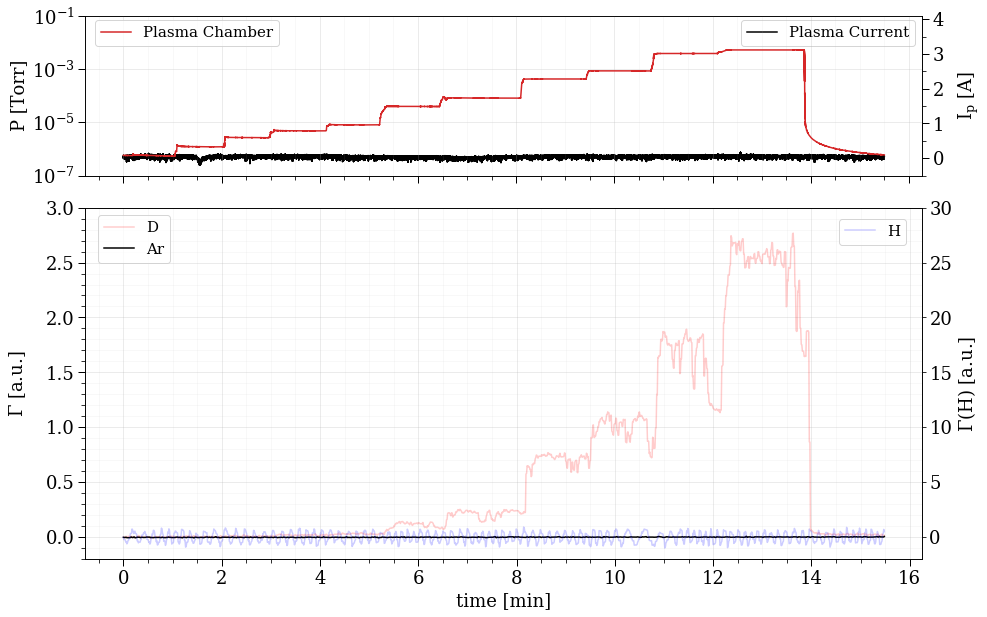

In [468]:
print('d2 no plasma')

# range
fr = 2070
to = 3000
d_t = data_t[((data_t['time']>=fr) & (data_t['time']<=to))]
d = data[(data['time']>=fr) & (data['time']<=to)]
d_q = data_q[(data_q['time']>=fr) & (data_q['time']<=to)]

# convert
p2 = 10**(1.667*d['P2'] - 11.46) # 11.46 convert Pfeiffer signal to pressure
p1 = d['P1']*10**d['IGscale'] # convert linear IG signal to pressure

def iconv(v):
    return 5/1*(v-2.52)

ip = iconv(d['Ip'])-0.1

# plot
fig = gcf()
G = gridspec.GridSpec(3,1)
axs = [plt.subplot(G[0, 0]), plt.subplot(G[1:, 0])]

h = 10
w = 15
fig.set_size_inches(w,h)
dt = 60

""" plot pressure """
ax = axs[0]
# ax.plot(d['time']/dt - d['time'].iloc[0]/dt, p1, c='k', label='Permeation Chamber')
ax.plot(d['time']/dt - d['time'].iloc[0]/dt, p2, c='C3', label='Plasma Chamber')
# ax.plot(d['time']/dt, d['QMS_signal'])
ticks_visual(ax)
ax.set_yscale('log')
ax.set_ylim(1e-7, 1e-1)
ax.set_yticks(np.logspace(-7, -1, 7), minor=False)
ax.yaxis.set_major_locator(FixedLocator(np.logspace(-7, -1, 4)))
# ax.yaxis.set_minor_locator(FixedLocator([1e-7, 1e-5, 1e-3]))
ax.tick_params(labelbottom=False)
ax.legend(loc=1, bbox_to_anchor=[0.24, 1.02], fontsize=15)


""" plot plasma current """
ax2 = ax.twinx()
ax2.plot(d['time']/dt - d['time'].iloc[0]/dt, ip,'k', label=r'Plasma Current')
ticks_visual(ax2)
ax2.set_ylim(-0.1, 4.1)
ax2.set_yticks(np.linspace(-0.5, 3.5, 9), minor=False)
ax2.yaxis.set_major_locator(MultipleLocator(1))
ax2.yaxis.set_minor_locator(MultipleLocator(0.5))
ax2.tick_params(labelbottom=False)

ax2.set_ylabel('$I_{p}$ [A]')
ax2.legend(loc=1, bbox_to_anchor=[1., 1.02], fontsize=15)

ax.set_zorder(2)
ax2.set_zorder(1)
ax.patch.set_alpha(0)

""" plot qms """
ax = axs[1]
ax2 = ax.twinx()
h2 = 2*(d_q['2']-d_q['2'].iloc[0]) + d_q['3']-d_q['3'].iloc[0] + 2*(d_q['18']-d_q['18'].iloc[0]) + d_q['19']-d_q['19'].iloc[0]
d2 = d_q['3']-d_q['3'].iloc[0] + 2*(d_q['4']-d_q['4'].iloc[0]) + d_q['19']-d_q['19'].iloc[0] + 2*(d_q['20']-d_q['20'].iloc[0])
ar = d_q['40']-d_q['40'].iloc[0]
h2_base = savitzky_golay(h2, 100, 1)
h2 -= h2_base

h2/=1e-9
d2/=1e-9
ar/=1e-9

ax2.plot(d_q['time']/dt - d_q['time'].iloc[0]/dt, h2, label=r"H", c='b', alpha=0.2)
ax.plot(d_q['time']/dt - d_q['time'].iloc[0]/dt, d2, label=r"D", c='r', alpha=0.2)
ax.plot(d_q['time']/dt - d_q['time'].iloc[0]/dt, ar, label=r"Ar", c='k', alpha=1)
# ax.plot(d_q['time']/dt, d_q['analog_1'], c='C3', label='analog_1')
# ax.set_yscale('log')
ax.set_ylim(-0.2, 3)
ax2.set_ylim(-2, 30)
# ax.set_yticks(np.logspace(-13, -7, 7), minor=False)
# ax.yaxis.set_major_locator(FixedLocator(np.logspace(-13, -7, 7)))
ax.legend(loc=1, bbox_to_anchor=[0.11, 1], fontsize=15)
ax2.legend(loc=1, bbox_to_anchor=[0.99, 0.99], fontsize=15)
ticks_visual(ax)

[grid_visual(ax) for ax in axs]
fig.align_ylabels()

lbls = ['P [Torr]','$\Gamma$ [a.u.]']
[ax.set_ylabel(l) for l,ax in zip(lbls,axs)]
axs[-1].set_xlabel('time [min]')
#[ax.set_xlim(0,145) for ax in axs]
ax2.set_ylabel('$\Gamma(H)$ [a.u.]')
[ax.set_rasterized(True) for ax in axs]
#fig.savefig(join(bpth,'figures','24Jan_exp.pdf'),dpi = 300,bbox_inches='tight')
# fig.savefig(join(bpth,'figures','24Jan_baking.pdf'),dpi = 300,bbox_inches='tight')
# fig.savefig(join('./ar_d2_plasma_1.5A.pdf'),dpi = 300,bbox_inches='tight')
title = 'D2_no_plasma_slide3'
# fig.savefig(join('./data/figure/{}.pdf'.format(title)),dpi = 300,bbox_inches='tight')
fig.savefig(join('./data/figure/{}.png'.format(title)),dpi = 300,bbox_inches='tight')

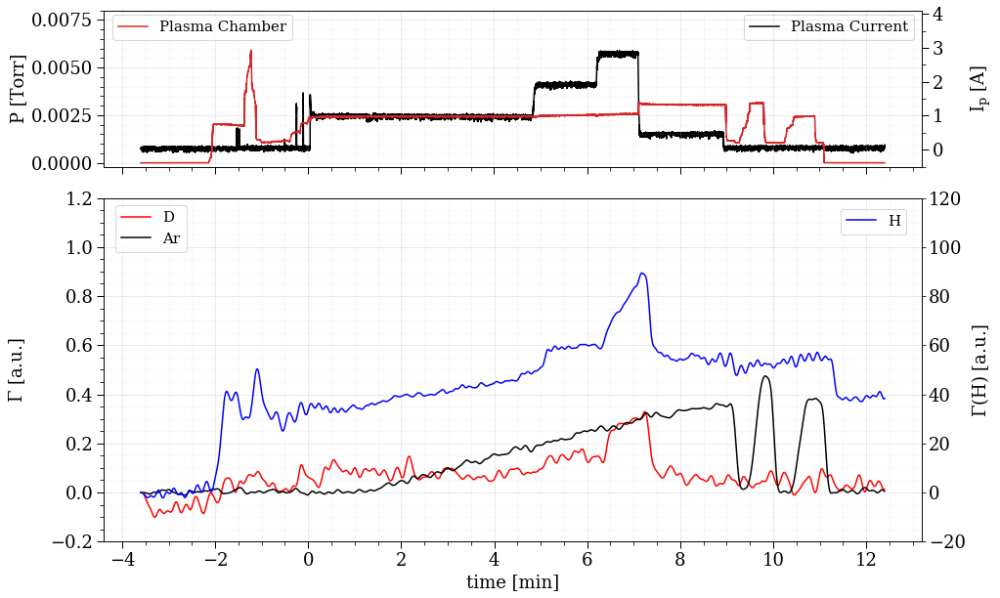

In [469]:
# range
fr = 5090
to = 6050
d_t = data_t[((data_t['time']>=fr) & (data_t['time']<=to))]
d = data[(data['time']>=fr) & (data['time']<=to)]
d_q = data_q[(data_q['time']>=fr) & (data_q['time']<=to)]

# convert
p2 = 10**(1.667*d['P2'] - 11.46) # 11.46 convert Pfeiffer signal to pressure
p1 = d['P1']*10**d['IGscale'] # convert linear IG signal to pressure

def iconv(v):
    return 5/1*(v-2.52)

ip = iconv(d['Ip'])-0.1

# plot
fig = gcf()
G = gridspec.GridSpec(3,1)
axs = [plt.subplot(G[0, 0]), plt.subplot(G[1:, 0])]

h = 10
w = 15
fig.set_size_inches(w,h)
dt = 60

""" plot pressure """
ax = axs[0]
# ax.plot(d['time']/dt - d['time'].iloc[0]/dt, p1, c='k', label='Permeation Chamber')
ax.plot(d['time']/dt - d['time'].iloc[0]/dt-3.6, p2, c='C3', label='Plasma Chamber')
# ax.plot(d['time']/dt, d['QMS_signal'])
ticks_visual(ax)
# ax.set_yscale('log')
ax.set_ylim(-0.0002,0.008)
# ax.set_yticks(np.logspace(-7, -1, 7), minor=False)
# ax.yaxis.set_major_locator(FixedLocator(np.logspace(-7, -1, 4)))
# ax.yaxis.set_minor_locator(FixedLocator([1e-7, 1e-5, 1e-3]))
ax.tick_params(labelbottom=False)
ax.legend(loc=1, bbox_to_anchor=[0.24, 1.02], fontsize=15)


""" plot plasma current """
ax2 = ax.twinx()
ax2.plot(d['time']/dt - d['time'].iloc[0]/dt - 3.6, ip,'k', label=r'Plasma Current')
ticks_visual(ax2)
ax2.set_ylim(-0.1, 4.1)
ax2.set_yticks(np.linspace(-0.5, 3.5, 9), minor=False)
ax2.yaxis.set_major_locator(MultipleLocator(1))
ax2.yaxis.set_minor_locator(MultipleLocator(0.5))
ax2.tick_params(labelbottom=False)

ax2.set_ylabel('$I_{p}$ [A]')
ax2.legend(loc=1, bbox_to_anchor=[1.0, 1.02], fontsize=15)

ax.set_zorder(2)
ax2.set_zorder(1)
ax.patch.set_alpha(0)

""" plot qms """
ax = axs[1]
ax2 = ax.twinx()
h2 = 2*(d_q['2']-d_q['2'].iloc[0]) + d_q['3']-d_q['3'].iloc[0] + 2*(d_q['18']-d_q['18'].iloc[0]) + d_q['19']-d_q['19'].iloc[0]
d2 = d_q['3']-d_q['3'].iloc[0] + 2*(d_q['4']-d_q['4'].iloc[0]) + d_q['19']-d_q['19'].iloc[0] + 2*(d_q['20']-d_q['20'].iloc[0])
ar = d_q['40']-d_q['40'].iloc[0]

h2/=1e-10
d2/=1e-10
ar/=1e-10

time = np.array(d_q['time']/dt - d_q['time'].iloc[0]/dt-3.6)
h2 = np.array(h2)
d2 = np.array(d2)
ar = np.array(ar)

# ax2.plot(time[::10], h2[::10], linewidth=0, marker='.', label=r"H", c='gray', alpha=1)
# ax.plot(time[::10], d2[::10], linewidth=0, marker='.', label=r"D", c='r', alpha=1)
# ax.plot(time[::10], ar[::10], linewidth=0, marker='.', label=r"Ar", c='k', alpha=1)
fil = signal.firwin(numtaps=21, cutoff=40, fs=3000)
h2 = signal.lfilter(fil, 1, h2)
d2 = signal.lfilter(fil, 1, d2)
ar = signal.lfilter(fil, 1, ar)

ax2.plot(time, h2, label=r"H", c='b', alpha=1)
ax.plot(time, d2, label=r"D", c='r', alpha=1)
ax.plot(time, ar, label=r"Ar", c='k', alpha=1)
# ax.plot(d_q['time']/dt, d_q['analog_1'], c='C3', label='analog_1')
# ax.set_yscale('log')
ax.set_ylim(-0.2, 1.2)
ax2.set_ylim(-20, 120)
# ax.set_yticks(np.logspace(-13, -7, 7), minor=False)
# ax.yaxis.set_major_locator(FixedLocator(np.logspace(-13, -7, 7)))
ax.legend(loc=1, bbox_to_anchor=[0.11, 1], fontsize=15)
ax2.legend(loc=1, bbox_to_anchor=[0.99, 0.99], fontsize=15)
ticks_visual(ax)

[grid_visual(ax) for ax in axs]
fig.align_ylabels()

lbls = ['P [Torr]','$\Gamma$ [a.u.]']
[ax.set_ylabel(l) for l,ax in zip(lbls,axs)]
axs[-1].set_xlabel('time [min]')
#[ax.set_xlim(0,145) for ax in axs]
ax2.set_ylabel('$\Gamma(H)$ [a.u.]')

[ax.set_rasterized(True) for ax in axs]

title = 'argonh2_plasma_slide'
# fig.savefig(join('./data/figure/{}.pdf'.format(title)),dpi = 300,bbox_inches='tight')
fig.savefig(join('./data/figure/{}.png'.format(title)),dpi = 300,bbox_inches='tight')

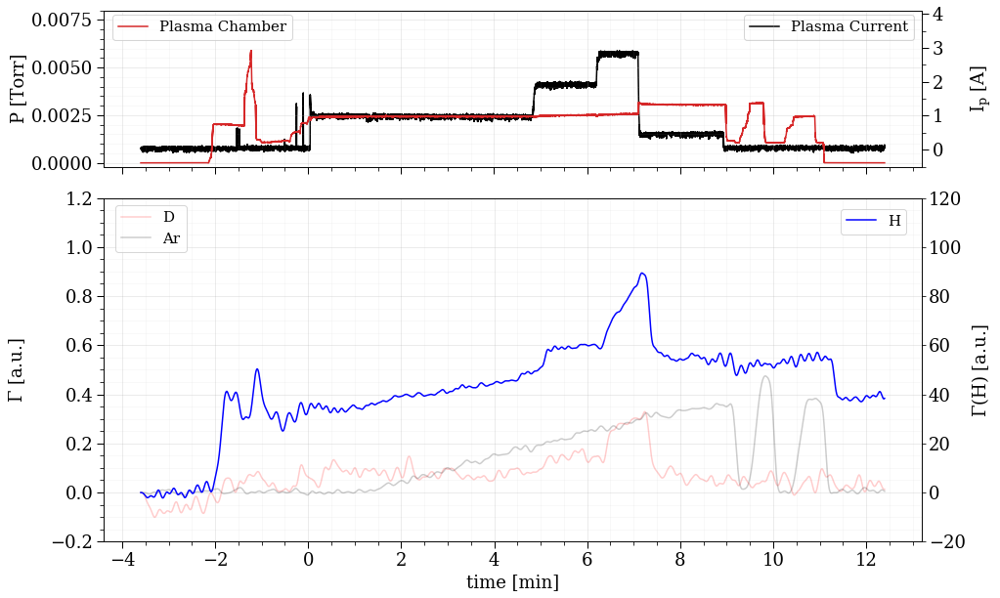

In [470]:
# range
fr = 5090
to = 6050
d_t = data_t[((data_t['time']>=fr) & (data_t['time']<=to))]
d = data[(data['time']>=fr) & (data['time']<=to)]
d_q = data_q[(data_q['time']>=fr) & (data_q['time']<=to)]

# convert
p2 = 10**(1.667*d['P2'] - 11.46) # 11.46 convert Pfeiffer signal to pressure
p1 = d['P1']*10**d['IGscale'] # convert linear IG signal to pressure

def iconv(v):
    return 5/1*(v-2.52)

ip = iconv(d['Ip'])-0.1

# plot
fig = gcf()
G = gridspec.GridSpec(3,1)
axs = [plt.subplot(G[0, 0]), plt.subplot(G[1:, 0])]

h = 10
w = 15
fig.set_size_inches(w,h)
dt = 60

""" plot pressure """
ax = axs[0]
# ax.plot(d['time']/dt - d['time'].iloc[0]/dt, p1, c='k', label='Permeation Chamber')
ax.plot(d['time']/dt - d['time'].iloc[0]/dt-3.6, p2, c='C3', label='Plasma Chamber')
# ax.plot(d['time']/dt, d['QMS_signal'])
ticks_visual(ax)
# ax.set_yscale('log')
ax.set_ylim(-0.0002,0.008)
# ax.set_yticks(np.logspace(-7, -1, 7), minor=False)
# ax.yaxis.set_major_locator(FixedLocator(np.logspace(-7, -1, 4)))
# ax.yaxis.set_minor_locator(FixedLocator([1e-7, 1e-5, 1e-3]))
ax.tick_params(labelbottom=False)
ax.legend(loc=1, bbox_to_anchor=[0.24, 1.02], fontsize=15)

""" plot plasma current """
ax2 = ax.twinx()
ax2.plot(d['time']/dt - d['time'].iloc[0]/dt - 3.6, ip,'k', label=r'Plasma Current')
ticks_visual(ax2)
ax2.set_ylim(-0.1, 4.1)
ax2.set_yticks(np.linspace(-0.5, 3.5, 9), minor=False)
ax2.yaxis.set_major_locator(MultipleLocator(1))
ax2.yaxis.set_minor_locator(MultipleLocator(0.5))
ax2.tick_params(labelbottom=False)

ax2.set_ylabel('$I_{p}$ [A]')
ax2.legend(loc=1, bbox_to_anchor=[1.0, 1.02], fontsize=15)

ax.set_zorder(2)
ax2.set_zorder(1)
ax.patch.set_alpha(0)

""" plot qms """
ax = axs[1]
ax2 = ax.twinx()
h2 = 2*(d_q['2']-d_q['2'].iloc[0]) + d_q['3']-d_q['3'].iloc[0] + 2*(d_q['18']-d_q['18'].iloc[0]) + d_q['19']-d_q['19'].iloc[0]
d2 = d_q['3']-d_q['3'].iloc[0] + 2*(d_q['4']-d_q['4'].iloc[0]) + d_q['19']-d_q['19'].iloc[0] + 2*(d_q['20']-d_q['20'].iloc[0])
ar = d_q['40']-d_q['40'].iloc[0]

h2/=1e-10
d2/=1e-10
ar/=1e-10

time = np.array(d_q['time']/dt - d_q['time'].iloc[0]/dt-3.6)
h2 = np.array(h2)
d2 = np.array(d2)
ar = np.array(ar)

# ax2.plot(time[::10], h2[::10], linewidth=0, marker='.', label=r"H", c='gray', alpha=1)
# ax.plot(time[::10], d2[::10], linewidth=0, marker='.', label=r"D", c='r', alpha=1)
# ax.plot(time[::10], ar[::10], linewidth=0, marker='.', label=r"Ar", c='k', alpha=1)

fil = signal.firwin(numtaps=21, cutoff=40, fs=3000)
h2 = signal.lfilter(fil, 1, h2)
d2 = signal.lfilter(fil, 1, d2)
ar = signal.lfilter(fil, 1, ar)

ax2.plot(time, h2, label=r"H", c='b', alpha=1)
ax.plot(time, d2, label=r"D", c='r', alpha=0.2)
ax.plot(time, ar, label=r"Ar", c='k', alpha=0.2)
# ax.plot(d_q['time']/dt, d_q['analog_1'], c='C3', label='analog_1')
# ax.set_yscale('log')
ax.set_ylim(-0.2, 1.2)
ax2.set_ylim(-20, 120)
# ax.set_yticks(np.logspace(-13, -7, 7), minor=False)
# ax.yaxis.set_major_locator(FixedLocator(np.logspace(-13, -7, 7)))
ax.legend(loc=1, bbox_to_anchor=[0.11, 1], fontsize=15)
ax2.legend(loc=1, bbox_to_anchor=[0.99, 0.99], fontsize=15)
ticks_visual(ax)

[grid_visual(ax) for ax in axs]
fig.align_ylabels()

lbls = ['P [Torr]','$\Gamma$ [a.u.]']
[ax.set_ylabel(l) for l,ax in zip(lbls,axs)]
axs[-1].set_xlabel('time [min]')
#[ax.set_xlim(0,145) for ax in axs]
ax2.set_ylabel('$\Gamma(H)$ [a.u.]')

[ax.set_rasterized(True) for ax in axs]

title = 'argonh2_plasma_slide1'
# fig.savefig(join('./data/figure/{}.pdf'.format(title)),dpi = 300,bbox_inches='tight')
fig.savefig(join('./data/figure/{}.png'.format(title)),dpi = 300,bbox_inches='tight')

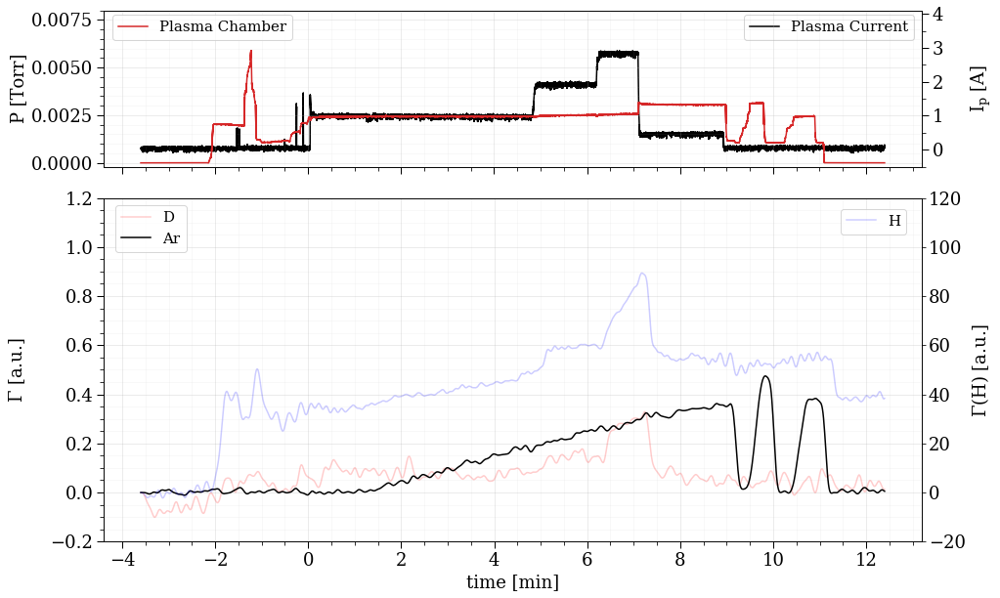

In [473]:
# range
fr = 5090
to = 6050
d_t = data_t[((data_t['time']>=fr) & (data_t['time']<=to))]
d = data[(data['time']>=fr) & (data['time']<=to)]
d_q = data_q[(data_q['time']>=fr) & (data_q['time']<=to)]

# convert
p2 = 10**(1.667*d['P2'] - 11.46) # 11.46 convert Pfeiffer signal to pressure
p1 = d['P1']*10**d['IGscale'] # convert linear IG signal to pressure

def iconv(v):
    return 5/1*(v-2.52)

ip = iconv(d['Ip'])-0.1

# plot
fig = gcf()
G = gridspec.GridSpec(3,1)
axs = [plt.subplot(G[0, 0]), plt.subplot(G[1:, 0])]

h = 10
w = 15
fig.set_size_inches(w,h)
dt = 60

""" plot pressure """
ax = axs[0]
# ax.plot(d['time']/dt - d['time'].iloc[0]/dt, p1, c='k', label='Permeation Chamber')
ax.plot(d['time']/dt - d['time'].iloc[0]/dt-3.6, p2, c='C3', label='Plasma Chamber')
# ax.plot(d['time']/dt, d['QMS_signal'])
ticks_visual(ax)
# ax.set_yscale('log')
ax.set_ylim(-0.0002,0.008)
# ax.set_yticks(np.logspace(-7, -1, 7), minor=False)
# ax.yaxis.set_major_locator(FixedLocator(np.logspace(-7, -1, 4)))
# ax.yaxis.set_minor_locator(FixedLocator([1e-7, 1e-5, 1e-3]))
ax.tick_params(labelbottom=False)
ax.legend(loc=1, bbox_to_anchor=[0.24, 1.02], fontsize=15)

""" plot plasma current """
ax2 = ax.twinx()
ax2.plot(d['time']/dt - d['time'].iloc[0]/dt - 3.6, ip,'k', label=r'Plasma Current')
ticks_visual(ax2)
ax2.set_ylim(-0.1, 4.1)
ax2.set_yticks(np.linspace(-0.5, 3.5, 9), minor=False)
ax2.yaxis.set_major_locator(MultipleLocator(1))
ax2.yaxis.set_minor_locator(MultipleLocator(0.5))
ax2.tick_params(labelbottom=False)

ax2.set_ylabel('$I_{p}$ [A]')
ax2.legend(loc=1, bbox_to_anchor=[1.0, 1.02], fontsize=15)

ax.set_zorder(2)
ax2.set_zorder(1)
ax.patch.set_alpha(0)

""" plot qms """
ax = axs[1]
ax2 = ax.twinx()
h2 = 2*(d_q['2']-d_q['2'].iloc[0]) + d_q['3']-d_q['3'].iloc[0] + 2*(d_q['18']-d_q['18'].iloc[0]) + d_q['19']-d_q['19'].iloc[0]
d2 = d_q['3']-d_q['3'].iloc[0] + 2*(d_q['4']-d_q['4'].iloc[0]) + d_q['19']-d_q['19'].iloc[0] + 2*(d_q['20']-d_q['20'].iloc[0])
ar = d_q['40']-d_q['40'].iloc[0]

h2/=1e-10
d2/=1e-10
ar/=1e-10

time = np.array(d_q['time']/dt - d_q['time'].iloc[0]/dt-3.6)
h2 = np.array(h2)
d2 = np.array(d2)
ar = np.array(ar)

# ax2.plot(time[::10], h2[::10], linewidth=0, marker='.', label=r"H", c='gray', alpha=1)
# ax.plot(time[::10], d2[::10], linewidth=0, marker='.', label=r"D", c='r', alpha=1)
# ax.plot(time[::10], ar[::10], linewidth=0, marker='.', label=r"Ar", c='k', alpha=1)

fil = signal.firwin(numtaps=21, cutoff=40, fs=3000)
h2 = signal.lfilter(fil, 1, h2)
d2 = signal.lfilter(fil, 1, d2)
ar = signal.lfilter(fil, 1, ar)

ax2.plot(time, h2, label=r"H", c='b', alpha=0.2)
ax.plot(time, d2, label=r"D", c='r', alpha=0.2)
ax.plot(time, ar, label=r"Ar", c='k', alpha=1)
# ax.plot(d_q['time']/dt, d_q['analog_1'], c='C3', label='analog_1')
# ax.set_yscale('log')
ax.set_ylim(-0.2, 1.2)
ax2.set_ylim(-20, 120)
# ax.set_yticks(np.logspace(-13, -7, 7), minor=False)
# ax.yaxis.set_major_locator(FixedLocator(np.logspace(-13, -7, 7)))
ax.legend(loc=1, bbox_to_anchor=[0.11, 1], fontsize=15)
ax2.legend(loc=1, bbox_to_anchor=[0.99, 0.99], fontsize=15)
ticks_visual(ax)

[grid_visual(ax) for ax in axs]
fig.align_ylabels()

lbls = ['P [Torr]','$\Gamma$ [a.u.]']
[ax.set_ylabel(l) for l,ax in zip(lbls,axs)]
axs[-1].set_xlabel('time [min]')
#[ax.set_xlim(0,145) for ax in axs]
ax2.set_ylabel('$\Gamma(H)$ [a.u.]')

[ax.set_rasterized(True) for ax in axs]

title = 'argonh2_plasma_slide2'
# fig.savefig(join('./data/figure/{}.pdf'.format(title)),dpi = 300,bbox_inches='tight')
fig.savefig(join('./data/figure/{}.png'.format(title)),dpi = 300,bbox_inches='tight')

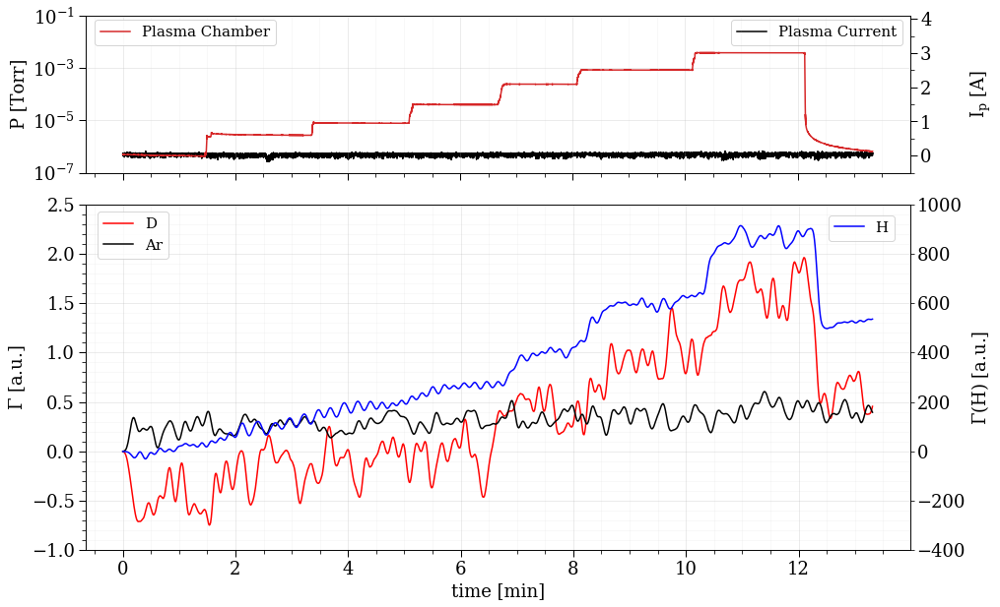

In [474]:
# range
fr = 4200
to = 5000
d_t = data_t[((data_t['time']>=fr) & (data_t['time']<=to))]
d = data[(data['time']>=fr) & (data['time']<=to)]
d_q = data_q[(data_q['time']>=fr) & (data_q['time']<=to)]

# convert
p2 = 10**(1.667*d['P2'] - 11.46) # 11.46 convert Pfeiffer signal to pressure
p1 = d['P1']*10**d['IGscale'] # convert linear IG signal to pressure

def iconv(v):
    return 5/1*(v-2.52)

ip = iconv(d['Ip'])-0.1

# plot
fig = gcf()
G = gridspec.GridSpec(3,1)
axs = [plt.subplot(G[0, 0]), plt.subplot(G[1:, 0])]

h = 10
w = 15
fig.set_size_inches(w,h)
dt = 60

""" plot pressure """
ax = axs[0]
# ax.plot(d['time']/dt - d['time'].iloc[0]/dt, p1, c='k', label='Permeation Chamber')
ax.plot(d['time']/dt - d['time'].iloc[0]/dt, p2, c='C3', label='Plasma Chamber')
# ax.plot(d['time']/dt, d['QMS_signal'])
ticks_visual(ax)
ax.set_yscale('log')
ax.set_ylim(1e-7, 1e-1)
# ax.set_yticks(np.logspace(-7, -1, 7), minor=False)
# ax.yaxis.set_major_locator(FixedLocator(np.logspace(-7, -1, 4)))
# ax.yaxis.set_minor_locator(FixedLocator([1e-7, 1e-5, 1e-3]))
ax.tick_params(labelbottom=False)
ax.legend(loc=1, bbox_to_anchor=[0.24, 1.02], fontsize=15)

""" plot plasma current """
ax2 = ax.twinx()
ax2.plot(d['time']/dt - d['time'].iloc[0]/dt , ip,'k', label=r'Plasma Current')
ticks_visual(ax2)
ax2.set_ylim(-0.1, 4.1)
ax2.set_yticks(np.linspace(-0.5, 3.5, 9), minor=False)
ax2.yaxis.set_major_locator(MultipleLocator(1))
ax2.yaxis.set_minor_locator(MultipleLocator(0.5))
ax2.tick_params(labelbottom=False)

ax2.set_ylabel('$I_{p}$ [A]')
ax2.legend(loc=1, bbox_to_anchor=[1.0, 1.02], fontsize=15)

ax.set_zorder(2)
ax2.set_zorder(1)
ax.patch.set_alpha(0)

""" plot qms """
ax = axs[1]
ax2 = ax.twinx()
h2 = 2*(d_q['2']-d_q['2'].iloc[0]) + d_q['3']-d_q['3'].iloc[0] + 2*(d_q['18']-d_q['18'].iloc[0]) + d_q['19']-d_q['19'].iloc[0]
d2 = d_q['3']-d_q['3'].iloc[0] + 2*(d_q['4']-d_q['4'].iloc[0]) + d_q['19']-d_q['19'].iloc[0] + 2*(d_q['20']-d_q['20'].iloc[0])
ar = d_q['40']-d_q['40'].iloc[0]

h2/=1e-11
d2/=1e-11
ar/=1e-11

time = np.array(d_q['time']/dt - d_q['time'].iloc[0]/dt)
# h2 = np.array(h2)
# d2 = np.array(d2)
# ar = np.array(ar)

# ax2.plot(time[::10], h2[::10], linewidth=0, marker='.', label=r"H", c='gray', alpha=1)
# ax.plot(time[::10], d2[::10], linewidth=0, marker='.', label=r"D", c='r', alpha=1)
# ax.plot(time[::10], ar[::10], linewidth=0, marker='.', label=r"Ar", c='k', alpha=1)

# h2 = savitzky_golay(h2, 6, 1)
# d2 = savitzky_golay(d2, 10, 1)
# ar = savitzky_golay(ar, 6, 1)
fil = signal.firwin(numtaps=21, cutoff=50, fs=3000)
h2 = signal.lfilter(fil, 1, h2)
d2 = signal.lfilter(fil, 1, d2)
ar = signal.lfilter(fil, 1, ar)

ax2.plot(time, h2, label=r"H", c='b', alpha=1)
ax.plot(time, d2, label=r"D", c='r', alpha=1)
ax.plot(time, ar, label=r"Ar", c='k', alpha=1)
# ax.plot(d_q['time']/dt, d_q['analog_1'], c='C3', label='analog_1')
# ax.set_yscale('log')
ax.set_ylim(-1, 2.5)
ax2.set_ylim(-400, 1000)
# ax.set_yticks(np.logspace(-13, -7, 7), minor=False)
# ax.yaxis.set_major_locator(FixedLocator(np.logspace(-13, -7, 7)))
ax.legend(loc=1, bbox_to_anchor=[0.11, 1], fontsize=15)
ax2.legend(loc=1, bbox_to_anchor=[0.99, 0.99], fontsize=15)
ticks_visual(ax)

[grid_visual(ax) for ax in axs]
fig.align_ylabels()

lbls = ['P [Torr]','$\Gamma$ [a.u.]']
[ax.set_ylabel(l) for l,ax in zip(lbls,axs)]
axs[-1].set_xlabel('time [min]')
#[ax.set_xlim(0,145) for ax in axs]
ax2.set_ylabel('$\Gamma(H)$ [a.u.]')

[ax.set_rasterized(True) for ax in axs]

# axs[1].axvspan(0, 8.5-3.6, color="pink", alpha=0.5)
# axs[1].axvspan(8.5-3.6, 9.7-3.6, color="lawngreen", alpha=0.5)
# axs[1].axvspan(9.7-3.6, 10.7-3.6, color="yellow", alpha=0.5)
# axs[1].axvspan(10.7-3.6, 12.5-3.6, color="cyan", alpha=0.5)

title = 'h2_no_plasma_slide'
# fig.savefig(join('./data/figure/{}.pdf'.format(title)),dpi = 300,bbox_inches='tight')
fig.savefig(join('./data/figure/{}.png'.format(title)),dpi = 300,bbox_inches='tight')

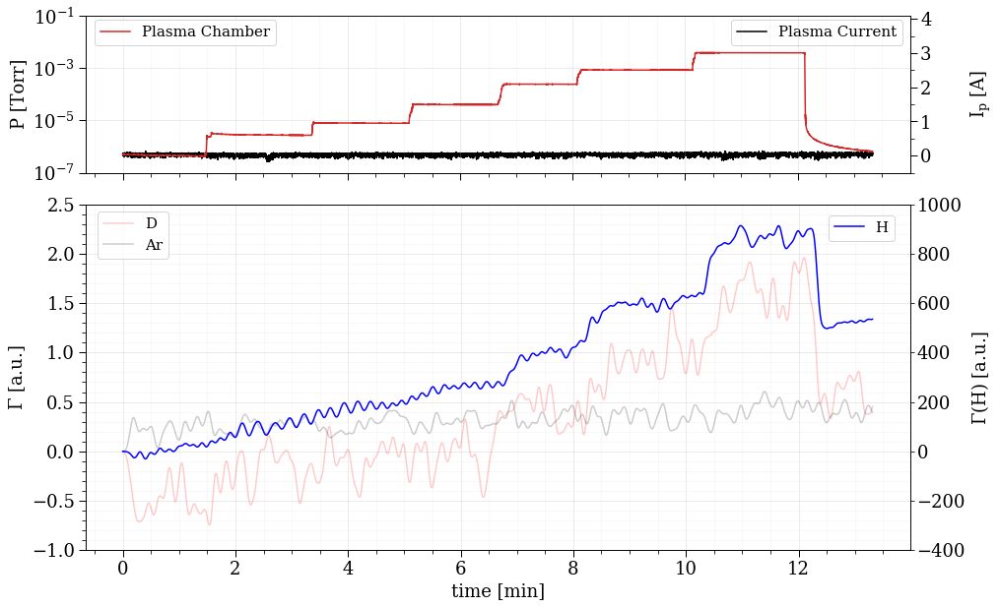

In [458]:
# range
fr = 4200
to = 5000
d_t = data_t[((data_t['time']>=fr) & (data_t['time']<=to))]
d = data[(data['time']>=fr) & (data['time']<=to)]
d_q = data_q[(data_q['time']>=fr) & (data_q['time']<=to)]

# convert
p2 = 10**(1.667*d['P2'] - 11.46) # 11.46 convert Pfeiffer signal to pressure
p1 = d['P1']*10**d['IGscale'] # convert linear IG signal to pressure

def iconv(v):
    return 5/1*(v-2.52)

ip = iconv(d['Ip'])-0.1

# plot
fig = gcf()
G = gridspec.GridSpec(3,1)
axs = [plt.subplot(G[0, 0]), plt.subplot(G[1:, 0])]

h = 10
w = 15
fig.set_size_inches(w,h)
dt = 60

""" plot pressure """
ax = axs[0]
# ax.plot(d['time']/dt - d['time'].iloc[0]/dt, p1, c='k', label='Permeation Chamber')
ax.plot(d['time']/dt - d['time'].iloc[0]/dt, p2, c='C3', label='Plasma Chamber')
# ax.plot(d['time']/dt, d['QMS_signal'])
ticks_visual(ax)
ax.set_yscale('log')
ax.set_ylim(1e-7, 1e-1)
# ax.set_yticks(np.logspace(-7, -1, 7), minor=False)
# ax.yaxis.set_major_locator(FixedLocator(np.logspace(-7, -1, 4)))
# ax.yaxis.set_minor_locator(FixedLocator([1e-7, 1e-5, 1e-3]))
ax.tick_params(labelbottom=False)
ax.legend(loc=1, bbox_to_anchor=[0.24, 1.02], fontsize=15)


""" plot plasma current """
ax2 = ax.twinx()
ax2.plot(d['time']/dt - d['time'].iloc[0]/dt , ip,'k', label=r'Plasma Current')
ticks_visual(ax2)
ax2.set_ylim(-0.1, 4.1)
ax2.set_yticks(np.linspace(-0.5, 3.5, 9), minor=False)
ax2.yaxis.set_major_locator(MultipleLocator(1))
ax2.yaxis.set_minor_locator(MultipleLocator(0.5))
ax2.tick_params(labelbottom=False)

ax2.set_ylabel('$I_{p}$ [A]')
ax2.legend(loc=1, bbox_to_anchor=[1.0, 1.02], fontsize=15)

ax.set_zorder(2)
ax2.set_zorder(1)
ax.patch.set_alpha(0)

""" plot qms """
ax = axs[1]
ax2 = ax.twinx()
h2 = 2*(d_q['2']-d_q['2'].iloc[0]) + d_q['3']-d_q['3'].iloc[0] + 2*(d_q['18']-d_q['18'].iloc[0]) + d_q['19']-d_q['19'].iloc[0]
d2 = d_q['3']-d_q['3'].iloc[0] + 2*(d_q['4']-d_q['4'].iloc[0]) + d_q['19']-d_q['19'].iloc[0] + 2*(d_q['20']-d_q['20'].iloc[0])
ar = d_q['40']-d_q['40'].iloc[0]

h2/=1e-11
d2/=1e-11
ar/=1e-11

time = np.array(d_q['time']/dt - d_q['time'].iloc[0]/dt)
# h2 = np.array(h2)
# d2 = np.array(d2)
# ar = np.array(ar)

# ax2.plot(time[::10], h2[::10], linewidth=0, marker='.', label=r"H", c='gray', alpha=1)
# ax.plot(time[::10], d2[::10], linewidth=0, marker='.', label=r"D", c='r', alpha=1)
# ax.plot(time[::10], ar[::10], linewidth=0, marker='.', label=r"Ar", c='k', alpha=1)

# h2 = savitzky_golay(h2, 6, 1)
# d2 = savitzky_golay(d2, 10, 1)
# ar = savitzky_golay(ar, 6, 1)
fil = signal.firwin(numtaps=21, cutoff=50, fs=3000)
h2 = signal.lfilter(fil, 1, h2)
d2 = signal.lfilter(fil, 1, d2)
ar = signal.lfilter(fil, 1, ar)

ax2.plot(time, h2, label=r"H", c='b', alpha=1)
ax.plot(time, d2, label=r"D", c='r', alpha=0.2)
ax.plot(time, ar, label=r"Ar", c='k', alpha=0.2)
# ax.plot(d_q['time']/dt, d_q['analog_1'], c='C3', label='analog_1')
# ax.set_yscale('log')
ax.set_ylim(-1, 2.5)
ax2.set_ylim(-400, 1000)
# ax.set_yticks(np.logspace(-13, -7, 7), minor=False)
# ax.yaxis.set_major_locator(FixedLocator(np.logspace(-13, -7, 7)))
ax.legend(loc=1, bbox_to_anchor=[0.11, 1], fontsize=15)
ax2.legend(loc=1, bbox_to_anchor=[0.99, 0.99], fontsize=15)
ticks_visual(ax)

[grid_visual(ax) for ax in axs]
fig.align_ylabels()

lbls = ['P [Torr]','$\Gamma$ [a.u.]']
[ax.set_ylabel(l) for l,ax in zip(lbls,axs)]
axs[-1].set_xlabel('time [min]')
#[ax.set_xlim(0,145) for ax in axs]
ax2.set_ylabel('$\Gamma(H)$ [a.u.]')

[ax.set_rasterized(True) for ax in axs]

# axs[1].axvspan(0, 8.5-3.6, color="pink", alpha=0.5)
# axs[1].axvspan(8.5-3.6, 9.7-3.6, color="lawngreen", alpha=0.5)
# axs[1].axvspan(9.7-3.6, 10.7-3.6, color="yellow", alpha=0.5)
# axs[1].axvspan(10.7-3.6, 12.5-3.6, color="cyan", alpha=0.5)

title = 'h2_no_plasma_slide1'
# fig.savefig(join('./data/figure/{}.pdf'.format(title)),dpi = 300,bbox_inches='tight')
fig.savefig(join('./data/figure/{}.png'.format(title)),dpi = 300,bbox_inches='tight')

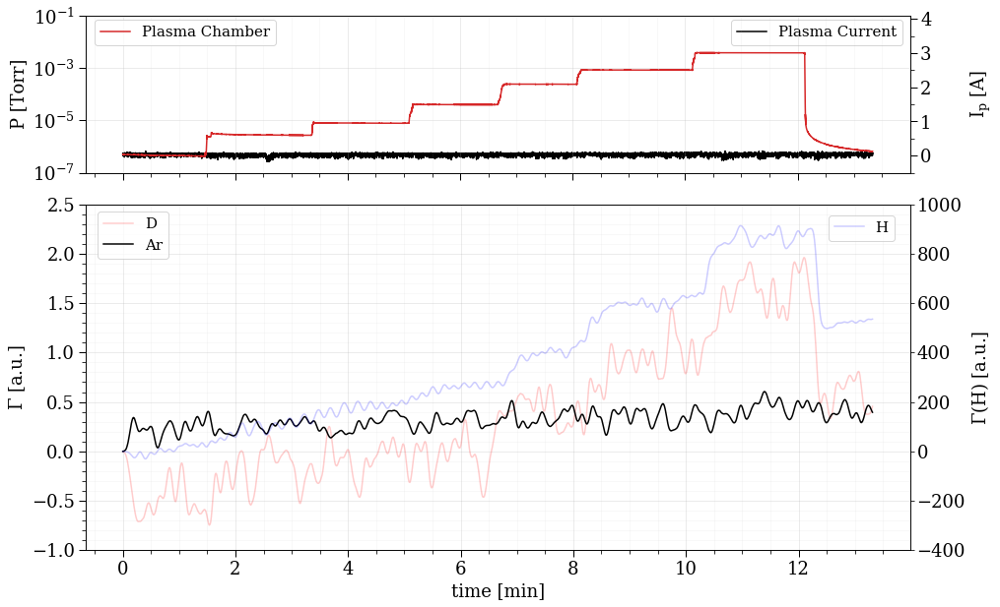

In [459]:
# range
fr = 4200
to = 5000
d_t = data_t[((data_t['time']>=fr) & (data_t['time']<=to))]
d = data[(data['time']>=fr) & (data['time']<=to)]
d_q = data_q[(data_q['time']>=fr) & (data_q['time']<=to)]

# convert
p2 = 10**(1.667*d['P2'] - 11.46) # 11.46 convert Pfeiffer signal to pressure
p1 = d['P1']*10**d['IGscale'] # convert linear IG signal to pressure

def iconv(v):
    return 5/1*(v-2.52)

ip = iconv(d['Ip'])-0.1

# plot
fig = gcf()
G = gridspec.GridSpec(3,1)
axs = [plt.subplot(G[0, 0]), plt.subplot(G[1:, 0])]

h = 10
w = 15
fig.set_size_inches(w,h)
dt = 60

""" plot pressure """
ax = axs[0]
# ax.plot(d['time']/dt - d['time'].iloc[0]/dt, p1, c='k', label='Permeation Chamber')
ax.plot(d['time']/dt - d['time'].iloc[0]/dt, p2, c='C3', label='Plasma Chamber')
# ax.plot(d['time']/dt, d['QMS_signal'])
ticks_visual(ax)
ax.set_yscale('log')
ax.set_ylim(1e-7, 1e-1)
# ax.set_yticks(np.logspace(-7, -1, 7), minor=False)
# ax.yaxis.set_major_locator(FixedLocator(np.logspace(-7, -1, 4)))
# ax.yaxis.set_minor_locator(FixedLocator([1e-7, 1e-5, 1e-3]))
ax.tick_params(labelbottom=False)
ax.legend(loc=1, bbox_to_anchor=[0.24, 1.02], fontsize=15)


""" plot plasma current """
ax2 = ax.twinx()
ax2.plot(d['time']/dt - d['time'].iloc[0]/dt , ip,'k', label=r'Plasma Current')
ticks_visual(ax2)
ax2.set_ylim(-0.1, 4.1)
ax2.set_yticks(np.linspace(-0.5, 3.5, 9), minor=False)
ax2.yaxis.set_major_locator(MultipleLocator(1))
ax2.yaxis.set_minor_locator(MultipleLocator(0.5))
ax2.tick_params(labelbottom=False)

ax2.set_ylabel('$I_{p}$ [A]')
ax2.legend(loc=1, bbox_to_anchor=[1.0, 1.02], fontsize=15)

ax.set_zorder(2)
ax2.set_zorder(1)
ax.patch.set_alpha(0)

""" plot qms """
ax = axs[1]
ax2 = ax.twinx()
h2 = 2*(d_q['2']-d_q['2'].iloc[0]) + d_q['3']-d_q['3'].iloc[0] + 2*(d_q['18']-d_q['18'].iloc[0]) + d_q['19']-d_q['19'].iloc[0]
d2 = d_q['3']-d_q['3'].iloc[0] + 2*(d_q['4']-d_q['4'].iloc[0]) + d_q['19']-d_q['19'].iloc[0] + 2*(d_q['20']-d_q['20'].iloc[0])
ar = d_q['40']-d_q['40'].iloc[0]

h2/=1e-11
d2/=1e-11
ar/=1e-11

time = np.array(d_q['time']/dt - d_q['time'].iloc[0]/dt)
# h2 = np.array(h2)
# d2 = np.array(d2)
# ar = np.array(ar)

# ax2.plot(time[::10], h2[::10], linewidth=0, marker='.', label=r"H", c='gray', alpha=1)
# ax.plot(time[::10], d2[::10], linewidth=0, marker='.', label=r"D", c='r', alpha=1)
# ax.plot(time[::10], ar[::10], linewidth=0, marker='.', label=r"Ar", c='k', alpha=1)

# h2 = savitzky_golay(h2, 6, 1)
# d2 = savitzky_golay(d2, 10, 1)
# ar = savitzky_golay(ar, 6, 1)
fil = signal.firwin(numtaps=21, cutoff=50, fs=3000)
h2 = signal.lfilter(fil, 1, h2)
d2 = signal.lfilter(fil, 1, d2)
ar = signal.lfilter(fil, 1, ar)

ax2.plot(time, h2, label=r"H", c='b', alpha=0.2)
ax.plot(time, d2, label=r"D", c='r', alpha=0.2)
ax.plot(time, ar, label=r"Ar", c='k', alpha=1)
# ax.plot(d_q['time']/dt, d_q['analog_1'], c='C3', label='analog_1')
# ax.set_yscale('log')
ax.set_ylim(-1, 2.5)
ax2.set_ylim(-400, 1000)
# ax.set_yticks(np.logspace(-13, -7, 7), minor=False)
# ax.yaxis.set_major_locator(FixedLocator(np.logspace(-13, -7, 7)))
ax.legend(loc=1, bbox_to_anchor=[0.11, 1], fontsize=15)
ax2.legend(loc=1, bbox_to_anchor=[0.99, 0.99], fontsize=15)
ticks_visual(ax)

[grid_visual(ax) for ax in axs]
fig.align_ylabels()

lbls = ['P [Torr]','$\Gamma$ [a.u.]']
[ax.set_ylabel(l) for l,ax in zip(lbls,axs)]
axs[-1].set_xlabel('time [min]')
#[ax.set_xlim(0,145) for ax in axs]
ax2.set_ylabel('$\Gamma(H)$ [a.u.]')

[ax.set_rasterized(True) for ax in axs]

# axs[1].axvspan(0, 8.5-3.6, color="pink", alpha=0.5)
# axs[1].axvspan(8.5-3.6, 9.7-3.6, color="lawngreen", alpha=0.5)
# axs[1].axvspan(9.7-3.6, 10.7-3.6, color="yellow", alpha=0.5)
# axs[1].axvspan(10.7-3.6, 12.5-3.6, color="cyan", alpha=0.5)

title = 'h2_no_plasma_slide2'
f# fig.savefig(join('./data/figure/{}.pdf'.format(title)),dpi = 300,bbox_inches='tight')
fig.savefig(join('./data/figure/{}.png'.format(title)),dpi = 300,bbox_inches='tight')

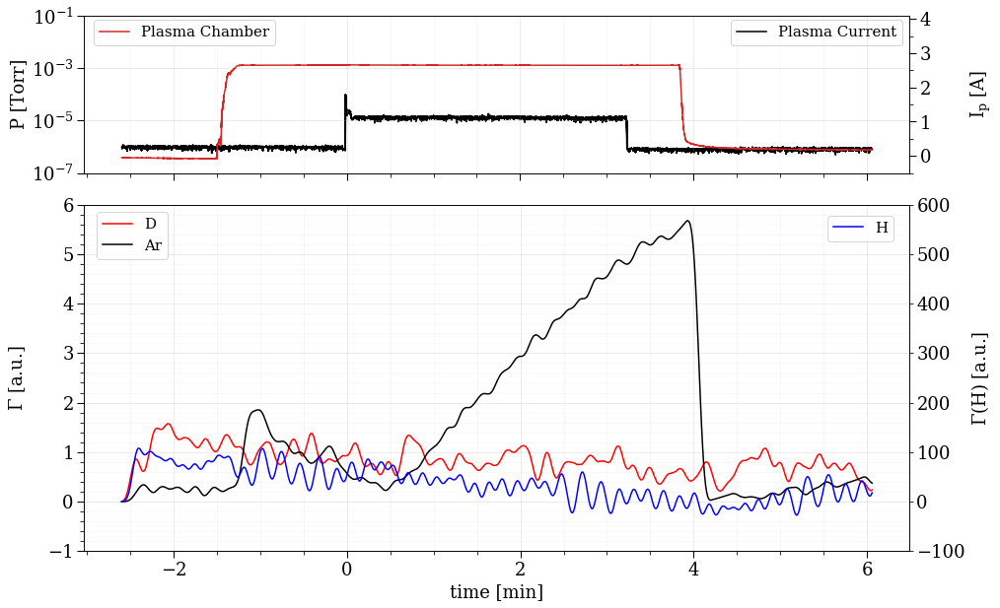

In [460]:
# range
fr = 7730
to = 8250
d_t = data_t[((data_t['time']>=fr) & (data_t['time']<=to))]
d = data[(data['time']>=fr) & (data['time']<=to)]
d_q = data_q[(data_q['time']>=fr) & (data_q['time']<=to)]

# convert
p2 = 10**(1.667*d['P2'] - 11.46) # 11.46 convert Pfeiffer signal to pressure
p1 = d['P1']*10**d['IGscale'] # convert linear IG signal to pressure

def iconv(v):
    return 5/1*(v-2.52)

ip = iconv(d['Ip'])-0.1

# plot
fig = gcf()
G = gridspec.GridSpec(3,1)
axs = [plt.subplot(G[0, 0]), plt.subplot(G[1:, 0])]

h = 10
w = 15
fig.set_size_inches(w,h)
dt = 60

""" plot pressure """
ax = axs[0]
# ax.plot(d['time']/dt - d['time'].iloc[0]/dt, p1, c='k', label='Permeation Chamber')
ax.plot(d['time']/dt - d['time'].iloc[0]/dt-2.6, p2, c='C3', label='Plasma Chamber')
# ax.plot(d['time']/dt, d['QMS_signal'])
ticks_visual(ax)
ax.set_yscale('log')
ax.set_ylim(1e-7, 1e-1)
# ax.set_yticks(np.logspace(-7, -1, 7), minor=False)
# ax.yaxis.set_major_locator(FixedLocator(np.logspace(-7, -1, 4)))
# ax.yaxis.set_minor_locator(FixedLocator([1e-7, 1e-5, 1e-3]))
ax.tick_params(labelbottom=False)
ax.legend(loc=1, bbox_to_anchor=[0.24, 1.02], fontsize=15)


""" plot plasma current """
ax2 = ax.twinx()
ax2.plot(d['time']/dt - d['time'].iloc[0]/dt-2.6 , ip,'k', label=r'Plasma Current')
ticks_visual(ax2)
ax2.set_ylim(-0.1, 4.1)
ax2.set_yticks(np.linspace(-0.5, 3.5, 9), minor=False)
ax2.yaxis.set_major_locator(MultipleLocator(1))
ax2.yaxis.set_minor_locator(MultipleLocator(0.5))
ax2.tick_params(labelbottom=False)

ax2.set_ylabel('$I_{p}$ [A]')
ax2.legend(loc=1, bbox_to_anchor=[1.0, 1.02], fontsize=15)

ax.set_zorder(2)
ax2.set_zorder(1)
ax.patch.set_alpha(0)

""" plot qms """
ax = axs[1]
ax2 = ax.twinx()
h2 = 2*(d_q['2']-d_q['2'].iloc[0]) + d_q['3']-d_q['3'].iloc[0] + 2*(d_q['18']-d_q['18'].iloc[0]) + d_q['19']-d_q['19'].iloc[0]
d2 = d_q['3']-d_q['3'].iloc[0] + 2*(d_q['4']-d_q['4'].iloc[0]) + d_q['19']-d_q['19'].iloc[0] + 2*(d_q['20']-d_q['20'].iloc[0])
ar = d_q['40']-d_q['40'].iloc[0]

h2/=1e-11
d2/=1e-11
ar/=1e-11

time = np.array(d_q['time']/dt - d_q['time'].iloc[0]/dt-2.6)
# h2 = np.array(h2)
# d2 = np.array(d2)
# ar = np.array(ar)

# ax2.plot(time[::10], h2[::10], linewidth=0, marker='.', label=r"H", c='gray', alpha=1)
# ax.plot(time[::10], d2[::10], linewidth=0, marker='.', label=r"D", c='r', alpha=1)
# ax.plot(time[::10], ar[::10], linewidth=0, marker='.', label=r"Ar", c='k', alpha=1)

# h2 = savitzky_golay(h2, 6, 1)
# d2 = savitzky_golay(d2, 10, 1)
# ar = savitzky_golay(ar, 6, 1)
fil = signal.firwin(numtaps=21, cutoff=50, fs=3000)
h2 = signal.lfilter(fil, 1, h2)
d2 = signal.lfilter(fil, 1, d2)
ar = signal.lfilter(fil, 1, ar)

ax2.plot(time, h2, label=r"H", c='b', alpha=1)
ax.plot(time, d2, label=r"D", c='r', alpha=1)
ax.plot(time, ar, label=r"Ar", c='k', alpha=1)
# ax.plot(d_q['time']/dt, d_q['analog_1'], c='C3', label='analog_1')
# ax.set_yscale('log')
ax.set_ylim(-1, 6)
ax2.set_ylim(-100, 600)
# ax.set_yticks(np.logspace(-13, -7, 7), minor=False)
# ax.yaxis.set_major_locator(FixedLocator(np.logspace(-13, -7, 7)))
ax.legend(loc=1, bbox_to_anchor=[0.11, 1], fontsize=15)
ax2.legend(loc=1, bbox_to_anchor=[0.99, 0.99], fontsize=15)
ticks_visual(ax)

[grid_visual(ax) for ax in axs]
fig.align_ylabels()

lbls = ['P [Torr]','$\Gamma$ [a.u.]']
[ax.set_ylabel(l) for l,ax in zip(lbls,axs)]
axs[-1].set_xlabel('time [min]')
#[ax.set_xlim(0,145) for ax in axs]
ax2.set_ylabel('$\Gamma(H)$ [a.u.]')

[ax.set_rasterized(True) for ax in axs]

title = 'argon_plasma_slide'
# fig.savefig(join('./data/figure/{}.pdf'.format(title)),dpi = 300,bbox_inches='tight')
fig.savefig(join('./data/figure/{}.png'.format(title)),dpi = 300,bbox_inches='tight')

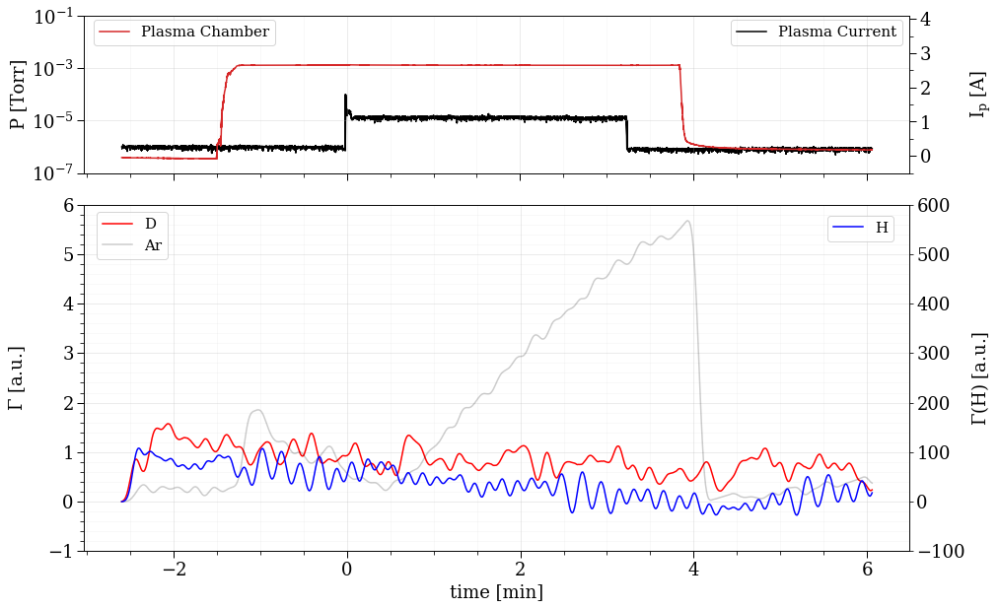

In [482]:
# range
fr = 7730
to = 8250
d_t = data_t[((data_t['time']>=fr) & (data_t['time']<=to))]
d = data[(data['time']>=fr) & (data['time']<=to)]
d_q = data_q[(data_q['time']>=fr) & (data_q['time']<=to)]

# convert
p2 = 10**(1.667*d['P2'] - 11.46) # 11.46 convert Pfeiffer signal to pressure
p1 = d['P1']*10**d['IGscale'] # convert linear IG signal to pressure

def iconv(v):
    return 5/1*(v-2.52)

ip = iconv(d['Ip'])-0.1

# plot
fig = gcf()
G = gridspec.GridSpec(3,1)
axs = [plt.subplot(G[0, 0]), plt.subplot(G[1:, 0])]

h = 10
w = 15
fig.set_size_inches(w,h)
dt = 60

""" plot pressure """
ax = axs[0]
# ax.plot(d['time']/dt - d['time'].iloc[0]/dt, p1, c='k', label='Permeation Chamber')
ax.plot(d['time']/dt - d['time'].iloc[0]/dt-2.6, p2, c='C3', label='Plasma Chamber')
# ax.plot(d['time']/dt, d['QMS_signal'])
ticks_visual(ax)
ax.set_yscale('log')
ax.set_ylim(1e-7, 1e-1)
# ax.set_yticks(np.logspace(-7, -1, 7), minor=False)
# ax.yaxis.set_major_locator(FixedLocator(np.logspace(-7, -1, 4)))
# ax.yaxis.set_minor_locator(FixedLocator([1e-7, 1e-5, 1e-3]))
ax.tick_params(labelbottom=False)
ax.legend(loc=1, bbox_to_anchor=[0.24, 1.02], fontsize=15)


""" plot plasma current """
ax2 = ax.twinx()
ax2.plot(d['time']/dt - d['time'].iloc[0]/dt-2.6 , ip,'k', label=r'Plasma Current')
ticks_visual(ax2)
ax2.set_ylim(-0.1, 4.1)
ax2.set_yticks(np.linspace(-0.5, 3.5, 9), minor=False)
ax2.yaxis.set_major_locator(MultipleLocator(1))
ax2.yaxis.set_minor_locator(MultipleLocator(0.5))
ax2.tick_params(labelbottom=False)

ax2.set_ylabel('$I_{p}$ [A]')
ax2.legend(loc=1, bbox_to_anchor=[1.0, 1.02], fontsize=15)

ax.set_zorder(2)
ax2.set_zorder(1)
ax.patch.set_alpha(0)

""" plot qms """
ax = axs[1]
ax2 = ax.twinx()
h2 = 2*(d_q['2']-d_q['2'].iloc[0]) + d_q['3']-d_q['3'].iloc[0] + 2*(d_q['18']-d_q['18'].iloc[0]) + d_q['19']-d_q['19'].iloc[0]
d2 = d_q['3']-d_q['3'].iloc[0] + 2*(d_q['4']-d_q['4'].iloc[0]) + d_q['19']-d_q['19'].iloc[0] + 2*(d_q['20']-d_q['20'].iloc[0])
ar = d_q['40']-d_q['40'].iloc[0]

h2/=1e-11
d2/=1e-11
ar/=1e-11

time = np.array(d_q['time']/dt - d_q['time'].iloc[0]/dt-2.6)
# h2 = np.array(h2)
# d2 = np.array(d2)
# ar = np.array(ar)

# ax2.plot(time[::10], h2[::10], linewidth=0, marker='.', label=r"H", c='gray', alpha=1)
# ax.plot(time[::10], d2[::10], linewidth=0, marker='.', label=r"D", c='r', alpha=1)
# ax.plot(time[::10], ar[::10], linewidth=0, marker='.', label=r"Ar", c='k', alpha=1)

# h2 = savitzky_golay(h2, 6, 1)
# d2 = savitzky_golay(d2, 10, 1)
# ar = savitzky_golay(ar, 6, 1)
fil = signal.firwin(numtaps=21, cutoff=50, fs=3000)
h2 = signal.lfilter(fil, 1, h2)
d2 = signal.lfilter(fil, 1, d2)
ar = signal.lfilter(fil, 1, ar)

ax2.plot(time, h2, label=r"H", c='b', alpha=1)
ax.plot(time, d2, label=r"D", c='r', alpha=1)
ax.plot(time, ar, label=r"Ar", c='k', alpha=0.2)
# ax.plot(d_q['time']/dt, d_q['analog_1'], c='C3', label='analog_1')
# ax.set_yscale('log')
ax.set_ylim(-1, 6)
ax2.set_ylim(-100, 600)
# ax.set_yticks(np.logspace(-13, -7, 7), minor=False)
# ax.yaxis.set_major_locator(FixedLocator(np.logspace(-13, -7, 7)))
ax.legend(loc=1, bbox_to_anchor=[0.11, 1], fontsize=15)
ax2.legend(loc=1, bbox_to_anchor=[0.99, 0.99], fontsize=15)
ticks_visual(ax)

[grid_visual(ax) for ax in axs]
fig.align_ylabels()

lbls = ['P [Torr]','$\Gamma$ [a.u.]']
[ax.set_ylabel(l) for l,ax in zip(lbls,axs)]
axs[-1].set_xlabel('time [min]')
#[ax.set_xlim(0,145) for ax in axs]
ax2.set_ylabel('$\Gamma(H)$ [a.u.]')

[ax.set_rasterized(True) for ax in axs]

title = 'argon_plasma_slide1'
# fig.savefig(join('./data/figure/{}.pdf'.format(title)),dpi = 300,bbox_inches='tight')
fig.savefig(join('./data/figure/{}.png'.format(title)),dpi = 300,bbox_inches='tight')

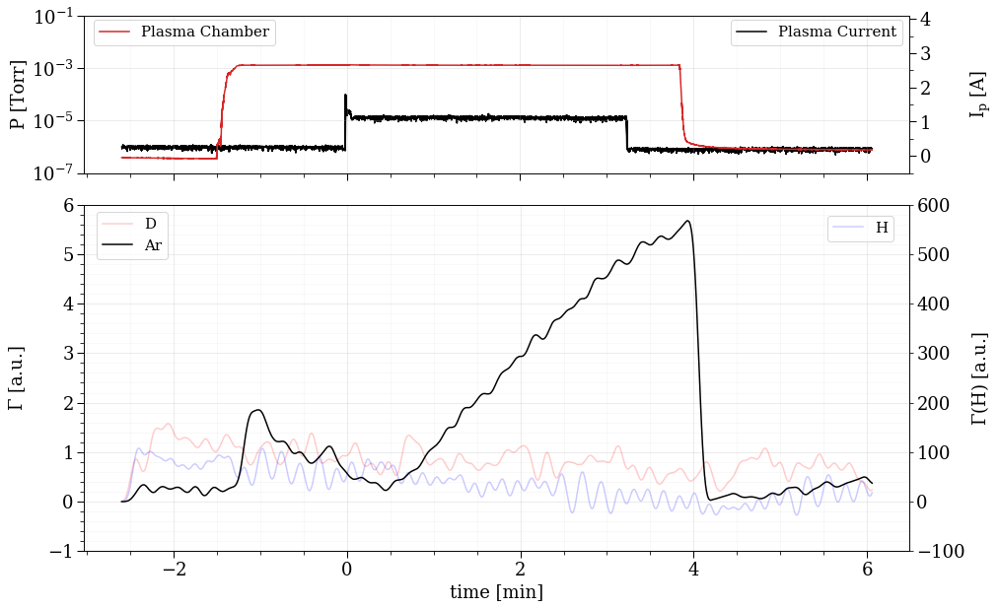

In [483]:
# range
fr = 7730
to = 8250
d_t = data_t[((data_t['time']>=fr) & (data_t['time']<=to))]
d = data[(data['time']>=fr) & (data['time']<=to)]
d_q = data_q[(data_q['time']>=fr) & (data_q['time']<=to)]

# convert
p2 = 10**(1.667*d['P2'] - 11.46) # 11.46 convert Pfeiffer signal to pressure
p1 = d['P1']*10**d['IGscale'] # convert linear IG signal to pressure

def iconv(v):
    return 5/1*(v-2.52)

ip = iconv(d['Ip'])-0.1

# plot
fig = gcf()
G = gridspec.GridSpec(3,1)
axs = [plt.subplot(G[0, 0]), plt.subplot(G[1:, 0])]

h = 10
w = 15
fig.set_size_inches(w,h)
dt = 60

""" plot pressure """
ax = axs[0]
# ax.plot(d['time']/dt - d['time'].iloc[0]/dt, p1, c='k', label='Permeation Chamber')
ax.plot(d['time']/dt - d['time'].iloc[0]/dt-2.6, p2, c='C3', label='Plasma Chamber')
# ax.plot(d['time']/dt, d['QMS_signal'])
ticks_visual(ax)
ax.set_yscale('log')
ax.set_ylim(1e-7, 1e-1)
# ax.set_yticks(np.logspace(-7, -1, 7), minor=False)
# ax.yaxis.set_major_locator(FixedLocator(np.logspace(-7, -1, 4)))
# ax.yaxis.set_minor_locator(FixedLocator([1e-7, 1e-5, 1e-3]))
ax.tick_params(labelbottom=False)
ax.legend(loc=1, bbox_to_anchor=[0.24, 1.02], fontsize=15)


""" plot plasma current """
ax2 = ax.twinx()
ax2.plot(d['time']/dt - d['time'].iloc[0]/dt-2.6 , ip,'k', label=r'Plasma Current')
ticks_visual(ax2)
ax2.set_ylim(-0.1, 4.1)
ax2.set_yticks(np.linspace(-0.5, 3.5, 9), minor=False)
ax2.yaxis.set_major_locator(MultipleLocator(1))
ax2.yaxis.set_minor_locator(MultipleLocator(0.5))
ax2.tick_params(labelbottom=False)

ax2.set_ylabel('$I_{p}$ [A]')
ax2.legend(loc=1, bbox_to_anchor=[1.0, 1.02], fontsize=15)

ax.set_zorder(2)
ax2.set_zorder(1)
ax.patch.set_alpha(0)

""" plot qms """
ax = axs[1]
ax2 = ax.twinx()
h2 = 2*(d_q['2']-d_q['2'].iloc[0]) + d_q['3']-d_q['3'].iloc[0] + 2*(d_q['18']-d_q['18'].iloc[0]) + d_q['19']-d_q['19'].iloc[0]
d2 = d_q['3']-d_q['3'].iloc[0] + 2*(d_q['4']-d_q['4'].iloc[0]) + d_q['19']-d_q['19'].iloc[0] + 2*(d_q['20']-d_q['20'].iloc[0])
ar = d_q['40']-d_q['40'].iloc[0]

h2/=1e-11
d2/=1e-11
ar/=1e-11

time = np.array(d_q['time']/dt - d_q['time'].iloc[0]/dt-2.6)
# h2 = np.array(h2)
# d2 = np.array(d2)
# ar = np.array(ar)

# ax2.plot(time[::10], h2[::10], linewidth=0, marker='.', label=r"H", c='gray', alpha=1)
# ax.plot(time[::10], d2[::10], linewidth=0, marker='.', label=r"D", c='r', alpha=1)
# ax.plot(time[::10], ar[::10], linewidth=0, marker='.', label=r"Ar", c='k', alpha=1)

# h2 = savitzky_golay(h2, 6, 1)
# d2 = savitzky_golay(d2, 10, 1)
# ar = savitzky_golay(ar, 6, 1)
fil = signal.firwin(numtaps=21, cutoff=50, fs=3000)
h2 = signal.lfilter(fil, 1, h2)
d2 = signal.lfilter(fil, 1, d2)
ar = signal.lfilter(fil, 1, ar)

ax2.plot(time, h2, label=r"H", c='b', alpha=0.2)
ax.plot(time, d2, label=r"D", c='r', alpha=0.2)
ax.plot(time, ar, label=r"Ar", c='k', alpha=1)
# ax.plot(d_q['time']/dt, d_q['analog_1'], c='C3', label='analog_1')
# ax.set_yscale('log')
ax.set_ylim(-1, 6)
ax2.set_ylim(-100, 600)
# ax.set_yticks(np.logspace(-13, -7, 7), minor=False)
# ax.yaxis.set_major_locator(FixedLocator(np.logspace(-13, -7, 7)))
ax.legend(loc=1, bbox_to_anchor=[0.11, 1], fontsize=15)
ax2.legend(loc=1, bbox_to_anchor=[0.99, 0.99], fontsize=15)
ticks_visual(ax)

[grid_visual(ax) for ax in axs]
fig.align_ylabels()

lbls = ['P [Torr]','$\Gamma$ [a.u.]']
[ax.set_ylabel(l) for l,ax in zip(lbls,axs)]
axs[-1].set_xlabel('time [min]')
#[ax.set_xlim(0,145) for ax in axs]
ax2.set_ylabel('$\Gamma(H)$ [a.u.]')

[ax.set_rasterized(True) for ax in axs]

title = 'argon_plasma_slide2'
# fig.savefig(join('./data/figure/{}.pdf'.format(title)),dpi = 300,bbox_inches='tight')
fig.savefig(join('./data/figure/{}.png'.format(title)),dpi = 300,bbox_inches='tight')

argon no plasma

        普通に, フィラメント, 330℃, h２
    


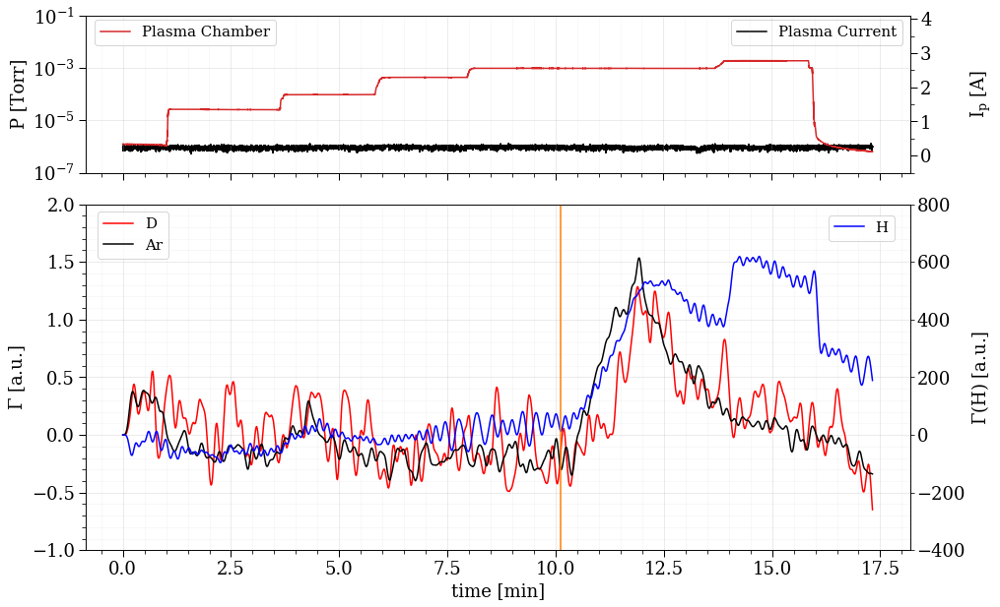

In [484]:
print('argon no plasma')
print(
    """
        普通に, フィラメント, 330℃, h２
    """
)
# range
fr = 6510
to = 7550
d_t = data_t[((data_t['time']>=fr) & (data_t['time']<=to))]
d = data[(data['time']>=fr) & (data['time']<=to)]
d_q = data_q[(data_q['time']>=fr) & (data_q['time']<=to)]

# convert
p2 = 10**(1.667*d['P2'] - 11.46) # 11.46 convert Pfeiffer signal to pressure
p1 = d['P1']*10**d['IGscale'] # convert linear IG signal to pressure

def iconv(v):
    return 5/1*(v-2.52)

ip = iconv(d['Ip'])-0.1

# plot
fig = gcf()
G = gridspec.GridSpec(3,1)
axs = [plt.subplot(G[0, 0]), plt.subplot(G[1:, 0])]

h = 10
w = 15
fig.set_size_inches(w,h)
dt = 60

""" plot pressure """
ax = axs[0]
# ax.plot(d['time']/dt - d['time'].iloc[0]/dt, p1, c='k', label='Permeation Chamber')
ax.plot(d['time']/dt - d['time'].iloc[0]/dt, p2, c='C3', label='Plasma Chamber')
# ax.plot(d['time']/dt, d['QMS_signal'])
ticks_visual(ax)
ax.set_yscale('log')
ax.set_ylim(1e-7, 1e-1)
# ax.set_yticks(np.logspace(-7, -1, 7), minor=False)
# ax.yaxis.set_major_locator(FixedLocator(np.logspace(-7, -1, 4)))
# ax.yaxis.set_minor_locator(FixedLocator([1e-7, 1e-5, 1e-3]))
ax.tick_params(labelbottom=False)
ax.legend(loc=1, bbox_to_anchor=[0.24, 1.02], fontsize=15)


""" plot plasma current """
ax2 = ax.twinx()
ax2.plot(d['time']/dt - d['time'].iloc[0]/dt, ip,'k', label=r'Plasma Current')
ticks_visual(ax2)
ax2.set_ylim(-0.1, 4.1)
ax2.set_yticks(np.linspace(-0.5, 3.5, 9), minor=False)
ax2.yaxis.set_major_locator(MultipleLocator(1))
ax2.yaxis.set_minor_locator(MultipleLocator(0.5))
ax2.tick_params(labelbottom=False)

ax2.set_ylabel('$I_{p}$ [A]')
ax2.legend(loc=1, bbox_to_anchor=[1.0, 1.02], fontsize=15)

ax.set_zorder(2)
ax2.set_zorder(1)
ax.patch.set_alpha(0)

""" plot qms """
ax = axs[1]
ax2 = ax.twinx()
h2 = 2*(d_q['2']-d_q['2'].iloc[0]) + d_q['3']-d_q['3'].iloc[0] + 2*(d_q['18']-d_q['18'].iloc[0]) + d_q['19']-d_q['19'].iloc[0]
d2 = d_q['3']-d_q['3'].iloc[0] + 2*(d_q['4']-d_q['4'].iloc[0]) + d_q['19']-d_q['19'].iloc[0] + 2*(d_q['20']-d_q['20'].iloc[0])
ar = d_q['40']-d_q['40'].iloc[0]

h2/=1e-11
d2/=1e-11
ar/=1e-11

time = np.array(d_q['time']/dt - d_q['time'].iloc[0]/dt)
# h2 = np.array(h2)
# d2 = np.array(d2)
# ar = np.array(ar)

# ax2.plot(time[::10], h2[::10], linewidth=0, marker='.', label=r"H", c='gray', alpha=1)
# ax.plot(time[::10], d2[::10], linewidth=0, marker='.', label=r"D", c='r', alpha=1)
# ax.plot(time[::10], ar[::10], linewidth=0, marker='.', label=r"Ar", c='k', alpha=1)

# h2 = savitzky_golay(h2, 6, 1)
# d2 = savitzky_golay(d2, 10, 1)
# ar = savitzky_golay(ar, 6, 1)
fil = signal.firwin(numtaps=21, cutoff=50, fs=3000)
h2 = signal.lfilter(fil, 1, h2)
d2 = signal.lfilter(fil, 1, d2)
ar = signal.lfilter(fil, 1, ar)

ax2.plot(time, h2, label=r"H", c='b', alpha=1)
ax.plot(time, d2, label=r"D", c='r', alpha=1)
ax.plot(time, ar, label=r"Ar", c='k', alpha=1)
# ax.plot(d_q['time']/dt, d_q['analog_1'], c='C3', label='analog_1')
# ax.set_yscale('log')
ax.set_ylim(-1, 2)
ax2.set_ylim(-400, 800)
# ax.set_yticks(np.logspace(-13, -7, 7), minor=False)
# ax.yaxis.set_major_locator(FixedLocator(np.logspace(-13, -7, 7)))
ax.legend(loc=1, bbox_to_anchor=[0.11, 1], fontsize=15)
ax2.legend(loc=1, bbox_to_anchor=[0.99, 0.99], fontsize=15)
ticks_visual(ax)

[grid_visual(ax) for ax in axs]
fig.align_ylabels()

lbls = ['P [Torr]','$\Gamma$ [a.u.]']
[ax.set_ylabel(l) for l,ax in zip(lbls,axs)]
axs[-1].set_xlabel('time [min]')
#[ax.set_xlim(0,145) for ax in axs]
ax2.set_ylabel('$\Gamma(H)$ [a.u.]')
# axs[1].axvspan(10.11, 16.4, color="yellow")
ax2.axvline(x=10.11, color='#ff7f00')


[ax.set_rasterized(True) for ax in axs]
# axs[1].axvspan(0, 5.84-2.6, color="yellow", alpha=0.6)

title = 'argon_no_plasma_slide'
# fig.savefig(join('./data/figure/{}.pdf'.format(title)),dpi = 300,bbox_inches='tight')
fig.savefig(join('./data/figure/{}.png'.format(title)),dpi = 300,bbox_inches='tight')

argon no plasma

        普通に, フィラメント, 330℃, h２
    


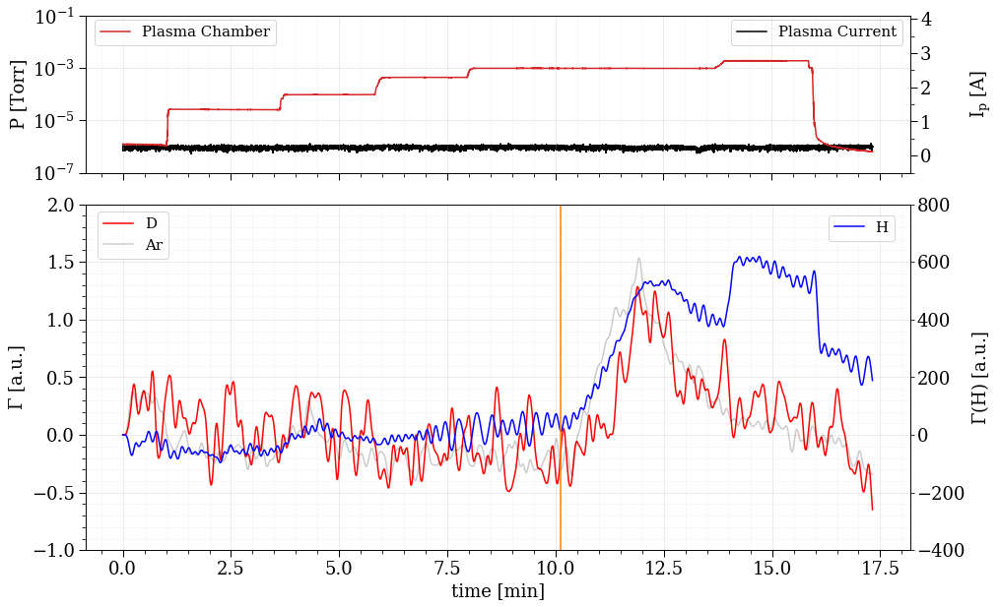

In [485]:
print('argon no plasma')
print(
    """
        普通に, フィラメント, 330℃, h２
    """
)
# range
fr = 6510
to = 7550
d_t = data_t[((data_t['time']>=fr) & (data_t['time']<=to))]
d = data[(data['time']>=fr) & (data['time']<=to)]
d_q = data_q[(data_q['time']>=fr) & (data_q['time']<=to)]

# convert
p2 = 10**(1.667*d['P2'] - 11.46) # 11.46 convert Pfeiffer signal to pressure
p1 = d['P1']*10**d['IGscale'] # convert linear IG signal to pressure

def iconv(v):
    return 5/1*(v-2.52)

ip = iconv(d['Ip'])-0.1

# plot
fig = gcf()
G = gridspec.GridSpec(3,1)
axs = [plt.subplot(G[0, 0]), plt.subplot(G[1:, 0])]

h = 10
w = 15
fig.set_size_inches(w,h)
dt = 60

""" plot pressure """
ax = axs[0]
# ax.plot(d['time']/dt - d['time'].iloc[0]/dt, p1, c='k', label='Permeation Chamber')
ax.plot(d['time']/dt - d['time'].iloc[0]/dt, p2, c='C3', label='Plasma Chamber')
# ax.plot(d['time']/dt, d['QMS_signal'])
ticks_visual(ax)
ax.set_yscale('log')
ax.set_ylim(1e-7, 1e-1)
# ax.set_yticks(np.logspace(-7, -1, 7), minor=False)
# ax.yaxis.set_major_locator(FixedLocator(np.logspace(-7, -1, 4)))
# ax.yaxis.set_minor_locator(FixedLocator([1e-7, 1e-5, 1e-3]))
ax.tick_params(labelbottom=False)
ax.legend(loc=1, bbox_to_anchor=[0.24, 1.02], fontsize=15)

""" plot plasma current """
ax2 = ax.twinx()
ax2.plot(d['time']/dt - d['time'].iloc[0]/dt, ip,'k', label=r'Plasma Current')
ticks_visual(ax2)
ax2.set_ylim(-0.1, 4.1)
ax2.set_yticks(np.linspace(-0.5, 3.5, 9), minor=False)
ax2.yaxis.set_major_locator(MultipleLocator(1))
ax2.yaxis.set_minor_locator(MultipleLocator(0.5))
ax2.tick_params(labelbottom=False)

ax2.set_ylabel('$I_{p}$ [A]')
ax2.legend(loc=1, bbox_to_anchor=[1.0, 1.02], fontsize=15)

ax.set_zorder(2)
ax2.set_zorder(1)
ax.patch.set_alpha(0)

""" plot qms """
ax = axs[1]
ax2 = ax.twinx()
h2 = 2*(d_q['2']-d_q['2'].iloc[0]) + d_q['3']-d_q['3'].iloc[0] + 2*(d_q['18']-d_q['18'].iloc[0]) + d_q['19']-d_q['19'].iloc[0]
d2 = d_q['3']-d_q['3'].iloc[0] + 2*(d_q['4']-d_q['4'].iloc[0]) + d_q['19']-d_q['19'].iloc[0] + 2*(d_q['20']-d_q['20'].iloc[0])
ar = d_q['40']-d_q['40'].iloc[0]

h2/=1e-11
d2/=1e-11
ar/=1e-11

time = np.array(d_q['time']/dt - d_q['time'].iloc[0]/dt)
# h2 = np.array(h2)
# d2 = np.array(d2)
# ar = np.array(ar)

# ax2.plot(time[::10], h2[::10], linewidth=0, marker='.', label=r"H", c='gray', alpha=1)
# ax.plot(time[::10], d2[::10], linewidth=0, marker='.', label=r"D", c='r', alpha=1)
# ax.plot(time[::10], ar[::10], linewidth=0, marker='.', label=r"Ar", c='k', alpha=1)

# h2 = savitzky_golay(h2, 6, 1)
# d2 = savitzky_golay(d2, 10, 1)
# ar = savitzky_golay(ar, 6, 1)
fil = signal.firwin(numtaps=21, cutoff=50, fs=3000)
h2 = signal.lfilter(fil, 1, h2)
d2 = signal.lfilter(fil, 1, d2)
ar = signal.lfilter(fil, 1, ar)

ax2.plot(time, h2, label=r"H", c='b', alpha=1)
ax.plot(time, d2, label=r"D", c='r', alpha=1)
ax.plot(time, ar, label=r"Ar", c='k', alpha=0.2)
# ax.plot(d_q['time']/dt, d_q['analog_1'], c='C3', label='analog_1')
# ax.set_yscale('log')
ax.set_ylim(-1, 2)
ax2.set_ylim(-400, 800)
# ax.set_yticks(np.logspace(-13, -7, 7), minor=False)
# ax.yaxis.set_major_locator(FixedLocator(np.logspace(-13, -7, 7)))
ax.legend(loc=1, bbox_to_anchor=[0.11, 1], fontsize=15)
ax2.legend(loc=1, bbox_to_anchor=[0.99, 0.99], fontsize=15)
ticks_visual(ax)

[grid_visual(ax) for ax in axs]
fig.align_ylabels()

lbls = ['P [Torr]','$\Gamma$ [a.u.]']
[ax.set_ylabel(l) for l,ax in zip(lbls,axs)]
axs[-1].set_xlabel('time [min]')
#[ax.set_xlim(0,145) for ax in axs]
ax2.set_ylabel('$\Gamma(H)$ [a.u.]')
# axs[1].axvspan(10.11, 16.4, color="yellow")
ax2.axvline(x=10.11, color='#ff7f00')


[ax.set_rasterized(True) for ax in axs]
# axs[1].axvspan(0, 5.84-2.6, color="yellow", alpha=0.6)

title = 'argon_no_plasma_slide1'
# fig.savefig(join('./data/figure/{}.pdf'.format(title)),dpi = 300,bbox_inches='tight')
fig.savefig(join('./data/figure/{}.png'.format(title)),dpi = 300,bbox_inches='tight')

argon no plasma

        普通に, フィラメント, 330℃, h２
    


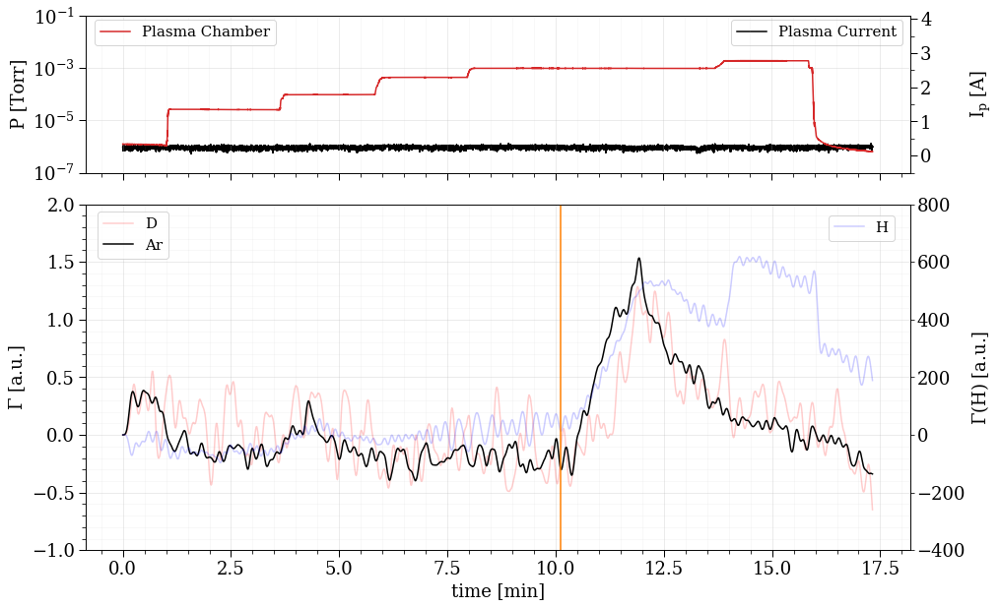

In [486]:
print('argon no plasma')
print(
    """
        普通に, フィラメント, 330℃, h２
    """
)
# range
fr = 6510
to = 7550
d_t = data_t[((data_t['time']>=fr) & (data_t['time']<=to))]
d = data[(data['time']>=fr) & (data['time']<=to)]
d_q = data_q[(data_q['time']>=fr) & (data_q['time']<=to)]

# convert
p2 = 10**(1.667*d['P2'] - 11.46) # 11.46 convert Pfeiffer signal to pressure
p1 = d['P1']*10**d['IGscale'] # convert linear IG signal to pressure

def iconv(v):
    return 5/1*(v-2.52)

ip = iconv(d['Ip'])-0.1

# plot
fig = gcf()
G = gridspec.GridSpec(3,1)
axs = [plt.subplot(G[0, 0]), plt.subplot(G[1:, 0])]

h = 10
w = 15
fig.set_size_inches(w,h)
dt = 60

""" plot pressure """
ax = axs[0]
# ax.plot(d['time']/dt - d['time'].iloc[0]/dt, p1, c='k', label='Permeation Chamber')
ax.plot(d['time']/dt - d['time'].iloc[0]/dt, p2, c='C3', label='Plasma Chamber')
# ax.plot(d['time']/dt, d['QMS_signal'])
ticks_visual(ax)
ax.set_yscale('log')
ax.set_ylim(1e-7, 1e-1)
# ax.set_yticks(np.logspace(-7, -1, 7), minor=False)
# ax.yaxis.set_major_locator(FixedLocator(np.logspace(-7, -1, 4)))
# ax.yaxis.set_minor_locator(FixedLocator([1e-7, 1e-5, 1e-3]))
ax.tick_params(labelbottom=False)
ax.legend(loc=1, bbox_to_anchor=[0.24, 1.02], fontsize=15)

""" plot plasma current """
ax2 = ax.twinx()
ax2.plot(d['time']/dt - d['time'].iloc[0]/dt, ip,'k', label=r'Plasma Current')
ticks_visual(ax2)
ax2.set_ylim(-0.1, 4.1)
ax2.set_yticks(np.linspace(-0.5, 3.5, 9), minor=False)
ax2.yaxis.set_major_locator(MultipleLocator(1))
ax2.yaxis.set_minor_locator(MultipleLocator(0.5))
ax2.tick_params(labelbottom=False)

ax2.set_ylabel('$I_{p}$ [A]')
ax2.legend(loc=1, bbox_to_anchor=[1.0, 1.02], fontsize=15)

ax.set_zorder(2)
ax2.set_zorder(1)
ax.patch.set_alpha(0)

""" plot qms """
ax = axs[1]
ax2 = ax.twinx()
h2 = 2*(d_q['2']-d_q['2'].iloc[0]) + d_q['3']-d_q['3'].iloc[0] + 2*(d_q['18']-d_q['18'].iloc[0]) + d_q['19']-d_q['19'].iloc[0]
d2 = d_q['3']-d_q['3'].iloc[0] + 2*(d_q['4']-d_q['4'].iloc[0]) + d_q['19']-d_q['19'].iloc[0] + 2*(d_q['20']-d_q['20'].iloc[0])
ar = d_q['40']-d_q['40'].iloc[0]

h2/=1e-11
d2/=1e-11
ar/=1e-11

time = np.array(d_q['time']/dt - d_q['time'].iloc[0]/dt)
# h2 = np.array(h2)
# d2 = np.array(d2)
# ar = np.array(ar)

# ax2.plot(time[::10], h2[::10], linewidth=0, marker='.', label=r"H", c='gray', alpha=1)
# ax.plot(time[::10], d2[::10], linewidth=0, marker='.', label=r"D", c='r', alpha=1)
# ax.plot(time[::10], ar[::10], linewidth=0, marker='.', label=r"Ar", c='k', alpha=1)

# h2 = savitzky_golay(h2, 6, 1)
# d2 = savitzky_golay(d2, 10, 1)
# ar = savitzky_golay(ar, 6, 1)
fil = signal.firwin(numtaps=21, cutoff=50, fs=3000)
h2 = signal.lfilter(fil, 1, h2)
d2 = signal.lfilter(fil, 1, d2)
ar = signal.lfilter(fil, 1, ar)

ax2.plot(time, h2, label=r"H", c='b', alpha=0.2)
ax.plot(time, d2, label=r"D", c='r', alpha=0.2)
ax.plot(time, ar, label=r"Ar", c='k', alpha=1)
# ax.plot(d_q['time']/dt, d_q['analog_1'], c='C3', label='analog_1')
# ax.set_yscale('log')
ax.set_ylim(-1, 2)
ax2.set_ylim(-400, 800)
# ax.set_yticks(np.logspace(-13, -7, 7), minor=False)
# ax.yaxis.set_major_locator(FixedLocator(np.logspace(-13, -7, 7)))
ax.legend(loc=1, bbox_to_anchor=[0.11, 1], fontsize=15)
ax2.legend(loc=1, bbox_to_anchor=[0.99, 0.99], fontsize=15)
ticks_visual(ax)

[grid_visual(ax) for ax in axs]
fig.align_ylabels()

lbls = ['P [Torr]','$\Gamma$ [a.u.]']
[ax.set_ylabel(l) for l,ax in zip(lbls,axs)]
axs[-1].set_xlabel('time [min]')
#[ax.set_xlim(0,145) for ax in axs]
ax2.set_ylabel('$\Gamma(H)$ [a.u.]')
# axs[1].axvspan(10.11, 16.4, color="yellow")
ax2.axvline(x=10.11, color='#ff7f00')


[ax.set_rasterized(True) for ax in axs]
# axs[1].axvspan(0, 5.84-2.6, color="yellow", alpha=0.6)

title = 'argon_no_plasma_slide2'
# fig.savefig(join('./data/figure/{}.pdf'.format(title)),dpi = 300,bbox_inches='tight')
fig.savefig(join('./data/figure/{}.png'.format(title)),dpi = 300,bbox_inches='tight')

QMS slide
<ipython-input-512-c63670cb92fc>:53: UserWarning: AutoMinorLocator does not work with logarithmic scale
  fig.savefig(join('./data/figure/{}.png'.format(title)),dpi = 300,bbox_inches='tight')


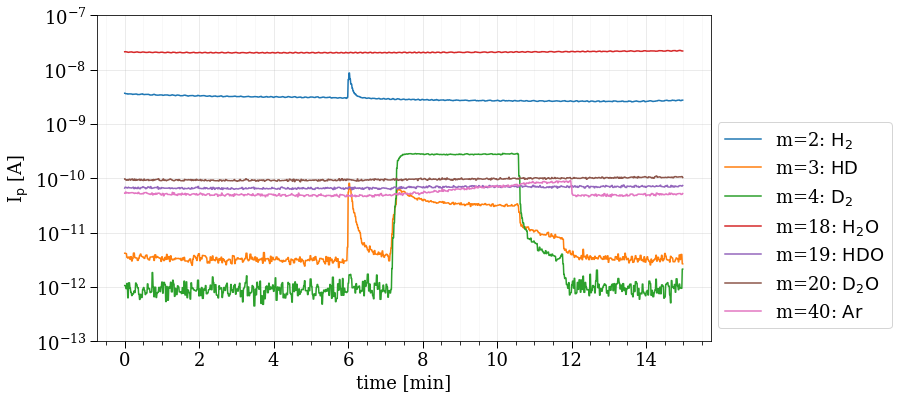

In [512]:
print('QMS slide')
# range
fr = 300
to = 1200
d_t = data_t[((data_t['time']>=fr) & (data_t['time']<=to))]
d = data[(data['time']>=fr) & (data['time']<=to)]
d_q = data_q[(data_q['time']>=fr) & (data_q['time']<=to)]

# convert
p2 = 10**(1.667*d['P2'] - 11.46) # 11.46 convert Pfeiffer signal to pressure
p1 = d['P1']*10**d['IGscale'] # convert linear IG signal to pressure

def iconv(v):
    return 5/1*(v-2.52)

ip = iconv(d['Ip'])-0.1

# plot
fig = gcf()
ax = gca()
h = 6
w = 11
fig.set_size_inches(w,h)
dt = 60

""" plot qms """
ax.plot(d_q['time']/dt - d_q['time'].iloc[0]/dt, d_q['2'], label=r'm=2: $\rm H_2$')
ax.plot(d_q['time']/dt - d_q['time'].iloc[0]/dt, d_q['3'], label=r'm=3: $\rm HD$')
ax.plot(d_q['time']/dt - d_q['time'].iloc[0]/dt, d_q['4'], label=r'm=4: $\rm D_2$')
ax.plot(d_q['time']/dt - d_q['time'].iloc[0]/dt, d_q['18'], label=r'm=18: $\rm H_2O$')
ax.plot(d_q['time']/dt - d_q['time'].iloc[0]/dt, d_q['19'], label=r'm=19: $\rm HDO$')
ax.plot(d_q['time']/dt - d_q['time'].iloc[0]/dt, d_q['20'], label=r'm=20: $\rm D_2O$')
ax.plot(d_q['time']/dt - d_q['time'].iloc[0]/dt, d_q['40'], label=r'm=40: $\rm Ar$')

ax.set_yscale('log')
ax.set_ylim(1e-13, 1e-7)
ax.set_yticks(np.logspace(-13, -7, 7), minor=False)
ax.yaxis.set_major_locator(FixedLocator(np.logspace(-13, -7, 7)))
# ax.legend(loc=1, bbox_to_anchor=[1.125, 0.38], fontsize=15)
ax.legend(loc=1, bbox_to_anchor=[1.31, 0.7], fontsize=18)
ticks_visual(ax)

grid_visual(ax)
fig.align_ylabels()

ax.set_xlabel('time [min]')
ax.set_ylabel(r'$I_{\rm p}$ [A]')

ax.set_rasterized(True)

title = 'qms_slide'
# fig.savefig(join('./data/figure/{}.pdf'.format(title)),dpi = 300,bbox_inches='tight')
fig.savefig(join('./data/figure/{}.png'.format(title)),dpi = 300,bbox_inches='tight')